Check first if a GPU is installed

In [ ]:
!nvidia-smi

Sun Nov 17 03:16:57 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   53C    P8              12W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


Install `condacolab` first to make use of an Anaconda environment

In [ ]:
!pip install -q condacolab
import condacolab
condacolab.install()

✨🍰✨ Everything looks OK!


In [ ]:
!pip install -q virtualenv

In [ ]:
!virtualenv /content/drive/Shareddrives/thesis/violence-detection/virtual_env


created virtual environment CPython3.10.13.final.0-64 in 12387ms
  creator CPython3Posix(dest=/content/drive/Shareddrives/thesis/violence-detection/virtual_env, clear=False, no_vcs_ignore=False, global=False)
  seeder FromAppData(download=False, pip=bundle, setuptools=bundle, wheel=bundle, via=copy, app_data_dir=/root/.local/share/virtualenv)
    added seed packages: Cython==3.0.11, MarkupSafe==3.0.1, PyYAML==6.0.2, filelock==3.16.1, fsspec==2024.9.0, jinja2==3.1.4, mpmath==1.3.0, networkx==3.4.1, numpy==2.1.2, nvidia_cublas_cu12==12.1.3.1, nvidia_cuda_cupti_cu12==12.1.105, nvidia_cuda_nvrtc_cu12==12.1.105, nvidia_cuda_runtime_cu12==12.1.105, nvidia_cudnn_cu12==9.1.0.70, nvidia_cufft_cu12==11.0.2.54, nvidia_curand_cu12==10.3.2.106, nvidia_cusolver_cu12==11.4.5.107, nvidia_cusparse_cu12==12.1.0.106, nvidia_nccl_cu12==2.20.5, nvidia_nvjitlink_cu12==12.6.77, nvidia_nvtx_cu12==12.1.105, pillow==10.4.0, pip==24.3.1, setuptools==75.2.0, sympy==1.13.3, torch==2.4.1, torchvision==0.19.1, trito

In [ ]:
!source /content/drive/Shareddrives/thesis/violence-detection/virtual_env/bin/activate
# !pip install --target /content/drive/Shareddrives/thesis/violence-detection/virtual_env/lib/python3.10/site-packages/ cython pyyaml torch torchvision

In [ ]:
%cd /content/drive/Shareddrives/thesis/violence-detection/virtual_env/lib/python3.10/site-packages/

/content/drive/Shareddrives/thesis/violence-detection/virtual_env/lib/python3.10/site-packages


In [ ]:
%ls

bin/                                          nvidia_nvjitlink_cu12-12.6.77.dist-info/
Cython/                                       nvidia_nvtx_cu12-12.1.105.dist-info/
Cython-3.0.11.dist-info/                      PIL/
cython.py                                     pillow-10.4.0.dist-info/
detectron2/                                   pillow.libs/
_distutils_hack/                              pip/
distutils-precedence.pth                      pip-24.3.1.dist-info/
filelock/                                     pip-24.3.1.virtualenv
filelock-3.16.1.dist-info/                    pkg_resources/
fsspec/                                       __pycache__/
fsspec-2024.9.0.dist-info/                    pyximport/
functorch/                                    PyYAML-6.0.2.dist-info/
isympy.py                                     setuptools/
jinja2/                                       setuptools-75.2.0.dist-info/
jinja2-3.1.4.dist-info/                       setuptools-75.2.0.virtualenv
markups

In [ ]:
!pip install torch
!pip install torchvision
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 906.4/906.4 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 103.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 84.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.7/188.7 MB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 93.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
!git clone https://github.com/facebookresearch/detectron2.git

fatal: destination path 'detectron2' already exists and is not an empty directory.


In [ ]:
!pip install detectron2

ERROR: Could not find a version that satisfies the requirement detectron2 (from versions: none)
ERROR: No matching distribution found for detectron2


In [ ]:
!pip install git+https://github.com/facebookresearch/detectron2@main#subdirectory=projects/DensePose


  Cloning https://github.com/facebookresearch/detectron2 (to revision main) to /tmp/pip-req-build-w_rjk9lo
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2 /tmp/pip-req-build-w_rjk9lo
  Resolved https://github.com/facebookresearch/detectron2 to commit 8d85329aed8506ea3672e3e208971345973ea761
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-install-2rf5h8ul/detectron2_ee866ff584554801b62413bf2c53c327
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-install-2rf5h8ul/detectron2_ee866ff584554801b62413bf2c53c327
  Resolved https://github.com/facebookresearch/detectron2.git to commit 8d85329aed8506ea3672e3e208971345973ea761
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 4.1 MB/s e

In [ ]:
%cd detectron2
%cd projects
%cd DensePose

/content/drive/Shareddrives/thesis/violence-detection/virtual_env/lib/python3.10/site-packages/detectron2
/content/drive/Shareddrives/thesis/violence-detection/virtual_env/lib/python3.10/site-packages/detectron2/projects
/content/drive/Shareddrives/thesis/violence-detection/virtual_env/lib/python3.10/site-packages/detectron2/projects/DensePose


In [ ]:
!python apply_net.py show configs/densepose_rcnn_R_50_FPN_s1x.yaml \
https://dl.fbaipublicfiles.com/densepose/densepose_rcnn_R_50_FPN_s1x/165712039/model_final_162be9.pkl \
image.jpeg bbox,dp_segm -v --output output.jpg

^C


## UCF Dataset Split

In [ ]:
!apt install ffmpeg

In [ ]:
import os

folder = '/content/drive/Shareddrives/thesis/dataset/'

directories = [dir for dir in os.listdir(folder) if os.path.isdir(os.path.join(folder, dir)) and dir.startswith('Anomaly')]
categories = ['Shoplifting']#, 'Robbery', 'Stealing']

for dir in directories:
  path = os.path.join(folder, dir)
  split_path = os.path.join(folder, 'split')
  subdirectories = [subdir for subdir in os.listdir(path) if os.path.isdir(os.path.join(path, subdir))]
  for subdir in subdirectories:
    if subdir in categories:
      for file in os.listdir(os.path.join(path, subdir)):
        cmd = f"mkdir -p {os.path.join(split_path, subdir, file)}"
        !{cmd}
        os.chdir(os.path.join(split_path, subdir, file))
        f_length = float(os.popen(f"ffprobe -v error -show_entries format=duration -of default=noprint_wrappers=1:nokey=1 {os.path.join(path, subdir, file)}").read())
        length = int(f_length // 1) + (f_length % 1 > 0)
        for number, start in enumerate(range(0, length, 4)):
          start_min = start // 60
          start_sec = start % 60
          cmd = f"ffmpeg -y -ss 00:{start_min:02}:{start_sec:02} -i {os.path.join(path, subdir, file)} -t 4 -c:v libx264 -c:a copy {file.removesuffix('.mp4')}_{number}.mp4"
          !{cmd}


Streaming output truncated to the last 5000 lines.
      handler_name    : SoundHandler
      vendor_id       : [0][0][0][0]
frame=  120 fps=0.0 q=-1.0 Lsize=      75kB time=00:00:03.99 bitrate= 153.5kbits/s speed=8.28x    
video:67kB audio:3kB subtitle:0kB other streams:0kB global headers:0kB muxing overhead: 7.134675%
[libx264 @ 0x59ecf61e2a40] frame I:1     Avg QP:20.86  size: 12316
[libx264 @ 0x59ecf61e2a40] frame P:43    Avg QP:21.83  size:  1131
[libx264 @ 0x59ecf61e2a40] frame B:76    Avg QP:16.40  size:    95
[libx264 @ 0x59ecf61e2a40] consecutive B-frames:  0.8% 43.3%  2.5% 53.3%
[libx264 @ 0x59ecf61e2a40] mb I  I16..4: 10.3% 34.0% 55.7%
[libx264 @ 0x59ecf61e2a40] mb P  I16..4:  0.0%  0.4%  0.3%  P16..4: 12.6% 10.7% 10.0%  0.0%  0.0%    skip:65.9%
[libx264 @ 0x59ecf61e2a40] mb B  I16..4:  0.0%  0.0%  0.0%  B16..8: 10.9%  0.9%  0.4%  direct: 0.3%  skip:87.6%  L0:13.0% L1:80.8% BI: 6.1%
[libx264 @ 0x59ecf61e2a40] 8x8 transform intra:39.5% inter:45.1%
[libx264 @ 0x59ecf61e2a40] c

###YOLO

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 896.9/896.9 kB 16.2 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
%cd /content/drive/Shareddrives/thesis/test
%mkdir predict

/content/drive/Shareddrives/thesis/test


In [ ]:
model = YOLO('yolo11m-pose.pt') #medium model

path = "/content/drive/Shareddrives/thesis/dataset/Anomaly-Videos-Part-4/Shoplifting/Shoplifting008_x264.mp4"
save_path = "/content/drive/Shareddrives/thesis/test/predict"
results = model.predict(source=path, stream=True)  # predict on an image

file = path.split('/')[-1]
%cd /content/drive/Shareddrives/thesis/test/predict
%mkdir -p $file/frames
%cd $file/frames

i = 0
for result in results:
  result.save(f"frame_{i}.jpg")
  i += 1

AttributeError: 'generator' object has no attribute 'save'

In [ ]:
!apt install ffmpeg

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 49 not upgraded.


In [ ]:
import os

file = "Shoplifting008_x264.mp4"

pred_folder = "/content/drive/Shareddrives/thesis/test/predict"
image_folder = os.path.join(pred_folder, file, 'frames')

%cd $pred_folder
%cd $file

video_name = f"{file.removesuffix('.mp4')}+poses.mp4"
cmd = f"ffmpeg -framerate 30 -i {image_folder}/frame_%d.jpg {video_name}"
!{cmd}

#alt with ffmpeg
# image_files = [os.path.join(image_folder, f"frame_{i}.jpg") for i in range(len(os.listdir(image_folder)))]
# cmd = f"ffmpeg -framerate 30 -i concat:{';'.join(image_files)} -c copy {video_name}"
# !{cmd}

#using opencv
# import cv2

# images = [img for img in os.listdir(image_folder) if img.endswith(".jpg")]
# images.sort(key= lambda x: int(x.removesuffix('.jpg').removeprefix('frame_')))

# frame = cv2.imread(os.path.join(image_folder, images[0]))
# height, width, layers = frame.shape

# video = cv2.VideoWriter(video_name, 0, 30, (width,height))

# for image in images:
#     video.write(cv2.imread(os.path.join(image_folder, image)))

# cv2.destroyAllWindows()
# video.release()

/content/drive/Shareddrives/thesis/test/predict
/content/drive/Shareddrives/thesis/test/predict/Shoplifting008_x264.mp4
ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-lib

In [ ]:
# from google.colab import files

# !zip -r /content/video-sample.zip /content/yolo-out/video-sample

# files.download("/content/video-sample.zip")

  adding: content/yolo-out/video-sample/ (stored 0%)
  adding: content/yolo-out/video-sample/frame_3005.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_1857.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_1894.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_672.jpg (deflated 3%)
  adding: content/yolo-out/video-sample/frame_1752.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_2334.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_3028.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_3081.jpg (deflated 3%)
  adding: content/yolo-out/video-sample/frame_119.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_2197.jpg (deflated 3%)
  adding: content/yolo-out/video-sample/frame_2823.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_2871.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_597.jpg (deflated 2%)
  adding: content/yolo-out/video-sample/frame_2973.jp

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

###OpenPose


In [ ]:
! nvcc --version
! nvidia-smi

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
Sun Nov 17 04:13:32 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   63C    P8              12W /  7

In [ ]:
!rm -rf /content/OpenPose

In [ ]:
import os, sys
from google.colab import files, drive

def connect_to_Gdrive():
  print("Connecting to Google Drive...")
  # Add GDrive notebooks to colab
  drive.mount('/content/drive', force_remount=True)
  if not os.path.exists(openpose_path):
    !mkdir -p '/content/drive/Shareddrives/thesis/OpenPose'
  else:
    print(f"{openpose_path} already exists.")
    !cp -r $openpose_path '/content/drive/Shareddrives/thesis'
    !rm -r $openpose_path
  os.symlink('/content/drive/Shareddrives/thesis/OpenPose', openpose_path)
  sys.path.insert(0, openpose_path)

def install_openpose_func():
  print("Installing OpenPose in Google Drive...")
  git_repo_url = 'https://github.com/CMU-Perceptual-Computing-Lab/openpose.git'
  if not os.path.exists(installation_path):
    !mkdir -p $installation_path
    # install new CMake because of CUDA10
    !wget -q https://cmake.org/files/v3.13/cmake-3.13.0-Linux-x86_64.tar.gz
    !tar xfz cmake-3.13.0-Linux-x86_64.tar.gz --strip-components=1 -C /usr/local
    !git clone $git_repo_url
    !sed -i 's/execute_process(COMMAND git checkout master WORKING_DIRECTORY ${CMAKE_SOURCE_DIR}\/3rdparty\/caffe)/execute_process(COMMAND git checkout f019d0dfe86f49d1140961f8c7dec22130c83154 WORKING_DIRECTORY ${CMAKE_SOURCE_DIR}\/3rdparty\/caffe)/g' openpose/CMakeLists.txt
    # install system dependencies
    !apt-get -qq install -y libatlas-base-dev libprotobuf-dev libleveldb-dev libsnappy-dev libhdf5-serial-dev protobuf-compiler libgflags-dev libgoogle-glog-dev liblmdb-dev opencl-headers ocl-icd-opencl-dev libviennacl-dev
    # build openpose # doing it twice seems to solve the issue
    !cd openpose && rm -rf build || true && mkdir build && cd build && cmake .. && make -j`nproc`
    !cd openpose && rm -rf build || true && mkdir build && cd build && cmake .. && make -j`nproc`
    # Install body_25b model # caffe model not available anymore -> revert to BODY_25 as default
    !wget posefs1.perception.cs.cmu.edu/OpenPose/models/pose/1_25BBkg/body_25b/pose_iter_XXXXXX.caffemodel -P /content/openpose/models/pose/body_25b
    !wget https://raw.githubusercontent.com/CMU-Perceptual-Computing-Lab/openpose_train/master/experimental_models/1_25BBkg/body_25b/pose_deploy.prototxt -P /content/openpose/models/pose/body_25b
    # Get compatible CUDA and CuDNN versions in order to avoid `CudaSuccess (2 vs. 0) out of memory` error
    !apt-get install -y --allow-change-held-packages cuda-toolkit-11-0 libcudnn8=8.0.5.39-1+cuda11.0
    # Move openpose folder to GDrive
    !mv /content/openpose/* $installation_path && rm -r /content/openpose
    !rm -rf /content/openpose
    !chmod 755 $installation_path/build/examples/openpose/openpose.bin
    # Copy libraries in system path
    !cp $installation_path/build/src/openpose/libopenpose.so.1.7.0 /usr/local/lib
    !cp $installation_path/build/caffe/lib/libcaffe.so.1.0.0 /usr/local/lib
    !sudo ldconfig
    # Dirty way of installing body_25 while the openpose server is down
    !pip install gdown
    !gdown 1jehFU9xsxEpxRuOEUgA5jaCutR4l9X8a
    !mv pose_iter_584000.caffemodel $installation_path/models/pose/body_25/pose_iter_584000.caffemodel
    !pip install ultralytics
  else:
    print("OpenPose already installed.")
    print("Setting up the environment...")
    # Allow execution of OpenPose
    !chmod 755 $installation_path/build/examples/openpose/openpose.bin
    # Install system dependencies
    !apt-get -qq install -y libatlas-base-dev libprotobuf-dev libleveldb-dev libsnappy-dev libhdf5-serial-dev protobuf-compiler libgflags-dev libgoogle-glog-dev liblmdb-dev opencl-headers ocl-icd-opencl-dev libviennacl-dev &> /dev/null
    # Get compatible CUDA and CuDNN versions in order to avoid `CudaSuccess (2 vs. 0) out of memory` error
    !apt-get install -y --allow-change-held-packages cuda-toolkit-11-0 libcudnn8=8.0.5.39-1+cuda11.0 &> /dev/null
    # Copy libraries in system path
    !cp $installation_path/build/src/openpose/libopenpose.so.1.7.0 /usr/local/lib
    !cp $installation_path/build/caffe/lib/libcaffe.so.1.0.0 /usr/local/lib
    !sudo ldconfig
    !pip install ultralytics

openpose_path = '/content/OpenPose'
installation_path = os.path.join(openpose_path,'OpenPose_installation')

# Use the right Python version
!sudo update-alternatives --install /usr/bin/python3 python3 /usr/bin/python3.10 1
# GDrive tools
!apt-get -qq install xattr &> /dev/null

connect_to_Gdrive()
install_openpose_func()

print("Done.")

update-alternatives: using /usr/bin/python3.10 to provide /usr/bin/python3 (python3) in auto mode
Connecting to Google Drive...
Mounted at /content/drive
Installing OpenPose in Google Drive...
OpenPose already installed.
Setting up the environment...
/sbin/ldconfig.real: /usr/local/lib/libur_loader.so.0 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtcm_debug.so.1 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind_2_5.so.3 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbmalloc_proxy.so.2 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libur_adapter_opencl.so.0 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind_2_0.so.3 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbbbind.so.3 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtbb.so.12 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libtcm.so.1 is not a symbolic link

/sbin/ldconfig.real: /usr/local/lib/libur_

In [ ]:
! nvcc --version
! nvidia-smi

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0
Fri Nov 29 17:34:56 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   43C    P8              11W /  7

In [ ]:
from ultralytics import YOLO
import subprocess

def runOpenPose(src, dst):
    openpose_path = "OpenPose/OpenPose_installation/build/examples/openpose/openpose.bin"
    if not os.path.exists(openpose_path):
        raise FileNotFoundError(f"OpenPose binary not found at {openpose_path}")

    if not os.path.exists(src):
        raise FileNotFoundError(f"Source video file not found: {src}")

    os.makedirs(os.path.dirname(dst), exist_ok=True)

    command = [
        openpose_path,
        "--video", src,
        "--display", "0",
        "--write_video", dst,
        "--logging_level", "3"
    ]

    try:
        subprocess.run(command, check=True)
        print(f"Pose estimation completed successfully. Output saved to {dst}.")
    except subprocess.CalledProcessError as e:
        print(f"Error while running OpenPose: {e}")
  # !cd OpenPose/OpenPose_installation/ && ./build/examples/openpose/openpose.bin --video $src --display 0  --write_video $dst

def runYOLO(src, dst):
  path_to_pose_vid = os.path.join(dst, f"{src.split('/')[-1].removesuffix('.mp4')}+poses.mp4")
  # if os.path.exists(path_to_pose_vid):
  #   print(f"YOLO has been run on {src}")
  #   return

  path_to_keypoints = os.path.join(dst, "keypoints")
  if os.path.exists(path_to_keypoints):
    print(f"YOLO has been run on {src}")
    return

  model = YOLO('yolo11m-pose.pt')
  results = model(src, stream=True)  # predict on an image
  frames_folder = os.path.join(dst, "frames")
  keypoints_folder = os.path.join(dst, "keypoints")
  os.chdir(dst)
  # !mkdir -p frames
  !mkdir -p keypoints

  # Save every frame to a folder
  i = 0
  for result in results:
    # os.chdir(frames_folder) # currently in ../{clip}/frames
    # result.save(f"frame_{i}.jpg")
    os.chdir(keypoints_folder) # currently in ../{clip}/keypoints
    result.save_txt(f"frame_{i}.json")
    i += 1

  # os.chdir(dst)
  # clip = src.split('/')[-1]
  # video_name = f"{clip.removesuffix('.mp4')}+poses.mp4"
  # cmd = f"ffmpeg -framerate 30 -i {frames_folder}/frame_%d.jpg {video_name}"
  # !{cmd}

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
import math

dataset_path = '/content/drive/Shareddrives/thesis/dataset/split/Shoplifting'
all_videos = os.listdir(dataset_path)
batch_size = 5  # Number of videos per batch

num_batches = math.ceil(len(all_videos) / batch_size)

batches = []
for i in range(num_batches):
    start_index = i * batch_size
    end_index = min((i + 1) * batch_size, len(all_videos))
    batches.append(all_videos[start_index:end_index])

In [ ]:
result_path = '/content/drive/MyDrive/pose_estimation_results'

if not os.path.exists(result_path):
  openpose_path = os.path.join(result_path, 'OpenPose')
  yolo_path = os.path.join(result_path, 'YOLO')
  !mkdir -p $result_path
  !mkdir -p $openpose_path
  !mkdir -p $yolo_path

In [ ]:
def process_batch(batch):
  for video in batch:
    print(f"Currently processing clips in {video}")
    video_path = os.path.join(dataset_path, video)
    for clip in os.listdir(video_path):
      print(f"Processing clip {clip}")
      clip_path = os.path.join(video_path, clip)

      openpose_result = os.path.join(result_path, "OpenPose", video, clip.removesuffix('.mp4'))
      if not os.path.exists(openpose_result):
        !mkdir -p $openpose_result
      # runOpenPose(clip_path, openpose_result)
      # print(f"OpenPose done; saved to {openpose_result}")

      yolo_result = os.path.join(result_path, "YOLO", video, clip.removesuffix('.mp4'))
      if not os.path.exists(yolo_result):
        !mkdir -p $yolo_result
      runYOLO(clip_path, yolo_result)
      print(f"YOLO done; saved to {yolo_result}")


    print(f"Done processing clips in {video}")
    print("---------------------------------")

In [ ]:
process_batch(batches[0])

Currently processing clips in Shoplifting003_x264.mp4
Processing clip Shoplifting003_x264_0.mp4
mkdir: cannot create directory ‘/content/drive/MyDrive/pose_estimation_results/OpenPose/Shoplifting003_x264.mp4’: Not a directory
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting003_x264.mp4/Shoplifting003_x264_0.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting003_x264.mp4/Shoplifting003_x264_0
Processing clip Shoplifting003_x264_1.mp4
mkdir: cannot create directory ‘/content/drive/MyDrive/pose_estimation_results/OpenPose/Shoplifting003_x264.mp4’: Not a directory
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting003_x264.mp4/Shoplifting003_x264_1.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting003_x264.mp4/Shoplifting003_x264_1
Processing clip Shoplifting003_x264_2.mp4
mkdir: cannot create directory ‘/content/drive/MyDrive/pose_

In [ ]:
process_batch(batches[1])

Currently processing clips in Shoplifting007_x264.mp4
Processing clip Shoplifting007_x264_1.mp4


100%|██████████| 40.5M/40.5M [00:00<00:00, 89.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_1.mp4: 480x640 2 persons, 120.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_1.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_1.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_1.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_1.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_1.mp4: 480x640 2 persons, 21.2ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 206MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_0.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_0.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_0.mp4: 480x640 3 persons, 25.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_0.mp4: 480x640 3 persons, 24.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_0.mp4: 480x640 3 persons, 24.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_0.mp4: 480x640 3 persons, 24.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_2.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_2.mp4: 480x640 3 persons, 29.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_2.mp4: 480x640 3 persons, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_2.mp4: 480x640 3 persons, 27.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_2.mp4: 480x640 3 persons, 27.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_2.mp4: 480x640 3 persons, 25.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 195MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_3.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_3.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_3.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_3.mp4: 480x640 3 persons, 22.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_3.mp4: 480x640 3 persons, 21.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_3.mp4: 480x640 3 persons, 21.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_4.mp4: 480x640 2 persons, 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_4.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_4.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_4.mp4: 480x640 2 persons, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_4.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_4.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 56.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_6.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_6.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_6.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_6.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_6.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_6.mp4: 480x640 3 persons, 20.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_5.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_5.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_5.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_5.mp4: 480x640 (no detections), 28.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_5.mp4: 480x640 (no detections), 18.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_5.mp4: 480x640 (no detections), 18.7ms
video

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_9.mp4: 480x640 1 person, 51.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_9.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_9.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_9.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_9.mp4: 480x640 3 persons, 29.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_9.mp4: 480x640 3 persons, 20.9ms
video 1/1 (frame 7/120) /con

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_7.mp4: 480x640 4 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_7.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_7.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_7.mp4: 480x640 3 persons, 20.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_7.mp4: 480x640 4 persons, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_7.mp4: 480x640 4 persons, 20.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 191MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_8.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_8.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_8.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_8.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_8.mp4: 480x640 2 persons, 21.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_8.mp4: 480x640 2 persons, 20.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 109MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_11.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_11.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_11.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_11.mp4: 480x640 1 person, 20.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_11.mp4: 480x640 1 person, 20.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_11.mp4: 480x640 1 person, 20.5ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 88.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_10.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_10.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_10.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_10.mp4: 480x640 1 person, 28.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_10.mp4: 480x640 1 person, 19.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_10.mp4: 480x640 1 person, 19.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_12.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_12.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_12.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_12.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_12.mp4: 480x640 1 person, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_12.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 187MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_13.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_13.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_13.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_13.mp4: 480x640 2 persons, 21.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_13.mp4: 480x640 1 person, 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_13.mp4: 480x640 2 persons, 20.8ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_14.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_14.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_14.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_14.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_14.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_14.mp4: 480x640 (no detections), 20.2ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_15.mp4: 480x640 1 person, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_15.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_15.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_15.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_15.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_15.mp4: 480x640 1 person, 20.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_16.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_16.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_16.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_16.mp4: 480x640 1 person, 25.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_16.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_16.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 191MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_17.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_17.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_17.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_17.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_17.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_17.mp4: 480x640 1 person, 21.8ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_18.mp4: 480x640 2 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_18.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_18.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_18.mp4: 480x640 2 persons, 23.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_18.mp4: 480x640 2 persons, 23.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_18.mp4: 480x640 2 persons, 23.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_19.mp4: 480x640 1 person, 33.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_19.mp4: 480x640 1 person, 30.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_19.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_19.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_19.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_19.mp4: 480x640 1 person, 21.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_21.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_21.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_21.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_21.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_21.mp4: 480x640 2 persons, 22.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_21.mp4: 480x640 2 persons, 20.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_20.mp4: 480x640 1 person, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_20.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_20.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_20.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_20.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_20.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 148MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_22.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_22.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_22.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_22.mp4: 480x640 2 persons, 34.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_22.mp4: 480x640 2 persons, 29.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_22.mp4: 480x640 2 persons, 42.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_23.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_23.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_23.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_23.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_23.mp4: 480x640 3 persons, 37.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_23.mp4: 480x640 3 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_24.mp4: 480x640 4 persons, 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_24.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_24.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_24.mp4: 480x640 3 persons, 22.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_24.mp4: 480x640 3 persons, 22.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_24.mp4: 480x640 4 persons, 22.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_25.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_25.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_25.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_25.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_25.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_25.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 66.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_26.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_26.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_26.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_26.mp4: 480x640 3 persons, 23.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_26.mp4: 480x640 3 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_26.mp4: 480x640 3 persons, 19.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_27.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_27.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_27.mp4: 480x640 3 persons, 25.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_27.mp4: 480x640 3 persons, 24.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_27.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_27.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 91.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_28.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_28.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_28.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_28.mp4: 480x640 2 persons, 22.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_28.mp4: 480x640 2 persons, 20.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_28.mp4: 480x640 3 persons, 20.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_29.mp4: 480x640 3 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_29.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_29.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_29.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_29.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_29.mp4: 480x640 3 persons, 27.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 115MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_30.mp4: 480x640 3 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_30.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_30.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_30.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_30.mp4: 480x640 3 persons, 21.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_30.mp4: 480x640 4 persons, 21.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 185MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_31.mp4: 480x640 3 persons, 34.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_31.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_31.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_31.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_31.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_31.mp4: 480x640 3 persons, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_32.mp4: 480x640 4 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_32.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_32.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_32.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_32.mp4: 480x640 4 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_32.mp4: 480x640 3 persons, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 191MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_33.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_33.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_33.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_33.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_33.mp4: 480x640 3 persons, 22.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_33.mp4: 480x640 3 persons, 21.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_34.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_34.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_34.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_34.mp4: 480x640 4 persons, 21.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_34.mp4: 480x640 4 persons, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_34.mp4: 480x640 4 persons, 21.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_35.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_35.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_35.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_35.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_35.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_35.mp4: 480x640 3 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 91.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_37.mp4: 480x640 3 persons, 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_37.mp4: 480x640 3 persons, 36.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_37.mp4: 480x640 3 persons, 27.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_37.mp4: 480x640 4 persons, 22.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_37.mp4: 480x640 3 persons, 22.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_37.mp4: 480x640 3 persons, 22.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_36.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_36.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_36.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_36.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_36.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_36.mp4: 480x640 1 person, 21.5ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_39.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_39.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_39.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_39.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_39.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_39.mp4: 480x640 1 person, 21.5ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_38.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_38.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_38.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_38.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_38.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_38.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 85.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_41.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_41.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_41.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_41.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_41.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_41.mp4: 480x640 2 persons, 22.7ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_40.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_40.mp4: 480x640 3 persons, 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_40.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_40.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_40.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_40.mp4: 480x640 3 persons, 26.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/84) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_42.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/84) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_42.mp4: 480x640 4 persons, 30.8ms
video 1/1 (frame 3/84) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_42.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 4/84) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_42.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 5/84) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_42.mp4: 480x640 4 persons, 26.1ms
video 1/1 (frame 6/84) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting007_x264.mp4/Shoplifting007_x264_42.mp4: 480x640 4 persons, 26.2ms
video 1/1 (frame 7/84) /con

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_0.mp4: 480x640 5 persons, 32.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_0.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_0.mp4: 480x640 5 persons, 25.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_0.mp4: 480x640 5 persons, 24.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_0.mp4: 480x640 5 persons, 24.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_0.mp4: 480x640 5 persons, 24.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_2.mp4: 480x640 5 persons, 32.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_2.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_2.mp4: 480x640 5 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_2.mp4: 480x640 5 persons, 28.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_2.mp4: 480x640 5 persons, 28.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_2.mp4: 480x640 5 persons, 28.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_1.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_1.mp4: 480x640 5 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_1.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_1.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_1.mp4: 480x640 6 persons, 25.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_1.mp4: 480x640 6 persons, 24.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_3.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_3.mp4: 480x640 5 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_3.mp4: 480x640 5 persons, 28.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_3.mp4: 480x640 5 persons, 21.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_3.mp4: 480x640 5 persons, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_3.mp4: 480x640 5 persons, 21.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 171MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_4.mp4: 480x640 6 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_4.mp4: 480x640 5 persons, 31.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_4.mp4: 480x640 5 persons, 31.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_4.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_4.mp4: 480x640 5 persons, 34.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_4.mp4: 480x640 5 persons, 37.0ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 130MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_5.mp4: 480x640 7 persons, 32.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_5.mp4: 480x640 8 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_5.mp4: 480x640 7 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_5.mp4: 480x640 7 persons, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_5.mp4: 480x640 7 persons, 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_5.mp4: 480x640 6 persons, 21.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_6.mp4: 480x640 5 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_6.mp4: 480x640 5 persons, 31.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_6.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_6.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_6.mp4: 480x640 5 persons, 27.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_6.mp4: 480x640 5 persons, 23.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_7.mp4: 480x640 6 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_7.mp4: 480x640 7 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_7.mp4: 480x640 6 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_7.mp4: 480x640 6 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_7.mp4: 480x640 6 persons, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_7.mp4: 480x640 6 persons, 23.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:01<00:00, 30.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_8.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_8.mp4: 480x640 5 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_8.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_8.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_8.mp4: 480x640 5 persons, 30.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_8.mp4: 480x640 6 persons, 21.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:01<00:00, 34.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_9.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_9.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_9.mp4: 480x640 5 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_9.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_9.mp4: 480x640 5 persons, 22.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_9.mp4: 480x640 6 persons, 22.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 179MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_10.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_10.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_10.mp4: 480x640 6 persons, 59.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_10.mp4: 480x640 6 persons, 25.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_10.mp4: 480x640 6 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_10.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_11.mp4: 480x640 6 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_11.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_11.mp4: 480x640 6 persons, 31.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_11.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_11.mp4: 480x640 6 persons, 26.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_11.mp4: 480x640 6 persons, 25.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_12.mp4: 480x640 6 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_12.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_12.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_12.mp4: 480x640 5 persons, 20.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_12.mp4: 480x640 5 persons, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_12.mp4: 480x640 5 persons, 20.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_13.mp4: 480x640 6 persons, 43.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_13.mp4: 480x640 5 persons, 31.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_13.mp4: 480x640 5 persons, 40.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_13.mp4: 480x640 5 persons, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_13.mp4: 480x640 5 persons, 25.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_13.mp4: 480x640 5 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_14.mp4: 480x640 6 persons, 33.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_14.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_14.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_14.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_14.mp4: 480x640 6 persons, 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_14.mp4: 480x640 5 persons, 26.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_16.mp4: 480x640 6 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_16.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_16.mp4: 480x640 6 persons, 25.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_16.mp4: 480x640 5 persons, 23.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_16.mp4: 480x640 5 persons, 23.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_16.mp4: 480x640 6 persons, 23.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_15.mp4: 480x640 6 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_15.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_15.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_15.mp4: 480x640 5 persons, 20.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_15.mp4: 480x640 5 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_15.mp4: 480x640 6 persons, 19.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_17.mp4: 480x640 6 persons, 32.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_17.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_17.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_17.mp4: 480x640 5 persons, 50.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_17.mp4: 480x640 5 persons, 29.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_17.mp4: 480x640 5 persons, 27.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 62.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_18.mp4: 480x640 6 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_18.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_18.mp4: 480x640 5 persons, 28.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_18.mp4: 480x640 6 persons, 27.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_18.mp4: 480x640 6 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_18.mp4: 480x640 5 persons, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_19.mp4: 480x640 6 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_19.mp4: 480x640 7 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_19.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_19.mp4: 480x640 6 persons, 20.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_19.mp4: 480x640 6 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_19.mp4: 480x640 6 persons, 20.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 171MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_20.mp4: 480x640 5 persons, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_20.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_20.mp4: 480x640 5 persons, 25.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_20.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_20.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_20.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_24.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_24.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_24.mp4: 480x640 5 persons, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_24.mp4: 480x640 4 persons, 21.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_24.mp4: 480x640 4 persons, 21.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_24.mp4: 480x640 4 persons, 21.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_22.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_22.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_22.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_22.mp4: 480x640 5 persons, 28.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_22.mp4: 480x640 5 persons, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_22.mp4: 480x640 5 persons, 20.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 120MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_21.mp4: 480x640 4 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_21.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_21.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_21.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_21.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_21.mp4: 480x640 5 persons, 27.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_23.mp4: 480x640 5 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_23.mp4: 480x640 5 persons, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_23.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_23.mp4: 480x640 5 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_23.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_23.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_25.mp4: 480x640 5 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_25.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_25.mp4: 480x640 5 persons, 27.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_25.mp4: 480x640 5 persons, 22.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_25.mp4: 480x640 5 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_25.mp4: 480x640 5 persons, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_26.mp4: 480x640 4 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_26.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_26.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_26.mp4: 480x640 5 persons, 22.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_26.mp4: 480x640 5 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_26.mp4: 480x640 5 persons, 21.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_27.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_27.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_27.mp4: 480x640 4 persons, 31.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_27.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_27.mp4: 480x640 4 persons, 23.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_27.mp4: 480x640 4 persons, 26.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_29.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_29.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_29.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_29.mp4: 480x640 5 persons, 20.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_29.mp4: 480x640 5 persons, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_29.mp4: 480x640 5 persons, 20.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 199MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_28.mp4: 480x640 4 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_28.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_28.mp4: 480x640 4 persons, 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_28.mp4: 480x640 4 persons, 24.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_28.mp4: 480x640 4 persons, 25.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_28.mp4: 480x640 4 persons, 25.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_31.mp4: 480x640 4 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_31.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_31.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_31.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_31.mp4: 480x640 5 persons, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_31.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_30.mp4: 480x640 5 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_30.mp4: 480x640 5 persons, 34.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_30.mp4: 480x640 5 persons, 27.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_30.mp4: 480x640 5 persons, 25.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_30.mp4: 480x640 5 persons, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_30.mp4: 480x640 5 persons, 27.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_32.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_32.mp4: 480x640 5 persons, 31.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_32.mp4: 480x640 5 persons, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_32.mp4: 480x640 5 persons, 21.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_32.mp4: 480x640 5 persons, 21.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_32.mp4: 480x640 5 persons, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_33.mp4: 480x640 4 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_33.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_33.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_33.mp4: 480x640 5 persons, 23.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_33.mp4: 480x640 5 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_33.mp4: 480x640 4 persons, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_34.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_34.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_34.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_34.mp4: 480x640 5 persons, 26.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_34.mp4: 480x640 5 persons, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_34.mp4: 480x640 5 persons, 20.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_36.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_36.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_36.mp4: 480x640 5 persons, 25.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_36.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_36.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_36.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_35.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_35.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_35.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_35.mp4: 480x640 5 persons, 20.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_35.mp4: 480x640 5 persons, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_35.mp4: 480x640 4 persons, 20.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_37.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_37.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_37.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_37.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_37.mp4: 480x640 4 persons, 27.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_37.mp4: 480x640 5 persons, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 100MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_39.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_39.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_39.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_39.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_39.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_39.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_38.mp4: 480x640 4 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_38.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_38.mp4: 480x640 5 persons, 25.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_38.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_38.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_38.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_40.mp4: 480x640 6 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_40.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_40.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_40.mp4: 480x640 3 persons, 26.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_40.mp4: 480x640 4 persons, 23.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_40.mp4: 480x640 4 persons, 40.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_42.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_42.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_42.mp4: 480x640 3 persons, 26.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_42.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_42.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_42.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 192MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_41.mp4: 480x640 4 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_41.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_41.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_41.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_41.mp4: 480x640 4 persons, 25.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_41.mp4: 480x640 4 persons, 25.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_44.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_44.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_44.mp4: 480x640 3 persons, 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_44.mp4: 480x640 4 persons, 25.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_44.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_44.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_43.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_43.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_43.mp4: 480x640 3 persons, 30.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_43.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_43.mp4: 480x640 3 persons, 30.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_43.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_45.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_45.mp4: 480x640 4 persons, 29.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_45.mp4: 480x640 4 persons, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_45.mp4: 480x640 4 persons, 27.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_45.mp4: 480x640 4 persons, 27.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_45.mp4: 480x640 4 persons, 27.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_46.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_46.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_46.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_46.mp4: 480x640 4 persons, 21.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_46.mp4: 480x640 4 persons, 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_46.mp4: 480x640 4 persons, 20.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_47.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_47.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_47.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_47.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_47.mp4: 480x640 3 persons, 19.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_47.mp4: 480x640 3 persons, 20.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_48.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_48.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_48.mp4: 480x640 3 persons, 32.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_48.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_48.mp4: 480x640 3 persons, 28.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_48.mp4: 480x640 3 persons, 23.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_49.mp4: 480x640 3 persons, 44.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_49.mp4: 480x640 3 persons, 50.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_49.mp4: 480x640 3 persons, 40.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_49.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_49.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_49.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_51.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_51.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_51.mp4: 480x640 2 persons, 29.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_51.mp4: 480x640 2 persons, 22.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_51.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_51.mp4: 480x640 2 persons, 43.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_50.mp4: 480x640 2 persons, 32.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_50.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_50.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_50.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_50.mp4: 480x640 3 persons, 34.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_50.mp4: 480x640 3 persons, 26.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_53.mp4: 480x640 3 persons, 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_53.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_53.mp4: 480x640 3 persons, 29.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_53.mp4: 480x640 3 persons, 26.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_53.mp4: 480x640 3 persons, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_53.mp4: 480x640 3 persons, 21.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_52.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_52.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_52.mp4: 480x640 3 persons, 28.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_52.mp4: 480x640 3 persons, 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_52.mp4: 480x640 3 persons, 28.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_52.mp4: 480x640 3 persons, 28.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_54.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_54.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_54.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_54.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_54.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_54.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 171MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_55.mp4: 480x640 6 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_55.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_55.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_55.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_55.mp4: 480x640 6 persons, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_55.mp4: 480x640 5 persons, 23.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_56.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_56.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_56.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_56.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_56.mp4: 480x640 4 persons, 23.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_56.mp4: 480x640 3 persons, 21.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_57.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_57.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_57.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_57.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_57.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_57.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 191MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_58.mp4: 480x640 3 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_58.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_58.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_58.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_58.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_58.mp4: 480x640 3 persons, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 105MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_59.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_59.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_59.mp4: 480x640 3 persons, 30.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_59.mp4: 480x640 3 persons, 21.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_59.mp4: 480x640 3 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_59.mp4: 480x640 3 persons, 20.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_61.mp4: 480x640 2 persons, 33.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_61.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_61.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_61.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_61.mp4: 480x640 2 persons, 28.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_61.mp4: 480x640 2 persons, 33.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 192MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_60.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_60.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_60.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_60.mp4: 480x640 3 persons, 20.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_60.mp4: 480x640 3 persons, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_60.mp4: 480x640 2 persons, 20.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 73.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_62.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_62.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_62.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_62.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_62.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_62.mp4: 480x640 4 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 87.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_63.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_63.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_63.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_63.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_63.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_63.mp4: 480x640 2 persons, 22.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_64.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_64.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_64.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_64.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_64.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_64.mp4: 480x640 3 persons, 27.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_66.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_66.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_66.mp4: 480x640 3 persons, 26.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_66.mp4: 480x640 3 persons, 24.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_66.mp4: 480x640 3 persons, 22.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_66.mp4: 480x640 3 persons, 22.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 120MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_65.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_65.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_65.mp4: 480x640 3 persons, 30.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_65.mp4: 480x640 3 persons, 21.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_65.mp4: 480x640 3 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_65.mp4: 480x640 3 persons, 21.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_67.mp4: 480x640 4 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_67.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_67.mp4: 480x640 3 persons, 35.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_67.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_67.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_67.mp4: 480x640 4 persons, 21.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 74.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_68.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_68.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_68.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_68.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_68.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_68.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_69.mp4: 480x640 4 persons, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_69.mp4: 480x640 4 persons, 33.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_69.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_69.mp4: 480x640 4 persons, 22.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_69.mp4: 480x640 4 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_69.mp4: 480x640 4 persons, 22.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 92.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_71.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_71.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_71.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_71.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_71.mp4: 480x640 3 persons, 27.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_71.mp4: 480x640 3 persons, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 200MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_70.mp4: 480x640 4 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_70.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_70.mp4: 480x640 4 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_70.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_70.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_70.mp4: 480x640 4 persons, 26.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_72.mp4: 480x640 3 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_72.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_72.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_72.mp4: 480x640 3 persons, 22.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_72.mp4: 480x640 3 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_72.mp4: 480x640 3 persons, 20.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/47) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_74.mp4: 480x640 5 persons, 31.8ms
video 1/1 (frame 2/47) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_74.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/47) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_74.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 4/47) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_74.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 5/47) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_74.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 6/47) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_74.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 7/47) /con

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_73.mp4: 480x640 4 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_73.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_73.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_73.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_73.mp4: 480x640 4 persons, 25.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting008_x264.mp4/Shoplifting008_x264_73.mp4: 480x640 4 persons, 22.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_0.mp4: 480x640 3 persons, 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_0.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_0.mp4: 480x640 3 persons, 33.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_0.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_0.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_0.mp4: 480x640 3 persons, 21.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_1.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_1.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_1.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_1.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_1.mp4: 480x640 3 persons, 27.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_1.mp4: 480x640 3 persons, 22.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 141MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_2.mp4: 480x640 3 persons, 51.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_2.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_2.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_2.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_2.mp4: 480x640 3 persons, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_2.mp4: 480x640 3 persons, 21.6ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_3.mp4: 480x640 4 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_3.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_3.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_3.mp4: 480x640 3 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_3.mp4: 480x640 2 persons, 20.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_3.mp4: 480x640 3 persons, 20.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_4.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_4.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_4.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_4.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_4.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_4.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_5.mp4: 480x640 4 persons, 32.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_5.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_5.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_5.mp4: 480x640 4 persons, 29.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_5.mp4: 480x640 4 persons, 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_5.mp4: 480x640 4 persons, 21.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_6.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_6.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_6.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_6.mp4: 480x640 5 persons, 23.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_6.mp4: 480x640 5 persons, 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_6.mp4: 480x640 4 persons, 20.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_7.mp4: 480x640 4 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_7.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_7.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_7.mp4: 480x640 4 persons, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_7.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_7.mp4: 480x640 4 persons, 24.6ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_8.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_8.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_8.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_8.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_8.mp4: 480x640 3 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_8.mp4: 480x640 3 persons, 20.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_9.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_9.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_9.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_9.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_9.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_9.mp4: 480x640 4 persons, 28.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_10.mp4: 480x640 3 persons, 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_10.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_10.mp4: 480x640 3 persons, 28.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_10.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_10.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_10.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_11.mp4: 480x640 4 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_11.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_11.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_11.mp4: 480x640 4 persons, 28.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_11.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_11.mp4: 480x640 4 persons, 20.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_12.mp4: 480x640 3 persons, 33.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_12.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_12.mp4: 480x640 4 persons, 27.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_12.mp4: 480x640 4 persons, 36.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_12.mp4: 480x640 4 persons, 40.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_12.mp4: 480x640 3 persons, 87.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_13.mp4: 480x640 3 persons, 55.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_13.mp4: 480x640 4 persons, 76.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_13.mp4: 480x640 4 persons, 44.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_13.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_13.mp4: 480x640 4 persons, 34.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_13.mp4: 480x640 4 persons, 52.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_14.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_14.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_14.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_14.mp4: 480x640 4 persons, 20.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_14.mp4: 480x640 4 persons, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_14.mp4: 480x640 3 persons, 20.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_15.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_15.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_15.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_15.mp4: 480x640 3 persons, 28.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_15.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_15.mp4: 480x640 3 persons, 23.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 88.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_16.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_16.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_16.mp4: 480x640 4 persons, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_16.mp4: 480x640 4 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_16.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_16.mp4: 480x640 4 persons, 25.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_17.mp4: 480x640 4 persons, 36.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_17.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_17.mp4: 480x640 5 persons, 27.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_17.mp4: 480x640 4 persons, 35.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_17.mp4: 480x640 4 persons, 22.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_17.mp4: 480x640 4 persons, 31.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_18.mp4: 480x640 5 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_18.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_18.mp4: 480x640 3 persons, 32.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_18.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_18.mp4: 480x640 2 persons, 24.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_18.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 93.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_19.mp4: 480x640 5 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_19.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_19.mp4: 480x640 5 persons, 32.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_19.mp4: 480x640 6 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_19.mp4: 480x640 6 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_19.mp4: 480x640 5 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_21.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_21.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_21.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_21.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_21.mp4: 480x640 3 persons, 23.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_21.mp4: 480x640 2 persons, 20.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 135MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_20.mp4: 480x640 1 person, 48.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_20.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_20.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_20.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_20.mp4: 480x640 1 person, 26.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_20.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 72.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_22.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_22.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_22.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_22.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_22.mp4: 480x640 3 persons, 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_22.mp4: 480x640 3 persons, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 196MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_23.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_23.mp4: 480x640 4 persons, 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_23.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_23.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_23.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_23.mp4: 480x640 4 persons, 23.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_24.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_24.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_24.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_24.mp4: 480x640 3 persons, 23.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_24.mp4: 480x640 3 persons, 20.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_24.mp4: 480x640 3 persons, 20.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_25.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_25.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_25.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_25.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_25.mp4: 480x640 2 persons, 26.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_25.mp4: 480x640 2 persons, 22.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_26.mp4: 480x640 3 persons, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_26.mp4: 480x640 3 persons, 34.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_26.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_26.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_26.mp4: 480x640 3 persons, 25.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_26.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 191MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_27.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_27.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_27.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_27.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_27.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_27.mp4: 480x640 3 persons, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_28.mp4: 480x640 3 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_28.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_28.mp4: 480x640 3 persons, 27.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_28.mp4: 480x640 3 persons, 22.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_28.mp4: 480x640 3 persons, 22.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_28.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_29.mp4: 480x640 3 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_29.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_29.mp4: 480x640 3 persons, 26.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_29.mp4: 480x640 2 persons, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_29.mp4: 480x640 3 persons, 25.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_29.mp4: 480x640 4 persons, 31.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 103MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_30.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_30.mp4: 480x640 3 persons, 40.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_30.mp4: 480x640 3 persons, 36.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_30.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_30.mp4: 480x640 3 persons, 29.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_30.mp4: 480x640 3 persons, 28.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_32.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_32.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_32.mp4: 480x640 2 persons, 27.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_32.mp4: 480x640 2 persons, 22.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_32.mp4: 480x640 2 persons, 22.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_32.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_31.mp4: 480x640 3 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_31.mp4: 480x640 4 persons, 43.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_31.mp4: 480x640 3 persons, 25.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_31.mp4: 480x640 3 persons, 23.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_31.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_31.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_33.mp4: 480x640 4 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_33.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_33.mp4: 480x640 5 persons, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_33.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_33.mp4: 480x640 4 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_33.mp4: 480x640 4 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_34.mp4: 480x640 3 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_34.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_34.mp4: 480x640 2 persons, 26.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_34.mp4: 480x640 2 persons, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_34.mp4: 480x640 2 persons, 25.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_34.mp4: 480x640 2 persons, 43.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_35.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_35.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_35.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_35.mp4: 480x640 2 persons, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_35.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_35.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_37.mp4: 480x640 2 persons, 32.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_37.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_37.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_37.mp4: 480x640 2 persons, 24.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_37.mp4: 480x640 3 persons, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_37.mp4: 480x640 2 persons, 61.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 120MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_36.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_36.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_36.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_36.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_36.mp4: 480x640 2 persons, 22.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_36.mp4: 480x640 2 persons, 23.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 107MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_39.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_39.mp4: 480x640 3 persons, 33.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_39.mp4: 480x640 3 persons, 26.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_39.mp4: 480x640 3 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_39.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_39.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 148MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_38.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_38.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_38.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_38.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_38.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_38.mp4: 480x640 2 persons, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 68.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_40.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_40.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_40.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_40.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_40.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_40.mp4: 480x640 2 persons, 20.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_41.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_41.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_41.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_41.mp4: 480x640 2 persons, 22.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_41.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_41.mp4: 480x640 2 persons, 23.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 105MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_42.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_42.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_42.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_42.mp4: 480x640 3 persons, 31.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_42.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_42.mp4: 480x640 3 persons, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/41) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_43.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/41) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_43.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/41) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_43.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/41) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_43.mp4: 480x640 2 persons, 20.8ms
video 1/1 (frame 5/41) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_43.mp4: 480x640 2 persons, 20.8ms
video 1/1 (frame 6/41) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting009_x264.mp4/Shoplifting009_x264_43.mp4: 480x640 2 persons, 20.7ms
video 1/1 (frame 7/41) /cont

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_0.mp4: 480x640 (no detections), 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_0.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_0.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_0.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_0.mp4: 480x640 (no detections), 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_0.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_1.mp4: 480x640 (no detections), 34.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_1.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_1.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_1.mp4: 480x640 (no detections), 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_1.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_1.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 60.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_2.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_2.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_2.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_2.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_2.mp4: 480x640 1 person, 22.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_2.mp4: 480x640 1 person, 26.6ms
video 1/1 (frame 7/120) /conten

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_3.mp4: 480x640 1 person, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_3.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_3.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_3.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_3.mp4: 480x640 (no detections), 29.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_3.mp4: 480x640 (no detections), 19.4ms
video

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_4.mp4: 480x640 (no detections), 46.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_4.mp4: 480x640 (no detections), 54.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_4.mp4: 480x640 (no detections), 33.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_4.mp4: 480x640 (no detections), 49.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_4.mp4: 480x640 1 person, 35.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_4.mp4: 480x640 1 person, 26.2ms
video

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_5.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_5.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_5.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_5.mp4: 480x640 (no detections), 28.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_5.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_5.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_6.mp4: 480x640 3 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_6.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_6.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_6.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_6.mp4: 480x640 (no detections), 33.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_6.mp4: 480x640 (no detections), 30.3ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_7.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_7.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_7.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_7.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_7.mp4: 480x640 1 person, 29.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_7.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 7/120) /content/

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_9.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_9.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_9.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_9.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_9.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_9.mp4: 480x640 1 person, 21.4ms
video 1/1 (frame 7/120) /content/

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_8.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_8.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_8.mp4: 480x640 1 person, 37.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_8.mp4: 480x640 1 person, 31.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_8.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_8.mp4: 480x640 1 person, 37.8ms
video 1/1 (frame 7/120) /content/

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_11.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_11.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_11.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_11.mp4: 480x640 1 person, 20.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_11.mp4: 480x640 1 person, 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_11.mp4: 480x640 1 person, 40.7ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 144MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_10.mp4: 480x640 (no detections), 35.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_10.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_10.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_10.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_10.mp4: 480x640 (no detections), 32.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_10.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_12.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_12.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_12.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_12.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_12.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_12.mp4: 480x640 1 person,

100%|██████████| 40.5M/40.5M [00:00<00:00, 96.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_14.mp4: 480x640 (no detections), 34.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_14.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_14.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_14.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_14.mp4: 480x640 (no detections), 31.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_14.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 71.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_13.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_13.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_13.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_13.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_13.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_13.mp4: 480x640 (no detections), 22.5ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_16.mp4: 480x640 (no detections), 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_16.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_16.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_16.mp4: 480x640 (no detections), 21.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_16.mp4: 480x640 (no detections), 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_16.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 89.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_17.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_17.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_17.mp4: 480x640 (no detections), 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_17.mp4: 480x640 (no detections), 34.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_17.mp4: 480x640 (no detections), 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_17.mp4: 480x640 1 person, 29.3ms

100%|██████████| 40.5M/40.5M [00:00<00:00, 141MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_15.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_15.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_15.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_15.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_15.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_15.mp4: 480x640 1 person, 24.6ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_18.mp4: 480x640 (no detections), 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_18.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_18.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_18.mp4: 480x640 2 persons, 33.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_18.mp4: 480x640 1 person, 23.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_18.mp4: 480x640 2 persons, 32.9ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_19.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_19.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_19.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_19.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_19.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_19.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 87.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_20.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_20.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_20.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_20.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_20.mp4: 480x640 (no detections), 22.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_20.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_21.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_21.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_21.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_21.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_21.mp4: 480x640 1 person, 18.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_21.mp4: 480x640 1 person, 20.8ms

100%|██████████| 40.5M/40.5M [00:00<00:00, 93.5MB/s]



video 1/1 (frame 1/96) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_22.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 2/96) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_22.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/96) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_22.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 4/96) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_22.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 5/96) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_22.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 6/96) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting010_x264.mp4/Shoplifting010_x264_22.mp4: 480x640 (no detections), 25.4m

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_0.mp4: 480x640 (no detections), 33.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_0.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_0.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_0.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_0.mp4: 480x640 (no detections), 27.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_0.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 103MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_2.mp4: 480x640 (no detections), 41.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_2.mp4: 480x640 (no detections), 34.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_2.mp4: 480x640 (no detections), 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_2.mp4: 480x640 (no detections), 35.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_2.mp4: 480x640 (no detections), 45.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_2.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 143MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_1.mp4: 480x640 (no detections), 42.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_1.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_1.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_1.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_1.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_1.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 90.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_3.mp4: 480x640 (no detections), 33.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_3.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_3.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_3.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_3.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_3.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_4.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_4.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_4.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_4.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_4.mp4: 480x640 (no detections), 17.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_4.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 110MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_5.mp4: 480x640 (no detections), 35.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_5.mp4: 480x640 (no detections), 32.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_5.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_5.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_5.mp4: 480x640 (no detections), 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_5.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 144MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_6.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_6.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_6.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_6.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_6.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_6.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_7.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_7.mp4: 480x640 (no detections), 36.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_7.mp4: 480x640 (no detections), 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_7.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_7.mp4: 480x640 (no detections), 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_7.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 86.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_8.mp4: 480x640 (no detections), 39.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_8.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_8.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_8.mp4: 480x640 (no detections), 26.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_8.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_8.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 108MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_9.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_9.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_9.mp4: 480x640 (no detections), 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_9.mp4: 480x640 (no detections), 23.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_9.mp4: 480x640 (no detections), 23.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_9.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_11.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_11.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_11.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_11.mp4: 480x640 (no detections), 21.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_11.mp4: 480x640 (no detections), 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_11.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 109MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_10.mp4: 480x640 (no detections), 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_10.mp4: 480x640 (no detections), 35.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_10.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_10.mp4: 480x640 (no detections), 27.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_10.mp4: 480x640 (no detections), 22.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_10.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_12.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_12.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_12.mp4: 480x640 (no detections), 26.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_12.mp4: 480x640 (no detections), 22.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_12.mp4: 480x640 (no detections), 22.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_12.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 92.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_13.mp4: 480x640 (no detections), 34.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_13.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_13.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_13.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_13.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_13.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 115MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_14.mp4: 480x640 (no detections), 35.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_14.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_14.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_14.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_14.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_14.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 107MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_15.mp4: 480x640 (no detections), 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_15.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_15.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_15.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_15.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_15.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_16.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_16.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_16.mp4: 480x640 (no detections), 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_16.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_16.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_16.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 78.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_17.mp4: 480x640 (no detections), 34.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_17.mp4: 480x640 (no detections), 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_17.mp4: 480x640 (no detections), 34.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_17.mp4: 480x640 (no detections), 28.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_17.mp4: 480x640 (no detections), 28.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_17.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_18.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_18.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_18.mp4: 480x640 (no detections), 29.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_18.mp4: 480x640 (no detections), 22.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_18.mp4: 480x640 (no detections), 22.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_18.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 101MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_19.mp4: 480x640 (no detections), 37.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_19.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_19.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_19.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_19.mp4: 480x640 (no detections), 30.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_19.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_21.mp4: 480x640 1 person, 32.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_21.mp4: 480x640 1 person, 94.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_21.mp4: 480x640 2 persons, 78.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_21.mp4: 480x640 2 persons, 40.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_21.mp4: 480x640 2 persons, 33.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_21.mp4: 480x640 3 persons, 41.8ms
video 1/1 (frame 7/120)

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_20.mp4: 480x640 (no detections), 32.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_20.mp4: 480x640 (no detections), 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_20.mp4: 480x640 (no detections), 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_20.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_20.mp4: 480x640 (no detections), 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_20.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_22.mp4: 480x640 2 persons, 32.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_22.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_22.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_22.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_22.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_22.mp4: 480x640 2 persons, 25.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_24.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_24.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_24.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_24.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_24.mp4: 480x640 2 persons, 28.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_24.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_23.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_23.mp4: 480x640 2 persons, 34.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_23.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_23.mp4: 480x640 2 persons, 32.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_23.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_23.mp4: 480x640 2 persons, 22.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_25.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_25.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_25.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_25.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_25.mp4: 480x640 3 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_25.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 102MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_26.mp4: 480x640 3 persons, 49.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_26.mp4: 480x640 4 persons, 31.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_26.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_26.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_26.mp4: 480x640 3 persons, 75.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_26.mp4: 480x640 3 persons, 30.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_27.mp4: 480x640 3 persons, 58.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_27.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_27.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_27.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_27.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_27.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_28.mp4: 480x640 2 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_28.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_28.mp4: 480x640 2 persons, 25.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_28.mp4: 480x640 2 persons, 26.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_28.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_28.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_29.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_29.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_29.mp4: 480x640 2 persons, 32.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_29.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_29.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_29.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_30.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_30.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_30.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_30.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_30.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_30.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_32.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_32.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_32.mp4: 480x640 1 person, 25.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_32.mp4: 480x640 1 person, 24.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_32.mp4: 480x640 1 person, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_32.mp4: 480x640 1 person, 24.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_31.mp4: 480x640 1 person, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_31.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_31.mp4: 480x640 1 person, 44.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_31.mp4: 480x640 1 person, 25.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_31.mp4: 480x640 1 person, 22.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_31.mp4: 480x640 1 person, 23.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 99.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_34.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_34.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_34.mp4: 480x640 2 persons, 43.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_34.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_34.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_34.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 7/120)

100%|██████████| 40.5M/40.5M [00:00<00:00, 118MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_33.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_33.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_33.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_33.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_33.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_33.mp4: 480x640 1 person, 27.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_35.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_35.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_35.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_35.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_35.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_35.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_36.mp4: 480x640 2 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_36.mp4: 480x640 2 persons, 48.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_36.mp4: 480x640 2 persons, 48.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_36.mp4: 480x640 2 persons, 61.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_36.mp4: 480x640 2 persons, 56.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_36.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 68.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_37.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_37.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_37.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_37.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_37.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_37.mp4: 480x640 2 persons, 30.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 130MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_38.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_38.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_38.mp4: 480x640 2 persons, 28.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_38.mp4: 480x640 2 persons, 26.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_38.mp4: 480x640 2 persons, 32.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_38.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_39.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_39.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_39.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_39.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_39.mp4: 480x640 3 persons, 26.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_39.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_40.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_40.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_40.mp4: 480x640 2 persons, 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_40.mp4: 480x640 2 persons, 28.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_40.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_40.mp4: 480x640 2 persons, 25.4ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 83.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_41.mp4: 480x640 2 persons, 38.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_41.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_41.mp4: 480x640 2 persons, 35.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_41.mp4: 480x640 2 persons, 28.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_41.mp4: 480x640 2 persons, 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_41.mp4: 480x640 2 persons, 20.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_42.mp4: 480x640 2 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_42.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_42.mp4: 480x640 2 persons, 27.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_42.mp4: 480x640 2 persons, 23.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_42.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_42.mp4: 480x640 2 persons, 44.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_43.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_43.mp4: 480x640 1 person, 60.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_43.mp4: 480x640 1 person, 30.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_43.mp4: 480x640 1 person, 26.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_43.mp4: 480x640 1 person, 30.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_43.mp4: 480x640 1 person, 32.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_44.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_44.mp4: 480x640 2 persons, 33.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_44.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_44.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_44.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_44.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 64.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_47.mp4: 480x640 2 persons, 43.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_47.mp4: 480x640 2 persons, 33.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_47.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_47.mp4: 480x640 2 persons, 25.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_47.mp4: 480x640 2 persons, 24.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_47.mp4: 480x640 2 persons, 28.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_45.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_45.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_45.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_45.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_45.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_45.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 60.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_46.mp4: 480x640 2 persons, 55.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_46.mp4: 480x640 2 persons, 45.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_46.mp4: 480x640 2 persons, 44.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_46.mp4: 480x640 2 persons, 32.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_46.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_46.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_49.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_49.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_49.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_49.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_49.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_49.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_48.mp4: 480x640 2 persons, 63.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_48.mp4: 480x640 2 persons, 49.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_48.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_48.mp4: 480x640 2 persons, 33.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_48.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_48.mp4: 480x640 2 persons, 43.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_51.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_51.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_51.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_51.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_51.mp4: 480x640 1 person, 21.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_51.mp4: 480x640 1 person, 19.4ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 98.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_50.mp4: 480x640 2 persons, 38.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_50.mp4: 480x640 2 persons, 36.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_50.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_50.mp4: 480x640 2 persons, 33.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_50.mp4: 480x640 2 persons, 41.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_50.mp4: 480x640 2 persons, 26.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 80.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_53.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_53.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_53.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_53.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_53.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_53.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 60.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_52.mp4: 480x640 1 person, 45.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_52.mp4: 480x640 1 person, 35.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_52.mp4: 480x640 1 person, 52.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_52.mp4: 480x640 1 person, 33.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_52.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_52.mp4: 480x640 1 person, 27.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_54.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_54.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_54.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_54.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_54.mp4: 480x640 1 person, 24.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_54.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 144MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_55.mp4: 480x640 3 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_55.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_55.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_55.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_55.mp4: 480x640 3 persons, 23.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_55.mp4: 480x640 3 persons, 22.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 73.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_56.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_56.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_56.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_56.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_56.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_56.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_57.mp4: 480x640 2 persons, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_57.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_57.mp4: 480x640 2 persons, 30.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_57.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_57.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_57.mp4: 480x640 2 persons, 24.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 97.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_58.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_58.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_58.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_58.mp4: 480x640 3 persons, 33.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_58.mp4: 480x640 2 persons, 26.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_58.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_59.mp4: 480x640 4 persons, 121.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_59.mp4: 480x640 4 persons, 57.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_59.mp4: 480x640 4 persons, 31.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_59.mp4: 480x640 4 persons, 88.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_59.mp4: 480x640 5 persons, 39.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_59.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 141MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_60.mp4: 480x640 3 persons, 33.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_60.mp4: 480x640 3 persons, 32.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_60.mp4: 480x640 3 persons, 27.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_60.mp4: 480x640 3 persons, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_60.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_60.mp4: 480x640 3 persons, 26.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_61.mp4: 480x640 5 persons, 35.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_61.mp4: 480x640 3 persons, 31.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_61.mp4: 480x640 5 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_61.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_61.mp4: 480x640 5 persons, 26.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_61.mp4: 480x640 4 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_62.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_62.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_62.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_62.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_62.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_62.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 76.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_63.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_63.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_63.mp4: 480x640 2 persons, 28.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_63.mp4: 480x640 2 persons, 22.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_63.mp4: 480x640 2 persons, 26.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_63.mp4: 480x640 2 persons, 22.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_64.mp4: 480x640 4 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_64.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_64.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_64.mp4: 480x640 3 persons, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_64.mp4: 480x640 3 persons, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_64.mp4: 480x640 3 persons, 23.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_65.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_65.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_65.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_65.mp4: 480x640 3 persons, 24.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_65.mp4: 480x640 2 persons, 21.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_65.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 123MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_67.mp4: 480x640 1 person, 36.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_67.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_67.mp4: 480x640 1 person, 26.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_67.mp4: 480x640 1 person, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_67.mp4: 480x640 1 person, 26.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_67.mp4: 480x640 1 person, 26.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 110MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_66.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_66.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_66.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_66.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_66.mp4: 480x640 2 persons, 30.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_66.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 104MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_69.mp4: 480x640 1 person, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_69.mp4: 480x640 1 person, 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_69.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_69.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_69.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_69.mp4: 480x640 1 person, 28.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 92.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_68.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_68.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_68.mp4: 480x640 1 person, 26.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_68.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_68.mp4: 480x640 1 person, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_68.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_71.mp4: 480x640 1 person, 36.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_71.mp4: 480x640 1 person, 31.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_71.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_71.mp4: 480x640 1 person, 25.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_71.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_71.mp4: 480x640 1 person, 26.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_70.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_70.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_70.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_70.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_70.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_70.mp4: 480x640 1 person, 21.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_72.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_72.mp4: 480x640 1 person, 32.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_72.mp4: 480x640 1 person, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_72.mp4: 480x640 1 person, 29.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_72.mp4: 480x640 1 person, 34.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_72.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 90.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_73.mp4: 480x640 2 persons, 34.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_73.mp4: 480x640 2 persons, 45.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_73.mp4: 480x640 2 persons, 45.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_73.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_73.mp4: 480x640 2 persons, 35.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_73.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 83.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_74.mp4: 480x640 4 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_74.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_74.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_74.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_74.mp4: 480x640 3 persons, 29.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_74.mp4: 480x640 3 persons, 22.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_75.mp4: 480x640 2 persons, 33.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_75.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_75.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_75.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_75.mp4: 480x640 2 persons, 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_75.mp4: 480x640 2 persons, 25.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_76.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_76.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_76.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_76.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_76.mp4: 480x640 2 persons, 29.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_76.mp4: 480x640 2 persons, 34.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_77.mp4: 480x640 2 persons, 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_77.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_77.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_77.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_77.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_77.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_78.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_78.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_78.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_78.mp4: 480x640 2 persons, 34.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_78.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_78.mp4: 480x640 2 persons, 66.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_79.mp4: 480x640 2 persons, 32.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_79.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_79.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_79.mp4: 480x640 2 persons, 47.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_79.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_79.mp4: 480x640 3 persons, 26.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 115MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_80.mp4: 480x640 2 persons, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_80.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_80.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_80.mp4: 480x640 2 persons, 24.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_80.mp4: 480x640 2 persons, 20.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_80.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 90.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_81.mp4: 480x640 2 persons, 59.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_81.mp4: 480x640 2 persons, 39.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_81.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_81.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_81.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_81.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_82.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_82.mp4: 480x640 2 persons, 30.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_82.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_82.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_82.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_82.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 95.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_83.mp4: 480x640 2 persons, 36.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_83.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_83.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_83.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_83.mp4: 480x640 2 persons, 26.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_83.mp4: 480x640 2 persons, 25.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 77.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_84.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_84.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_84.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_84.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_84.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_84.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_85.mp4: 480x640 2 persons, 33.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_85.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_85.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_85.mp4: 480x640 2 persons, 23.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_85.mp4: 480x640 2 persons, 32.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_85.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_86.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_86.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_86.mp4: 480x640 2 persons, 29.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_86.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_86.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_86.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_87.mp4: 480x640 3 persons, 37.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_87.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_87.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_87.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_87.mp4: 480x640 3 persons, 28.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_87.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_88.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_88.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_88.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_88.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_88.mp4: 480x640 1 person, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_88.mp4: 480x640 2 persons, 46.6ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 83.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_89.mp4: 480x640 1 person, 36.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_89.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_89.mp4: 480x640 1 person, 34.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_89.mp4: 480x640 1 person, 34.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_89.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_89.mp4: 480x640 1 person, 21.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 79.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_91.mp4: 480x640 1 person, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_91.mp4: 480x640 1 person, 32.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_91.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_91.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_91.mp4: 480x640 1 person, 27.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_91.mp4: 480x640 1 person, 23.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_90.mp4: 480x640 1 person, 36.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_90.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_90.mp4: 480x640 1 person, 40.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_90.mp4: 480x640 1 person, 39.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_90.mp4: 480x640 1 person, 42.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_90.mp4: 480x640 1 person, 44.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_92.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_92.mp4: 480x640 1 person, 28.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_92.mp4: 480x640 1 person, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_92.mp4: 480x640 1 person, 24.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_92.mp4: 480x640 1 person, 19.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_92.mp4: 480x640 1 person, 19.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_93.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_93.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_93.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_93.mp4: 480x640 1 person, 27.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_93.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_93.mp4: 480x640 1 person, 20.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 179MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_95.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_95.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_95.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_95.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_95.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_95.mp4: 480x640 2 persons, 30.2ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_94.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_94.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_94.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_94.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_94.mp4: 480x640 1 person, 27.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_94.mp4: 480x640 1 person, 24.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_97.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_97.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_97.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_97.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_97.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_97.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_96.mp4: 480x640 2 persons, 97.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_96.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_96.mp4: 480x640 2 persons, 33.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_96.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_96.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_96.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_99.mp4: 480x640 1 person, 32.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_99.mp4: 480x640 (no detections), 32.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_99.mp4: 480x640 (no detections), 32.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_99.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_99.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_99.mp4: 480x640 (no detections),

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_98.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_98.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_98.mp4: 480x640 2 persons, 39.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_98.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_98.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_98.mp4: 480x640 2 persons, 42.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_100.mp4: 480x640 3 persons, 38.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_100.mp4: 480x640 3 persons, 34.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_100.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_100.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_100.mp4: 480x640 3 persons, 48.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_100.mp4: 480x640 3 persons, 28.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_101.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_101.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_101.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_101.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_101.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_101.mp4: 480x640 3 persons, 24.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_102.mp4: 480x640 3 persons, 35.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_102.mp4: 480x640 3 persons, 34.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_102.mp4: 480x640 3 persons, 28.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_102.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_102.mp4: 480x640 3 persons, 25.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_102.mp4: 480x640 3 persons, 43.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 93.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_104.mp4: 480x640 4 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_104.mp4: 480x640 3 persons, 30.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_104.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_104.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_104.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_104.mp4: 480x640 4 persons, 21.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_103.mp4: 480x640 3 persons, 33.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_103.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_103.mp4: 480x640 3 persons, 26.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_103.mp4: 480x640 3 persons, 23.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_103.mp4: 480x640 3 persons, 35.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_103.mp4: 480x640 3 persons, 24.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 102MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_105.mp4: 480x640 3 persons, 35.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_105.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_105.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_105.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_105.mp4: 480x640 2 persons, 22.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_105.mp4: 480x640 3 persons, 22.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:01<00:00, 37.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_107.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_107.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_107.mp4: 480x640 2 persons, 32.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_107.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_107.mp4: 480x640 2 persons, 23.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_107.mp4: 480x640 2 persons, 23.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_106.mp4: 480x640 3 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_106.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_106.mp4: 480x640 2 persons, 29.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_106.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_106.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_106.mp4: 480x640 2 persons, 21.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 118MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_108.mp4: 480x640 2 persons, 34.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_108.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_108.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_108.mp4: 480x640 3 persons, 34.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_108.mp4: 480x640 3 persons, 29.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_108.mp4: 480x640 3 persons, 28.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_109.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_109.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_109.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_109.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_109.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_109.mp4: 480x640 2 persons, 25.8ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 148MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_110.mp4: 480x640 2 persons, 35.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_110.mp4: 480x640 2 persons, 34.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_110.mp4: 480x640 2 persons, 33.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_110.mp4: 480x640 2 persons, 35.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_110.mp4: 480x640 2 persons, 38.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_110.mp4: 480x640 2 persons, 34.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_111.mp4: 480x640 2 persons, 37.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_111.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_111.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_111.mp4: 480x640 2 persons, 23.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_111.mp4: 480x640 2 persons, 23.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_111.mp4: 480x640 2 persons, 23.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_113.mp4: 480x640 2 persons, 34.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_113.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_113.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_113.mp4: 480x640 2 persons, 26.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_113.mp4: 480x640 2 persons, 26.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_113.mp4: 480x640 2 persons, 44.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_112.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_112.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_112.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_112.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_112.mp4: 480x640 2 persons, 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_112.mp4: 480x640 2 persons, 21.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_114.mp4: 480x640 2 persons, 33.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_114.mp4: 480x640 3 persons, 31.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_114.mp4: 480x640 2 persons, 27.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_114.mp4: 480x640 2 persons, 27.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_114.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_114.mp4: 480x640 2 persons, 26.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 78.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_115.mp4: 480x640 2 persons, 34.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_115.mp4: 480x640 2 persons, 53.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_115.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_115.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_115.mp4: 480x640 2 persons, 33.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_115.mp4: 480x640 2 persons, 22.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 92.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_116.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_116.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_116.mp4: 480x640 2 persons, 39.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_116.mp4: 480x640 2 persons, 32.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_116.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_116.mp4: 480x640 2 persons, 22.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_117.mp4: 480x640 2 persons, 34.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_117.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_117.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_117.mp4: 480x640 2 persons, 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_117.mp4: 480x640 2 persons, 22.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_117.mp4: 480x640 2 persons, 25.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_118.mp4: 480x640 2 persons, 49.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_118.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_118.mp4: 480x640 3 persons, 35.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_118.mp4: 480x640 3 persons, 40.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_118.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_118.mp4: 480x640 3 persons, 28.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_119.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_119.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_119.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_119.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_119.mp4: 480x640 2 persons, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_119.mp4: 480x640 3 persons, 20.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_121.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_121.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_121.mp4: 480x640 2 persons, 51.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_121.mp4: 480x640 2 persons, 29.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_121.mp4: 480x640 2 persons, 29.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_121.mp4: 480x640 2 persons, 28.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 135MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_120.mp4: 480x640 3 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_120.mp4: 480x640 3 persons, 34.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_120.mp4: 480x640 2 persons, 36.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_120.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_120.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_120.mp4: 480x640 2 persons, 24.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 111MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_122.mp4: 480x640 2 persons, 37.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_122.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_122.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_122.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_122.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_122.mp4: 480x640 2 persons, 21.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_123.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_123.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_123.mp4: 480x640 2 persons, 29.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_123.mp4: 480x640 2 persons, 21.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_123.mp4: 480x640 2 persons, 33.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_123.mp4: 480x640 2 persons, 28.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_125.mp4: 480x640 3 persons, 36.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_125.mp4: 480x640 3 persons, 52.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_125.mp4: 480x640 3 persons, 41.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_125.mp4: 480x640 3 persons, 43.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_125.mp4: 480x640 3 persons, 33.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_125.mp4: 480x640 3 persons, 33.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 148MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_124.mp4: 480x640 4 persons, 43.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_124.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_124.mp4: 480x640 4 persons, 26.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_124.mp4: 480x640 4 persons, 23.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_124.mp4: 480x640 4 persons, 23.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_124.mp4: 480x640 4 persons, 23.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_127.mp4: 480x640 4 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_127.mp4: 480x640 4 persons, 35.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_127.mp4: 480x640 4 persons, 32.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_127.mp4: 480x640 4 persons, 31.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_127.mp4: 480x640 4 persons, 60.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_127.mp4: 480x640 4 persons, 31.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_126.mp4: 480x640 4 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_126.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_126.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_126.mp4: 480x640 4 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_126.mp4: 480x640 4 persons, 28.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_126.mp4: 480x640 4 persons, 22.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_128.mp4: 480x640 4 persons, 33.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_128.mp4: 480x640 5 persons, 31.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_128.mp4: 480x640 4 persons, 28.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_128.mp4: 480x640 4 persons, 28.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_128.mp4: 480x640 4 persons, 33.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_128.mp4: 480x640 4 persons, 26.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_129.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_129.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_129.mp4: 480x640 2 persons, 30.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_129.mp4: 480x640 2 persons, 27.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_129.mp4: 480x640 2 persons, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_129.mp4: 480x640 2 persons, 20.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_130.mp4: 480x640 1 person, 33.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_130.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_130.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_130.mp4: 480x640 1 person, 22.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_130.mp4: 480x640 1 person, 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_130.mp4: 480x640 1 person, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_131.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_131.mp4: 480x640 2 persons, 45.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_131.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_131.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_131.mp4: 480x640 3 persons, 28.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_131.mp4: 480x640 3 persons, 23.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 144MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_132.mp4: 480x640 1 person, 33.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_132.mp4: 480x640 1 person, 39.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_132.mp4: 480x640 1 person, 27.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_132.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_132.mp4: 480x640 1 person, 26.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_132.mp4: 480x640 1 person, 32.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_133.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_133.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_133.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_133.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_133.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_133.mp4: 480x640 1 person, 22.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 56.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_135.mp4: 480x640 1 person, 36.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_135.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_135.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_135.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_135.mp4: 480x640 1 person, 36.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_135.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_134.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_134.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_134.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_134.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_134.mp4: 480x640 1 person, 28.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_134.mp4: 480x640 1 person, 42.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_136.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_136.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_136.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_136.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_136.mp4: 480x640 1 person, 34.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_136.mp4: 480x640 1 person, 55.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_137.mp4: 480x640 1 person, 32.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_137.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_137.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_137.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_137.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_137.mp4: 480x640 1 person, 28.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_139.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_139.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_139.mp4: 480x640 2 persons, 26.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_139.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_139.mp4: 480x640 2 persons, 25.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_139.mp4: 480x640 2 persons, 24.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 123MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_138.mp4: 480x640 1 person, 33.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_138.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_138.mp4: 480x640 1 person, 27.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_138.mp4: 480x640 1 person, 22.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_138.mp4: 480x640 1 person, 32.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_138.mp4: 480x640 1 person, 22.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_141.mp4: 480x640 2 persons, 33.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_141.mp4: 480x640 2 persons, 32.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_141.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_141.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_141.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_141.mp4: 480x640 2 persons, 31.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 185MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_140.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_140.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_140.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_140.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_140.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_140.mp4: 480x640 2 persons, 25.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_142.mp4: 480x640 3 persons, 39.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_142.mp4: 480x640 3 persons, 31.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_142.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_142.mp4: 480x640 3 persons, 30.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_142.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_142.mp4: 480x640 3 persons, 28.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_143.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_143.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_143.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_143.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_143.mp4: 480x640 2 persons, 28.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_143.mp4: 480x640 2 persons, 51.8ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_144.mp4: 480x640 1 person, 36.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_144.mp4: 480x640 1 person, 31.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_144.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_144.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_144.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_144.mp4: 480x640 1 person, 24.8ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 99.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_145.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_145.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_145.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_145.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_145.mp4: 480x640 (no detections), 17.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_145.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_146.mp4: 480x640 (no detections), 32.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_146.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_146.mp4: 480x640 (no detections), 27.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_146.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_146.mp4: 480x640 (no detections), 27.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_146.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 135MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_147.mp4: 480x640 (no detections), 35.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_147.mp4: 480x640 (no detections), 60.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_147.mp4: 480x640 (no detections), 41.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_147.mp4: 480x640 (no detections), 73.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_147.mp4: 480x640 (no detections), 43.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_147.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 108MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_148.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_148.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_148.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_148.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_148.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_148.mp4: 480x640 (no detections), 

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_149.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_149.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_149.mp4: 480x640 (no detections), 27.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_149.mp4: 480x640 (no detections), 23.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_149.mp4: 480x640 (no detections), 23.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_149.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 115MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_150.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_150.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_150.mp4: 480x640 1 person, 35.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_150.mp4: 480x640 (no detections), 35.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_150.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_150.mp4: 480x640 (no detections), 22.2ms


100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_151.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_151.mp4: 480x640 (no detections), 72.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_151.mp4: 480x640 (no detections), 85.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_151.mp4: 480x640 (no detections), 38.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_151.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_151.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 77.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_152.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_152.mp4: 480x640 (no detections), 32.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_152.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_152.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_152.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_152.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_154.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_154.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_154.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_154.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_154.mp4: 480x640 (no detections), 40.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_154.mp4: 480x640 (no detections), 

100%|██████████| 40.5M/40.5M [00:00<00:00, 91.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_153.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_153.mp4: 480x640 (no detections), 34.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_153.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_153.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_153.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_153.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 71.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_155.mp4: 480x640 (no detections), 35.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_155.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_155.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_155.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_155.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_155.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_156.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_156.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_156.mp4: 480x640 (no detections), 31.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_156.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_156.mp4: 480x640 (no detections), 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_156.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_157.mp4: 480x640 1 person, 33.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_157.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_157.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_157.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_157.mp4: 480x640 1 person, 25.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_157.mp4: 480x640 1 person, 28.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_158.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_158.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_158.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_158.mp4: 480x640 1 person, 21.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_158.mp4: 480x640 1 person, 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_158.mp4: 480x640 1 person, 21.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 93.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_159.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_159.mp4: 480x640 3 persons, 29.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_159.mp4: 480x640 3 persons, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_159.mp4: 480x640 2 persons, 27.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_159.mp4: 480x640 2 persons, 28.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_159.mp4: 480x640 2 persons, 33.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_160.mp4: 480x640 1 person, 34.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_160.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_160.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_160.mp4: 480x640 1 person, 20.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_160.mp4: 480x640 1 person, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_160.mp4: 480x640 1 person, 20.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 73.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_161.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_161.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_161.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_161.mp4: 480x640 1 person, 24.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_161.mp4: 480x640 1 person, 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_161.mp4: 480x640 1 person, 19.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 94.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_162.mp4: 480x640 2 persons, 41.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_162.mp4: 480x640 2 persons, 37.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_162.mp4: 480x640 3 persons, 53.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_162.mp4: 480x640 3 persons, 33.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_162.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_162.mp4: 480x640 3 persons, 30.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_163.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_163.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_163.mp4: 480x640 3 persons, 35.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_163.mp4: 480x640 3 persons, 34.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_163.mp4: 480x640 3 persons, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_163.mp4: 480x640 3 persons, 20.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_164.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_164.mp4: 480x640 2 persons, 38.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_164.mp4: 480x640 2 persons, 32.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_164.mp4: 480x640 2 persons, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_164.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_164.mp4: 480x640 2 persons, 25.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_165.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_165.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_165.mp4: 480x640 4 persons, 45.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_165.mp4: 480x640 3 persons, 21.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_165.mp4: 480x640 3 persons, 36.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_165.mp4: 480x640 4 persons, 21.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_167.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_167.mp4: 480x640 2 persons, 29.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_167.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_167.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_167.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_167.mp4: 480x640 2 persons, 27.9ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_166.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_166.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_166.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_166.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_166.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_166.mp4: 480x640 1 person, 20.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_168.mp4: 480x640 (no detections), 64.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_168.mp4: 480x640 (no detections), 37.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_168.mp4: 480x640 (no detections), 26.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_168.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_168.mp4: 480x640 (no detections), 26.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_168.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 48.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_170.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_170.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_170.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_170.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_170.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_170.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 70.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_169.mp4: 480x640 (no detections), 37.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_169.mp4: 480x640 (no detections), 29.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_169.mp4: 480x640 (no detections), 28.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_169.mp4: 480x640 (no detections), 28.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_169.mp4: 480x640 (no detections), 29.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_169.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_172.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_172.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_172.mp4: 480x640 1 person, 27.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_172.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_172.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_172.mp4: 480x640 1 person, 24.9ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_171.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_171.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_171.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_171.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_171.mp4: 480x640 (no detections), 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_171.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_175.mp4: 480x640 (no detections), 36.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_175.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_175.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_175.mp4: 480x640 (no detections), 42.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_175.mp4: 480x640 (no detections), 30.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_175.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 107MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_174.mp4: 480x640 (no detections), 34.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_174.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_174.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_174.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_174.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_174.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_173.mp4: 480x640 (no detections), 34.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_173.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_173.mp4: 480x640 (no detections), 34.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_173.mp4: 480x640 (no detections), 27.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_173.mp4: 480x640 (no detections), 25.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_173.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_176.mp4: 480x640 (no detections), 33.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_176.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_176.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_176.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_176.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_176.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 95.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_177.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_177.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_177.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_177.mp4: 480x640 (no detections), 26.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_177.mp4: 480x640 (no detections), 23.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_177.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_178.mp4: 480x640 (no detections), 32.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_178.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_178.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_178.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_178.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_178.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 112MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_179.mp4: 480x640 1 person, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_179.mp4: 480x640 1 person, 36.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_179.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_179.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_179.mp4: 480x640 1 person, 27.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_179.mp4: 480x640 1 person, 29.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_180.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_180.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_180.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_180.mp4: 480x640 3 persons, 20.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_180.mp4: 480x640 3 persons, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_180.mp4: 480x640 3 persons, 20.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_181.mp4: 480x640 1 person, 58.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_181.mp4: 480x640 1 person, 61.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_181.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_181.mp4: 480x640 2 persons, 103.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_181.mp4: 480x640 1 person, 37.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_181.mp4: 480x640 1 person, 41.7ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_182.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_182.mp4: 480x640 (no detections), 29.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_182.mp4: 480x640 (no detections), 36.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_182.mp4: 480x640 (no detections), 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_182.mp4: 480x640 (no detections), 28.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_182.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 108MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_183.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_183.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_183.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_183.mp4: 480x640 (no detections), 20.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_183.mp4: 480x640 (no detections), 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_183.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 113MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_184.mp4: 480x640 (no detections), 37.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_184.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_184.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_184.mp4: 480x640 (no detections), 31.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_184.mp4: 480x640 (no detections), 24.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_184.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 81.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_185.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_185.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_185.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_185.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_185.mp4: 480x640 (no detections), 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_185.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 104MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_186.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_186.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_186.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_186.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_186.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_186.mp4: 480x640 (no detections), 21.9ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 123MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_187.mp4: 480x640 (no detections), 32.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_187.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_187.mp4: 480x640 (no detections), 27.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_187.mp4: 480x640 (no detections), 22.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_187.mp4: 480x640 (no detections), 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_187.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_188.mp4: 480x640 (no detections), 34.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_188.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_188.mp4: 480x640 (no detections), 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_188.mp4: 480x640 (no detections), 29.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_188.mp4: 480x640 (no detections), 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_188.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 79.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_189.mp4: 480x640 (no detections), 41.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_189.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_189.mp4: 480x640 (no detections), 33.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_189.mp4: 480x640 (no detections), 34.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_189.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_189.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_190.mp4: 480x640 (no detections), 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_190.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_190.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_190.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_190.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_190.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_191.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_191.mp4: 480x640 1 person, 38.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_191.mp4: 480x640 1 person, 30.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_191.mp4: 480x640 1 person, 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_191.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_191.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_192.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_192.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_192.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_192.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_192.mp4: 480x640 1 person, 22.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_192.mp4: 480x640 1 person, 21.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_193.mp4: 480x640 1 person, 37.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_193.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_193.mp4: 480x640 1 person, 32.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_193.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_193.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_193.mp4: 480x640 1 person, 22.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_194.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_194.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_194.mp4: 480x640 1 person, 32.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_194.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_194.mp4: 480x640 1 person, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_194.mp4: 480x640 1 person, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 94.3MB/s]



video 1/1 (frame 1/33) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_195.mp4: 480x640 1 person, 32.6ms
video 1/1 (frame 2/33) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_195.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 3/33) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_195.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 4/33) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_195.mp4: 480x640 1 person, 27.7ms
video 1/1 (frame 5/33) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_195.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 6/33) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting012_x264.mp4/Shoplifting012_x264_195.mp4: 480x640 1 person, 24.2ms
video 1/1 (frame 7/33) /con

In [ ]:
process_batch(batches[2])

Currently processing clips in Shoplifting013_x264.mp4
Processing clip Shoplifting013_x264_0.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting013_x264.mp4/Shoplifting013_x264_0.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting013_x264.mp4/Shoplifting013_x264_0
Processing clip Shoplifting013_x264_1.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting013_x264.mp4/Shoplifting013_x264_1.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting013_x264.mp4/Shoplifting013_x264_1
Processing clip Shoplifting013_x264_2.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting013_x264.mp4/Shoplifting013_x264_2.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting013_x264.mp4/Shoplifting013_x264_2
Processing clip Shoplifting013_x264_3.mp4
YOLO has been run on /conten

In [ ]:
process_batch(batches[3])

Currently processing clips in Shoplifting018_x264.mp4
Processing clip Shoplifting018_x264_0.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting018_x264.mp4/Shoplifting018_x264_0.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting018_x264.mp4/Shoplifting018_x264_0
Processing clip Shoplifting018_x264_1.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting018_x264.mp4/Shoplifting018_x264_1.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting018_x264.mp4/Shoplifting018_x264_1
Processing clip Shoplifting018_x264_2.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting018_x264.mp4/Shoplifting018_x264_2.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting018_x264.mp4/Shoplifting018_x264_2
Processing clip Shoplifting018_x264_3.mp4
YOLO has been run on /conten

100%|██████████| 40.5M/40.5M [00:00<00:00, 201MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_11.mp4: 480x640 2 persons, 1044.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_11.mp4: 480x640 2 persons, 793.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_11.mp4: 480x640 2 persons, 749.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_11.mp4: 480x640 2 persons, 767.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_11.mp4: 480x640 2 persons, 798.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_11.mp4: 480x640 2 persons, 822.9ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_12.mp4: 480x640 (no detections), 845.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_12.mp4: 480x640 1 person, 768.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_12.mp4: 480x640 1 person, 804.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_12.mp4: 480x640 1 person, 783.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_12.mp4: 480x640 2 persons, 778.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_12.mp4: 480x640 2 persons, 1068.4ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_13.mp4: 480x640 (no detections), 1057.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_13.mp4: 480x640 (no detections), 1028.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_13.mp4: 480x640 (no detections), 785.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_13.mp4: 480x640 (no detections), 766.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_13.mp4: 480x640 1 person, 854.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_13.mp4: 480x640 1 person,

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_14.mp4: 480x640 1 person, 753.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_14.mp4: 480x640 1 person, 745.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_14.mp4: 480x640 1 person, 735.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_14.mp4: 480x640 1 person, 739.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_14.mp4: 480x640 1 person, 744.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_14.mp4: 480x640 1 person, 746.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/24) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_15.mp4: 480x640 1 person, 772.7ms
video 1/1 (frame 2/24) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_15.mp4: 480x640 1 person, 754.5ms
video 1/1 (frame 3/24) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_15.mp4: 480x640 1 person, 761.6ms
video 1/1 (frame 4/24) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_15.mp4: 480x640 2 persons, 753.1ms
video 1/1 (frame 5/24) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_15.mp4: 480x640 2 persons, 783.2ms
video 1/1 (frame 6/24) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting025_x264.mp4/Shoplifting025_x264_15.mp4: 480x640 2 persons, 767.5ms
video 1/1 (frame 7/24) /

In [ ]:
process_batch(batches[4])

Currently processing clips in Shoplifting021_x264.mp4
Processing clip Shoplifting021_x264_0.mp4


100%|██████████| 40.5M/40.5M [00:00<00:00, 189MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_0.mp4: 480x640 2 persons, 778.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_0.mp4: 480x640 2 persons, 859.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_0.mp4: 480x640 2 persons, 957.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_0.mp4: 480x640 2 persons, 1142.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_0.mp4: 480x640 2 persons, 1308.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_0.mp4: 480x640 2 persons, 1155.5ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_1.mp4: 480x640 2 persons, 817.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_1.mp4: 480x640 2 persons, 801.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_1.mp4: 480x640 2 persons, 814.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_1.mp4: 480x640 2 persons, 753.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_1.mp4: 480x640 2 persons, 836.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_1.mp4: 480x640 2 persons, 879.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_2.mp4: 480x640 2 persons, 819.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_2.mp4: 480x640 2 persons, 799.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_2.mp4: 480x640 2 persons, 789.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_2.mp4: 480x640 2 persons, 797.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_2.mp4: 480x640 2 persons, 778.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_2.mp4: 480x640 2 persons, 1041.7ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_3.mp4: 480x640 2 persons, 1067.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_3.mp4: 480x640 2 persons, 788.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_3.mp4: 480x640 2 persons, 775.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_3.mp4: 480x640 2 persons, 786.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_3.mp4: 480x640 2 persons, 774.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_3.mp4: 480x640 2 persons, 766.9ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 192MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_4.mp4: 480x640 2 persons, 810.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_4.mp4: 480x640 2 persons, 733.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_4.mp4: 480x640 2 persons, 763.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_4.mp4: 480x640 2 persons, 765.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_4.mp4: 480x640 2 persons, 765.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_4.mp4: 480x640 2 persons, 784.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 200MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_5.mp4: 480x640 2 persons, 728.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_5.mp4: 480x640 2 persons, 722.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_5.mp4: 480x640 2 persons, 717.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_5.mp4: 480x640 2 persons, 708.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_5.mp4: 480x640 2 persons, 722.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_5.mp4: 480x640 2 persons, 716.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_7.mp4: 480x640 2 persons, 717.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_7.mp4: 480x640 2 persons, 713.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_7.mp4: 480x640 2 persons, 722.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_7.mp4: 480x640 2 persons, 721.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_7.mp4: 480x640 2 persons, 720.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_7.mp4: 480x640 1 person, 791.6ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_6.mp4: 480x640 2 persons, 718.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_6.mp4: 480x640 2 persons, 716.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_6.mp4: 480x640 2 persons, 723.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_6.mp4: 480x640 2 persons, 738.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_6.mp4: 480x640 2 persons, 718.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_6.mp4: 480x640 1 person, 786.2ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_8.mp4: 480x640 2 persons, 933.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_8.mp4: 480x640 1 person, 740.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_8.mp4: 480x640 1 person, 731.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_8.mp4: 480x640 1 person, 717.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_8.mp4: 480x640 2 persons, 719.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_8.mp4: 480x640 2 persons, 872.6ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 111MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_9.mp4: 480x640 2 persons, 741.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_9.mp4: 480x640 2 persons, 849.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_9.mp4: 480x640 2 persons, 940.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_9.mp4: 480x640 2 persons, 860.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_9.mp4: 480x640 2 persons, 715.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_9.mp4: 480x640 2 persons, 871.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_10.mp4: 480x640 2 persons, 725.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_10.mp4: 480x640 2 persons, 719.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_10.mp4: 480x640 2 persons, 713.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_10.mp4: 480x640 2 persons, 710.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_10.mp4: 480x640 2 persons, 742.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_10.mp4: 480x640 2 persons, 1071.1ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_11.mp4: 480x640 2 persons, 794.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_11.mp4: 480x640 2 persons, 768.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_11.mp4: 480x640 2 persons, 776.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_11.mp4: 480x640 2 persons, 766.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_11.mp4: 480x640 2 persons, 778.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_11.mp4: 480x640 2 persons, 1316.6ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 192MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_12.mp4: 480x640 2 persons, 801.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_12.mp4: 480x640 2 persons, 779.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_12.mp4: 480x640 2 persons, 752.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_12.mp4: 480x640 2 persons, 758.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_12.mp4: 480x640 2 persons, 990.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_12.mp4: 480x640 2 persons, 1259.5ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 197MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_13.mp4: 480x640 2 persons, 938.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_13.mp4: 480x640 2 persons, 1028.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_13.mp4: 480x640 2 persons, 942.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_13.mp4: 480x640 2 persons, 866.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_13.mp4: 480x640 2 persons, 883.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_13.mp4: 480x640 2 persons, 711.9ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_14.mp4: 480x640 2 persons, 724.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_14.mp4: 480x640 2 persons, 713.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_14.mp4: 480x640 2 persons, 719.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_14.mp4: 480x640 2 persons, 719.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_14.mp4: 480x640 2 persons, 811.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_14.mp4: 480x640 2 persons, 922.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 143MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_15.mp4: 480x640 2 persons, 722.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_15.mp4: 480x640 2 persons, 726.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_15.mp4: 480x640 2 persons, 715.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_15.mp4: 480x640 2 persons, 719.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_15.mp4: 480x640 2 persons, 718.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_15.mp4: 480x640 2 persons, 777.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_17.mp4: 480x640 2 persons, 721.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_17.mp4: 480x640 2 persons, 714.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_17.mp4: 480x640 1 person, 719.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_17.mp4: 480x640 1 person, 714.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_17.mp4: 480x640 1 person, 718.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_17.mp4: 480x640 1 person, 750.4ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_16.mp4: 480x640 2 persons, 938.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_16.mp4: 480x640 2 persons, 748.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_16.mp4: 480x640 2 persons, 708.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_16.mp4: 480x640 2 persons, 719.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_16.mp4: 480x640 2 persons, 716.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_16.mp4: 480x640 3 persons, 897.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_18.mp4: 480x640 2 persons, 726.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_18.mp4: 480x640 2 persons, 716.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_18.mp4: 480x640 2 persons, 749.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_18.mp4: 480x640 2 persons, 970.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_18.mp4: 480x640 2 persons, 963.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_18.mp4: 480x640 2 persons, 872.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 123MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_20.mp4: 480x640 1 person, 721.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_20.mp4: 480x640 1 person, 711.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_20.mp4: 480x640 1 person, 712.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_20.mp4: 480x640 1 person, 816.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_20.mp4: 480x640 1 person, 921.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_20.mp4: 480x640 1 person, 892.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 189MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_19.mp4: 480x640 2 persons, 790.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_19.mp4: 480x640 2 persons, 796.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_19.mp4: 480x640 3 persons, 755.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_19.mp4: 480x640 2 persons, 780.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_19.mp4: 480x640 1 person, 756.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_19.mp4: 480x640 2 persons, 758.2ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_21.mp4: 480x640 1 person, 727.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_21.mp4: 480x640 1 person, 723.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_21.mp4: 480x640 2 persons, 721.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_21.mp4: 480x640 1 person, 736.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_21.mp4: 480x640 1 person, 964.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_21.mp4: 480x640 1 person, 1204.4ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_22.mp4: 480x640 1 person, 717.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_22.mp4: 480x640 2 persons, 717.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_22.mp4: 480x640 2 persons, 723.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_22.mp4: 480x640 2 persons, 722.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_22.mp4: 480x640 2 persons, 715.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_22.mp4: 480x640 2 persons, 728.2ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_24.mp4: 480x640 2 persons, 723.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_24.mp4: 480x640 2 persons, 717.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_24.mp4: 480x640 2 persons, 725.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_24.mp4: 480x640 2 persons, 717.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_24.mp4: 480x640 2 persons, 727.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_24.mp4: 480x640 2 persons, 791.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_23.mp4: 480x640 1 person, 832.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_23.mp4: 480x640 1 person, 717.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_23.mp4: 480x640 1 person, 733.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_23.mp4: 480x640 1 person, 721.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_23.mp4: 480x640 1 person, 720.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_23.mp4: 480x640 1 person, 789.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_25.mp4: 480x640 3 persons, 729.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_25.mp4: 480x640 2 persons, 836.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_25.mp4: 480x640 2 persons, 919.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_25.mp4: 480x640 2 persons, 892.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_25.mp4: 480x640 2 persons, 709.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_25.mp4: 480x640 2 persons, 711.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_26.mp4: 480x640 2 persons, 724.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_26.mp4: 480x640 2 persons, 709.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_26.mp4: 480x640 2 persons, 705.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_26.mp4: 480x640 2 persons, 709.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_26.mp4: 480x640 2 persons, 737.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_26.mp4: 480x640 2 persons, 787.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_28.mp4: 480x640 (no detections), 722.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_28.mp4: 480x640 (no detections), 721.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_28.mp4: 480x640 (no detections), 703.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_28.mp4: 480x640 (no detections), 716.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_28.mp4: 480x640 (no detections), 725.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_28.mp4: 480x640 1 pe

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_27.mp4: 480x640 3 persons, 771.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_27.mp4: 480x640 4 persons, 792.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_27.mp4: 480x640 4 persons, 768.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_27.mp4: 480x640 3 persons, 814.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_27.mp4: 480x640 3 persons, 741.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_27.mp4: 480x640 3 persons, 760.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/71) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_29.mp4: 480x640 2 persons, 720.7ms
video 1/1 (frame 2/71) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_29.mp4: 480x640 1 person, 712.3ms
video 1/1 (frame 3/71) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_29.mp4: 480x640 1 person, 714.2ms
video 1/1 (frame 4/71) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_29.mp4: 480x640 1 person, 717.4ms
video 1/1 (frame 5/71) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_29.mp4: 480x640 1 person, 712.9ms
video 1/1 (frame 6/71) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting021_x264.mp4/Shoplifting021_x264_29.mp4: 480x640 3 persons, 715.0ms
video 1/1 (frame 7/71) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_1.mp4: 480x640 2 persons, 724.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_1.mp4: 480x640 2 persons, 724.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_1.mp4: 480x640 2 persons, 722.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_1.mp4: 480x640 2 persons, 731.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_1.mp4: 480x640 2 persons, 722.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_1.mp4: 480x640 2 persons, 778.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_0.mp4: 480x640 2 persons, 850.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_0.mp4: 480x640 2 persons, 942.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_0.mp4: 480x640 2 persons, 889.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_0.mp4: 480x640 2 persons, 720.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_0.mp4: 480x640 2 persons, 734.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_0.mp4: 480x640 2 persons, 793.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_2.mp4: 480x640 2 persons, 740.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_2.mp4: 480x640 2 persons, 721.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_2.mp4: 480x640 2 persons, 852.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_2.mp4: 480x640 2 persons, 956.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_2.mp4: 480x640 2 persons, 918.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_2.mp4: 480x640 2 persons, 774.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_3.mp4: 480x640 2 persons, 721.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_3.mp4: 480x640 2 persons, 720.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_3.mp4: 480x640 2 persons, 720.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_3.mp4: 480x640 2 persons, 725.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_3.mp4: 480x640 2 persons, 716.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_3.mp4: 480x640 2 persons, 897.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_4.mp4: 480x640 2 persons, 726.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_4.mp4: 480x640 2 persons, 722.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_4.mp4: 480x640 2 persons, 718.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_4.mp4: 480x640 2 persons, 720.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_4.mp4: 480x640 2 persons, 721.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_4.mp4: 480x640 2 persons, 719.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_5.mp4: 480x640 2 persons, 766.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_5.mp4: 480x640 2 persons, 732.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_5.mp4: 480x640 2 persons, 718.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_5.mp4: 480x640 2 persons, 717.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_5.mp4: 480x640 2 persons, 782.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_5.mp4: 480x640 2 persons, 729.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_6.mp4: 480x640 1 person, 759.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_6.mp4: 480x640 1 person, 777.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_6.mp4: 480x640 1 person, 749.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_6.mp4: 480x640 1 person, 776.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_6.mp4: 480x640 1 person, 780.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_6.mp4: 480x640 1 person, 890.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_7.mp4: 480x640 1 person, 727.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_7.mp4: 480x640 1 person, 721.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_7.mp4: 480x640 1 person, 724.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_7.mp4: 480x640 1 person, 730.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_7.mp4: 480x640 1 person, 711.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_7.mp4: 480x640 1 person, 890.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_8.mp4: 480x640 1 person, 720.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_8.mp4: 480x640 1 person, 718.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_8.mp4: 480x640 1 person, 714.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_8.mp4: 480x640 1 person, 716.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_8.mp4: 480x640 1 person, 727.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_8.mp4: 480x640 1 person, 719.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 104MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_9.mp4: 480x640 1 person, 734.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_9.mp4: 480x640 1 person, 728.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_9.mp4: 480x640 1 person, 724.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_9.mp4: 480x640 1 person, 720.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_9.mp4: 480x640 1 person, 721.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_9.mp4: 480x640 1 person, 797.0ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 143MB/s]



video 1/1 (frame 1/8) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_10.mp4: 480x640 3 persons, 1022.2ms
video 1/1 (frame 2/8) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_10.mp4: 480x640 3 persons, 940.4ms
video 1/1 (frame 3/8) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_10.mp4: 480x640 3 persons, 724.7ms
video 1/1 (frame 4/8) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_10.mp4: 480x640 3 persons, 712.7ms
video 1/1 (frame 5/8) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_10.mp4: 480x640 2 persons, 720.8ms
video 1/1 (frame 6/8) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting024_x264.mp4/Shoplifting024_x264_10.mp4: 480x640 3 persons, 884.1ms
video 1/1 (frame 7/8) /con

100%|██████████| 40.5M/40.5M [00:00<00:00, 111MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_0.mp4: 480x640 3 persons, 722.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_0.mp4: 480x640 3 persons, 724.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_0.mp4: 480x640 3 persons, 731.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_0.mp4: 480x640 3 persons, 726.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_0.mp4: 480x640 3 persons, 785.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_0.mp4: 480x640 3 persons, 1145.6ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 94.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_1.mp4: 480x640 2 persons, 727.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_1.mp4: 480x640 2 persons, 726.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_1.mp4: 480x640 2 persons, 723.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_1.mp4: 480x640 2 persons, 715.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_1.mp4: 480x640 2 persons, 725.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_1.mp4: 480x640 2 persons, 955.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 114MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_2.mp4: 480x640 2 persons, 730.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_2.mp4: 480x640 2 persons, 712.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_2.mp4: 480x640 2 persons, 713.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_2.mp4: 480x640 2 persons, 722.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_2.mp4: 480x640 2 persons, 723.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_2.mp4: 480x640 2 persons, 718.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_3.mp4: 480x640 2 persons, 776.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_3.mp4: 480x640 2 persons, 790.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_3.mp4: 480x640 2 persons, 781.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_3.mp4: 480x640 2 persons, 761.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_3.mp4: 480x640 2 persons, 734.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_3.mp4: 480x640 2 persons, 847.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_4.mp4: 480x640 2 persons, 775.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_4.mp4: 480x640 2 persons, 738.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_4.mp4: 480x640 3 persons, 763.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_4.mp4: 480x640 2 persons, 829.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_4.mp4: 480x640 2 persons, 992.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_4.mp4: 480x640 2 persons, 1113.3ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_6.mp4: 480x640 4 persons, 974.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_6.mp4: 480x640 4 persons, 813.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_6.mp4: 480x640 4 persons, 726.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_6.mp4: 480x640 4 persons, 711.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_6.mp4: 480x640 4 persons, 725.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_6.mp4: 480x640 4 persons, 715.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_5.mp4: 480x640 3 persons, 720.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_5.mp4: 480x640 3 persons, 896.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_5.mp4: 480x640 3 persons, 1072.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_5.mp4: 480x640 3 persons, 1051.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_5.mp4: 480x640 3 persons, 1332.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_5.mp4: 480x640 3 persons, 710.2ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_7.mp4: 480x640 3 persons, 720.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_7.mp4: 480x640 3 persons, 716.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_7.mp4: 480x640 3 persons, 723.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_7.mp4: 480x640 3 persons, 718.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_7.mp4: 480x640 3 persons, 772.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_7.mp4: 480x640 3 persons, 1272.8ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_9.mp4: 480x640 2 persons, 720.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_9.mp4: 480x640 2 persons, 722.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_9.mp4: 480x640 2 persons, 717.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_9.mp4: 480x640 2 persons, 719.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_9.mp4: 480x640 2 persons, 712.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_9.mp4: 480x640 2 persons, 831.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_8.mp4: 480x640 3 persons, 716.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_8.mp4: 480x640 3 persons, 716.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_8.mp4: 480x640 3 persons, 725.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_8.mp4: 480x640 3 persons, 721.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_8.mp4: 480x640 3 persons, 714.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_8.mp4: 480x640 3 persons, 730.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_10.mp4: 480x640 3 persons, 713.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_10.mp4: 480x640 3 persons, 718.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_10.mp4: 480x640 3 persons, 726.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_10.mp4: 480x640 3 persons, 717.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_10.mp4: 480x640 3 persons, 713.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_10.mp4: 480x640 3 persons, 722.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 118MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_12.mp4: 480x640 3 persons, 773.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_12.mp4: 480x640 3 persons, 767.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_12.mp4: 480x640 3 persons, 722.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_12.mp4: 480x640 3 persons, 728.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_12.mp4: 480x640 3 persons, 766.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_12.mp4: 480x640 3 persons, 750.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_11.mp4: 480x640 4 persons, 717.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_11.mp4: 480x640 3 persons, 720.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_11.mp4: 480x640 3 persons, 725.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_11.mp4: 480x640 3 persons, 718.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_11.mp4: 480x640 3 persons, 813.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_11.mp4: 480x640 3 persons, 1148.7ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_13.mp4: 480x640 4 persons, 724.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_13.mp4: 480x640 4 persons, 728.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_13.mp4: 480x640 4 persons, 711.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_13.mp4: 480x640 4 persons, 720.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_13.mp4: 480x640 4 persons, 714.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_13.mp4: 480x640 4 persons, 717.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_15.mp4: 480x640 1 person, 729.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_15.mp4: 480x640 1 person, 721.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_15.mp4: 480x640 1 person, 719.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_15.mp4: 480x640 1 person, 721.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_15.mp4: 480x640 1 person, 731.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_15.mp4: 480x640 1 person, 744.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_14.mp4: 480x640 3 persons, 712.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_14.mp4: 480x640 3 persons, 723.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_14.mp4: 480x640 3 persons, 726.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_14.mp4: 480x640 3 persons, 733.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_14.mp4: 480x640 3 persons, 727.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_14.mp4: 480x640 3 persons, 728.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 109MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_16.mp4: 480x640 3 persons, 718.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_16.mp4: 480x640 2 persons, 718.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_16.mp4: 480x640 3 persons, 726.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_16.mp4: 480x640 3 persons, 718.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_16.mp4: 480x640 3 persons, 730.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_16.mp4: 480x640 2 persons, 719.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_17.mp4: 480x640 3 persons, 977.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_17.mp4: 480x640 3 persons, 732.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_17.mp4: 480x640 3 persons, 719.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_17.mp4: 480x640 3 persons, 712.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_17.mp4: 480x640 3 persons, 719.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_17.mp4: 480x640 3 persons, 863.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_19.mp4: 480x640 3 persons, 769.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_19.mp4: 480x640 3 persons, 971.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_19.mp4: 480x640 3 persons, 978.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_19.mp4: 480x640 3 persons, 733.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_19.mp4: 480x640 3 persons, 730.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_19.mp4: 480x640 3 persons, 862.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_18.mp4: 480x640 3 persons, 735.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_18.mp4: 480x640 3 persons, 731.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_18.mp4: 480x640 3 persons, 721.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_18.mp4: 480x640 3 persons, 713.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_18.mp4: 480x640 3 persons, 716.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_18.mp4: 480x640 3 persons, 832.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_20.mp4: 480x640 2 persons, 954.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_20.mp4: 480x640 2 persons, 942.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_20.mp4: 480x640 2 persons, 728.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_20.mp4: 480x640 3 persons, 724.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_20.mp4: 480x640 3 persons, 719.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_20.mp4: 480x640 3 persons, 795.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_21.mp4: 480x640 2 persons, 739.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_21.mp4: 480x640 2 persons, 714.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_21.mp4: 480x640 2 persons, 782.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_21.mp4: 480x640 2 persons, 955.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_21.mp4: 480x640 2 persons, 957.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_21.mp4: 480x640 2 persons, 857.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_23.mp4: 480x640 3 persons, 731.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_23.mp4: 480x640 3 persons, 734.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_23.mp4: 480x640 3 persons, 721.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_23.mp4: 480x640 3 persons, 711.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_23.mp4: 480x640 3 persons, 843.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_23.mp4: 480x640 3 persons, 931.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_22.mp4: 480x640 2 persons, 725.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_22.mp4: 480x640 2 persons, 722.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_22.mp4: 480x640 2 persons, 716.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_22.mp4: 480x640 2 persons, 720.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_22.mp4: 480x640 2 persons, 725.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_22.mp4: 480x640 2 persons, 783.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_24.mp4: 480x640 3 persons, 722.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_24.mp4: 480x640 3 persons, 720.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_24.mp4: 480x640 3 persons, 716.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_24.mp4: 480x640 4 persons, 732.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_24.mp4: 480x640 4 persons, 724.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_24.mp4: 480x640 4 persons, 722.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_25.mp4: 480x640 3 persons, 717.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_25.mp4: 480x640 3 persons, 747.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_25.mp4: 480x640 4 persons, 718.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_25.mp4: 480x640 3 persons, 758.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_25.mp4: 480x640 3 persons, 756.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_25.mp4: 480x640 3 persons, 706.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_26.mp4: 480x640 2 persons, 768.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_26.mp4: 480x640 2 persons, 764.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_26.mp4: 480x640 2 persons, 769.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_26.mp4: 480x640 2 persons, 772.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_26.mp4: 480x640 2 persons, 732.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_26.mp4: 480x640 2 persons, 761.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_27.mp4: 480x640 2 persons, 742.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_27.mp4: 480x640 2 persons, 738.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_27.mp4: 480x640 2 persons, 923.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_27.mp4: 480x640 2 persons, 946.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_27.mp4: 480x640 2 persons, 826.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_27.mp4: 480x640 2 persons, 813.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_28.mp4: 480x640 3 persons, 734.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_28.mp4: 480x640 3 persons, 723.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_28.mp4: 480x640 3 persons, 733.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_28.mp4: 480x640 3 persons, 724.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_28.mp4: 480x640 3 persons, 830.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_28.mp4: 480x640 3 persons, 1182.3ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 135MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_29.mp4: 480x640 2 persons, 727.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_29.mp4: 480x640 3 persons, 721.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_29.mp4: 480x640 3 persons, 714.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_29.mp4: 480x640 2 persons, 721.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_29.mp4: 480x640 3 persons, 713.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_29.mp4: 480x640 3 persons, 714.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_30.mp4: 480x640 3 persons, 712.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_30.mp4: 480x640 3 persons, 728.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_30.mp4: 480x640 3 persons, 718.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_30.mp4: 480x640 3 persons, 710.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_30.mp4: 480x640 3 persons, 733.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_30.mp4: 480x640 3 persons, 725.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 130MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_31.mp4: 480x640 2 persons, 713.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_31.mp4: 480x640 2 persons, 719.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_31.mp4: 480x640 2 persons, 723.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_31.mp4: 480x640 2 persons, 727.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_31.mp4: 480x640 2 persons, 714.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_31.mp4: 480x640 1 person, 766.4ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_32.mp4: 480x640 2 persons, 755.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_32.mp4: 480x640 2 persons, 724.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_32.mp4: 480x640 2 persons, 740.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_32.mp4: 480x640 2 persons, 708.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_32.mp4: 480x640 2 persons, 711.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_32.mp4: 480x640 2 persons, 722.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_33.mp4: 480x640 1 person, 732.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_33.mp4: 480x640 1 person, 747.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_33.mp4: 480x640 1 person, 740.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_33.mp4: 480x640 1 person, 726.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_33.mp4: 480x640 1 person, 791.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_33.mp4: 480x640 1 person, 927.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_34.mp4: 480x640 3 persons, 791.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_34.mp4: 480x640 3 persons, 805.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_34.mp4: 480x640 3 persons, 766.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_34.mp4: 480x640 3 persons, 729.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_34.mp4: 480x640 3 persons, 758.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_34.mp4: 480x640 3 persons, 879.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_35.mp4: 480x640 3 persons, 818.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_35.mp4: 480x640 3 persons, 745.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_35.mp4: 480x640 3 persons, 781.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_35.mp4: 480x640 3 persons, 1055.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_35.mp4: 480x640 3 persons, 1079.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_35.mp4: 480x640 3 persons, 827.3ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_37.mp4: 480x640 4 persons, 734.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_37.mp4: 480x640 4 persons, 724.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_37.mp4: 480x640 4 persons, 736.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_37.mp4: 480x640 4 persons, 730.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_37.mp4: 480x640 4 persons, 745.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_37.mp4: 480x640 4 persons, 735.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 95.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_36.mp4: 480x640 3 persons, 885.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_36.mp4: 480x640 3 persons, 732.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_36.mp4: 480x640 3 persons, 734.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_36.mp4: 480x640 3 persons, 726.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_36.mp4: 480x640 3 persons, 725.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_36.mp4: 480x640 3 persons, 725.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_38.mp4: 480x640 3 persons, 936.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_38.mp4: 480x640 3 persons, 739.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_38.mp4: 480x640 3 persons, 734.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_38.mp4: 480x640 3 persons, 726.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_38.mp4: 480x640 3 persons, 716.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_38.mp4: 480x640 3 persons, 891.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_39.mp4: 480x640 2 persons, 860.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_39.mp4: 480x640 2 persons, 973.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_39.mp4: 480x640 2 persons, 837.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_39.mp4: 480x640 2 persons, 720.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_39.mp4: 480x640 2 persons, 722.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_39.mp4: 480x640 2 persons, 826.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_40.mp4: 480x640 3 persons, 715.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_40.mp4: 480x640 3 persons, 876.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_40.mp4: 480x640 3 persons, 946.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_40.mp4: 480x640 3 persons, 830.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_40.mp4: 480x640 3 persons, 720.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_40.mp4: 480x640 3 persons, 812.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_41.mp4: 480x640 3 persons, 753.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_41.mp4: 480x640 3 persons, 735.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_41.mp4: 480x640 3 persons, 724.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_41.mp4: 480x640 3 persons, 796.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_41.mp4: 480x640 3 persons, 931.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_41.mp4: 480x640 3 persons, 931.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_42.mp4: 480x640 3 persons, 802.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_42.mp4: 480x640 3 persons, 763.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_42.mp4: 480x640 3 persons, 727.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_42.mp4: 480x640 3 persons, 763.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_42.mp4: 480x640 3 persons, 768.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_42.mp4: 480x640 3 persons, 776.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_44.mp4: 480x640 2 persons, 728.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_44.mp4: 480x640 2 persons, 724.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_44.mp4: 480x640 2 persons, 833.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_44.mp4: 480x640 2 persons, 941.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_44.mp4: 480x640 2 persons, 891.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_44.mp4: 480x640 2 persons, 835.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_43.mp4: 480x640 4 persons, 734.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_43.mp4: 480x640 4 persons, 722.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_43.mp4: 480x640 3 persons, 722.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_43.mp4: 480x640 3 persons, 879.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_43.mp4: 480x640 3 persons, 952.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_43.mp4: 480x640 3 persons, 831.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 120MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_45.mp4: 480x640 3 persons, 728.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_45.mp4: 480x640 3 persons, 727.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_45.mp4: 480x640 3 persons, 715.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_45.mp4: 480x640 3 persons, 840.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_45.mp4: 480x640 3 persons, 950.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_45.mp4: 480x640 3 persons, 876.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_46.mp4: 480x640 2 persons, 734.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_46.mp4: 480x640 2 persons, 717.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_46.mp4: 480x640 2 persons, 715.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_46.mp4: 480x640 2 persons, 732.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_46.mp4: 480x640 2 persons, 726.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_46.mp4: 480x640 2 persons, 716.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_47.mp4: 480x640 2 persons, 725.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_47.mp4: 480x640 2 persons, 728.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_47.mp4: 480x640 2 persons, 723.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_47.mp4: 480x640 2 persons, 726.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_47.mp4: 480x640 2 persons, 735.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_47.mp4: 480x640 2 persons, 732.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_49.mp4: 480x640 3 persons, 722.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_49.mp4: 480x640 3 persons, 710.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_49.mp4: 480x640 3 persons, 728.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_49.mp4: 480x640 3 persons, 707.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_49.mp4: 480x640 3 persons, 726.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_49.mp4: 480x640 3 persons, 709.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_48.mp4: 480x640 2 persons, 749.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_48.mp4: 480x640 2 persons, 745.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_48.mp4: 480x640 3 persons, 753.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_48.mp4: 480x640 2 persons, 762.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_48.mp4: 480x640 2 persons, 741.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_48.mp4: 480x640 2 persons, 738.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 192MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_50.mp4: 480x640 4 persons, 728.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_50.mp4: 480x640 3 persons, 730.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_50.mp4: 480x640 3 persons, 723.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_50.mp4: 480x640 2 persons, 721.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_50.mp4: 480x640 2 persons, 729.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_50.mp4: 480x640 3 persons, 798.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 148MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_51.mp4: 480x640 4 persons, 730.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_51.mp4: 480x640 4 persons, 745.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_51.mp4: 480x640 4 persons, 718.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_51.mp4: 480x640 4 persons, 732.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_51.mp4: 480x640 4 persons, 745.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_51.mp4: 480x640 4 persons, 718.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_52.mp4: 480x640 4 persons, 738.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_52.mp4: 480x640 4 persons, 734.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_52.mp4: 480x640 4 persons, 726.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_52.mp4: 480x640 3 persons, 720.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_52.mp4: 480x640 3 persons, 736.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_52.mp4: 480x640 4 persons, 861.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_53.mp4: 480x640 5 persons, 724.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_53.mp4: 480x640 5 persons, 729.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_53.mp4: 480x640 5 persons, 723.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_53.mp4: 480x640 5 persons, 737.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_53.mp4: 480x640 5 persons, 746.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_53.mp4: 480x640 5 persons, 723.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_54.mp4: 480x640 5 persons, 804.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_54.mp4: 480x640 5 persons, 775.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_54.mp4: 480x640 5 persons, 770.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_54.mp4: 480x640 5 persons, 786.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_54.mp4: 480x640 5 persons, 772.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_54.mp4: 480x640 5 persons, 803.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_55.mp4: 480x640 4 persons, 779.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_55.mp4: 480x640 4 persons, 801.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_55.mp4: 480x640 4 persons, 784.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_55.mp4: 480x640 4 persons, 801.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_55.mp4: 480x640 4 persons, 786.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_55.mp4: 480x640 4 persons, 1291.9ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_56.mp4: 480x640 4 persons, 742.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_56.mp4: 480x640 4 persons, 718.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_56.mp4: 480x640 4 persons, 768.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_56.mp4: 480x640 4 persons, 824.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_56.mp4: 480x640 4 persons, 992.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_56.mp4: 480x640 4 persons, 896.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 141MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_57.mp4: 480x640 4 persons, 792.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_57.mp4: 480x640 4 persons, 768.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_57.mp4: 480x640 4 persons, 776.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_57.mp4: 480x640 4 persons, 1026.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_57.mp4: 480x640 4 persons, 986.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_57.mp4: 480x640 4 persons, 833.5ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 141MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_58.mp4: 480x640 5 persons, 929.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_58.mp4: 480x640 5 persons, 734.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_58.mp4: 480x640 5 persons, 731.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_58.mp4: 480x640 5 persons, 734.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_58.mp4: 480x640 5 persons, 742.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_58.mp4: 480x640 5 persons, 739.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_59.mp4: 480x640 5 persons, 993.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_59.mp4: 480x640 5 persons, 958.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_59.mp4: 480x640 5 persons, 728.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_59.mp4: 480x640 5 persons, 728.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_59.mp4: 480x640 5 persons, 727.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_59.mp4: 480x640 5 persons, 831.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/18) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_60.mp4: 480x640 5 persons, 789.1ms
video 1/1 (frame 2/18) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_60.mp4: 480x640 5 persons, 939.4ms
video 1/1 (frame 3/18) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_60.mp4: 480x640 5 persons, 913.3ms
video 1/1 (frame 4/18) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_60.mp4: 480x640 5 persons, 714.7ms
video 1/1 (frame 5/18) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_60.mp4: 480x640 6 persons, 727.8ms
video 1/1 (frame 6/18) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting051_x264.mp4/Shoplifting051_x264_60.mp4: 480x640 5 persons, 797.4ms
video 1/1 (frame 7/18

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_0.mp4: 480x640 2 persons, 724.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_0.mp4: 480x640 2 persons, 725.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_0.mp4: 480x640 2 persons, 722.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_0.mp4: 480x640 2 persons, 731.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_0.mp4: 480x640 2 persons, 717.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_0.mp4: 480x640 2 persons, 764.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 123MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_1.mp4: 480x640 2 persons, 716.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_1.mp4: 480x640 2 persons, 726.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_1.mp4: 480x640 2 persons, 723.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_1.mp4: 480x640 2 persons, 734.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_1.mp4: 480x640 2 persons, 719.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_1.mp4: 480x640 2 persons, 722.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 115MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_2.mp4: 480x640 2 persons, 726.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_2.mp4: 480x640 2 persons, 736.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_2.mp4: 480x640 2 persons, 729.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_2.mp4: 480x640 2 persons, 729.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_2.mp4: 480x640 2 persons, 729.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_2.mp4: 480x640 2 persons, 719.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_3.mp4: 480x640 1 person, 941.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_3.mp4: 480x640 1 person, 758.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_3.mp4: 480x640 1 person, 756.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_3.mp4: 480x640 1 person, 756.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_3.mp4: 480x640 1 person, 740.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_3.mp4: 480x640 1 person, 754.0ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_4.mp4: 480x640 1 person, 774.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_4.mp4: 480x640 1 person, 760.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_4.mp4: 480x640 1 person, 762.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_4.mp4: 480x640 1 person, 757.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_4.mp4: 480x640 1 person, 777.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_4.mp4: 480x640 1 person, 880.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_5.mp4: 480x640 1 person, 727.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_5.mp4: 480x640 1 person, 731.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_5.mp4: 480x640 1 person, 722.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_5.mp4: 480x640 1 person, 723.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_5.mp4: 480x640 1 person, 724.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_5.mp4: 480x640 1 person, 725.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_6.mp4: 480x640 1 person, 729.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_6.mp4: 480x640 1 person, 731.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_6.mp4: 480x640 1 person, 730.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_6.mp4: 480x640 1 person, 732.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_6.mp4: 480x640 1 person, 730.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_6.mp4: 480x640 1 person, 725.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/59) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_7.mp4: 480x640 1 person, 723.8ms
video 1/1 (frame 2/59) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_7.mp4: 480x640 1 person, 729.1ms
video 1/1 (frame 3/59) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_7.mp4: 480x640 1 person, 723.7ms
video 1/1 (frame 4/59) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_7.mp4: 480x640 1 person, 725.5ms
video 1/1 (frame 5/59) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_7.mp4: 480x640 1 person, 726.0ms
video 1/1 (frame 6/59) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting033_x264.mp4/Shoplifting033_x264_7.mp4: 480x640 1 person, 710.4ms
video 1/1 (frame 7/59) /content/d

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_0.mp4: 480x640 (no detections), 719.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_0.mp4: 480x640 (no detections), 729.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_0.mp4: 480x640 (no detections), 725.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_0.mp4: 480x640 (no detections), 727.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_0.mp4: 480x640 (no detections), 729.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_0.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_1.mp4: 480x640 (no detections), 726.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_1.mp4: 480x640 (no detections), 872.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_1.mp4: 480x640 (no detections), 941.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_1.mp4: 480x640 (no detections), 886.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_1.mp4: 480x640 (no detections), 788.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_1.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_2.mp4: 480x640 (no detections), 716.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_2.mp4: 480x640 (no detections), 724.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_2.mp4: 480x640 (no detections), 726.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_2.mp4: 480x640 (no detections), 722.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_2.mp4: 480x640 (no detections), 726.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_2.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 115MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_3.mp4: 480x640 (no detections), 726.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_3.mp4: 480x640 1 person, 761.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_3.mp4: 480x640 (no detections), 740.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_3.mp4: 480x640 (no detections), 719.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_3.mp4: 480x640 (no detections), 744.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_3.mp4: 480x640 (no detections), 

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_4.mp4: 480x640 1 person, 807.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_4.mp4: 480x640 1 person, 895.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_4.mp4: 480x640 1 person, 1016.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_4.mp4: 480x640 1 person, 961.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_4.mp4: 480x640 1 person, 825.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_4.mp4: 480x640 1 person, 834.0ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_5.mp4: 480x640 1 person, 734.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_5.mp4: 480x640 1 person, 724.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_5.mp4: 480x640 1 person, 724.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_5.mp4: 480x640 1 person, 729.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_5.mp4: 480x640 1 person, 750.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_5.mp4: 480x640 1 person, 944.0ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_6.mp4: 480x640 1 person, 718.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_6.mp4: 480x640 1 person, 734.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_6.mp4: 480x640 1 person, 891.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_6.mp4: 480x640 1 person, 933.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_6.mp4: 480x640 1 person, 848.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_6.mp4: 480x640 1 person, 785.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 108MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_7.mp4: 480x640 2 persons, 725.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_7.mp4: 480x640 2 persons, 725.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_7.mp4: 480x640 3 persons, 719.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_7.mp4: 480x640 2 persons, 722.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_7.mp4: 480x640 3 persons, 720.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_7.mp4: 480x640 2 persons, 869.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_8.mp4: 480x640 1 person, 725.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_8.mp4: 480x640 1 person, 735.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_8.mp4: 480x640 1 person, 722.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_8.mp4: 480x640 1 person, 715.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_8.mp4: 480x640 1 person, 734.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_8.mp4: 480x640 1 person, 806.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 98.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_9.mp4: 480x640 2 persons, 719.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_9.mp4: 480x640 2 persons, 722.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_9.mp4: 480x640 2 persons, 713.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_9.mp4: 480x640 2 persons, 715.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_9.mp4: 480x640 2 persons, 717.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_9.mp4: 480x640 2 persons, 723.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 130MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_11.mp4: 480x640 2 persons, 980.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_11.mp4: 480x640 2 persons, 835.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_11.mp4: 480x640 2 persons, 722.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_11.mp4: 480x640 2 persons, 719.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_11.mp4: 480x640 2 persons, 724.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_11.mp4: 480x640 2 persons, 729.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_10.mp4: 480x640 3 persons, 926.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_10.mp4: 480x640 3 persons, 906.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_10.mp4: 480x640 3 persons, 712.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_10.mp4: 480x640 2 persons, 726.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_10.mp4: 480x640 3 persons, 727.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_10.mp4: 480x640 3 persons, 720.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_12.mp4: 480x640 2 persons, 764.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_12.mp4: 480x640 3 persons, 929.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_12.mp4: 480x640 2 persons, 1036.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_12.mp4: 480x640 2 persons, 862.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_12.mp4: 480x640 2 persons, 743.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_12.mp4: 480x640 1 person, 887.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 189MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_13.mp4: 480x640 5 persons, 778.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_13.mp4: 480x640 4 persons, 773.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_13.mp4: 480x640 5 persons, 764.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_13.mp4: 480x640 5 persons, 769.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_13.mp4: 480x640 5 persons, 791.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_13.mp4: 480x640 5 persons, 843.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_14.mp4: 480x640 3 persons, 724.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_14.mp4: 480x640 5 persons, 721.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_14.mp4: 480x640 3 persons, 724.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_14.mp4: 480x640 3 persons, 875.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_14.mp4: 480x640 3 persons, 797.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_14.mp4: 480x640 3 persons, 1145.5ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_15.mp4: 480x640 5 persons, 718.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_15.mp4: 480x640 3 persons, 724.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_15.mp4: 480x640 2 persons, 733.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_15.mp4: 480x640 4 persons, 726.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_15.mp4: 480x640 4 persons, 728.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_15.mp4: 480x640 4 persons, 814.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 97.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_16.mp4: 480x640 5 persons, 735.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_16.mp4: 480x640 4 persons, 729.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_16.mp4: 480x640 3 persons, 731.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_16.mp4: 480x640 4 persons, 730.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_16.mp4: 480x640 4 persons, 743.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_16.mp4: 480x640 4 persons, 740.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 118MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_17.mp4: 480x640 3 persons, 724.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_17.mp4: 480x640 3 persons, 731.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_17.mp4: 480x640 3 persons, 714.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_17.mp4: 480x640 3 persons, 744.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_17.mp4: 480x640 3 persons, 745.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_17.mp4: 480x640 3 persons, 722.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_18.mp4: 480x640 2 persons, 965.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_18.mp4: 480x640 4 persons, 955.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_18.mp4: 480x640 4 persons, 750.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_18.mp4: 480x640 3 persons, 725.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_18.mp4: 480x640 3 persons, 718.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_18.mp4: 480x640 4 persons, 817.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_19.mp4: 480x640 4 persons, 737.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_19.mp4: 480x640 4 persons, 703.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_19.mp4: 480x640 3 persons, 891.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_19.mp4: 480x640 2 persons, 946.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_19.mp4: 480x640 3 persons, 820.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_19.mp4: 480x640 2 persons, 883.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_20.mp4: 480x640 2 persons, 780.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_20.mp4: 480x640 3 persons, 780.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_20.mp4: 480x640 3 persons, 781.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_20.mp4: 480x640 2 persons, 757.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_20.mp4: 480x640 1 person, 906.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_20.mp4: 480x640 2 persons, 1344.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_21.mp4: 480x640 4 persons, 725.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_21.mp4: 480x640 4 persons, 716.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_21.mp4: 480x640 3 persons, 730.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_21.mp4: 480x640 3 persons, 721.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_21.mp4: 480x640 3 persons, 734.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_21.mp4: 480x640 3 persons, 900.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_22.mp4: 480x640 4 persons, 973.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_22.mp4: 480x640 4 persons, 918.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_22.mp4: 480x640 3 persons, 728.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_22.mp4: 480x640 4 persons, 724.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_22.mp4: 480x640 4 persons, 721.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_22.mp4: 480x640 4 persons, 756.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_23.mp4: 480x640 5 persons, 723.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_23.mp4: 480x640 4 persons, 913.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_23.mp4: 480x640 4 persons, 931.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_23.mp4: 480x640 3 persons, 814.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_23.mp4: 480x640 2 persons, 724.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_23.mp4: 480x640 3 persons, 810.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 113MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_24.mp4: 480x640 3 persons, 731.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_24.mp4: 480x640 4 persons, 717.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_24.mp4: 480x640 3 persons, 720.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_24.mp4: 480x640 1 person, 829.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_24.mp4: 480x640 2 persons, 920.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_24.mp4: 480x640 2 persons, 1175.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_26.mp4: 480x640 2 persons, 721.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_26.mp4: 480x640 2 persons, 736.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_26.mp4: 480x640 2 persons, 735.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_26.mp4: 480x640 3 persons, 728.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_26.mp4: 480x640 3 persons, 732.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_26.mp4: 480x640 2 persons, 715.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_25.mp4: 480x640 4 persons, 739.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_25.mp4: 480x640 4 persons, 731.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_25.mp4: 480x640 4 persons, 727.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_25.mp4: 480x640 4 persons, 727.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_25.mp4: 480x640 4 persons, 716.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_25.mp4: 480x640 4 persons, 719.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_27.mp4: 480x640 1 person, 714.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_27.mp4: 480x640 2 persons, 789.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_27.mp4: 480x640 3 persons, 738.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_27.mp4: 480x640 4 persons, 744.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_27.mp4: 480x640 3 persons, 726.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_27.mp4: 480x640 1 person, 785.8ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_28.mp4: 480x640 4 persons, 741.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_28.mp4: 480x640 4 persons, 717.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_28.mp4: 480x640 3 persons, 731.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_28.mp4: 480x640 3 persons, 731.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_28.mp4: 480x640 3 persons, 726.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_28.mp4: 480x640 3 persons, 723.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_29.mp4: 480x640 2 persons, 719.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_29.mp4: 480x640 3 persons, 723.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_29.mp4: 480x640 2 persons, 741.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_29.mp4: 480x640 3 persons, 727.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_29.mp4: 480x640 3 persons, 727.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_29.mp4: 480x640 3 persons, 726.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_30.mp4: 480x640 4 persons, 731.2ms
video 1/1 (frame 2/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_30.mp4: 480x640 4 persons, 724.7ms
video 1/1 (frame 3/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_30.mp4: 480x640 4 persons, 725.6ms
video 1/1 (frame 4/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_30.mp4: 480x640 4 persons, 719.4ms
video 1/1 (frame 5/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_30.mp4: 480x640 3 persons, 736.7ms
video 1/1 (frame 6/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting036_x264.mp4/Shoplifting036_x264_30.mp4: 480x640 4 persons, 885.6ms
video 1/1 (frame 7/57

In [ ]:
process_batch(batches[5])

Currently processing clips in Shoplifting037_x264.mp4
Processing clip Shoplifting037_x264_0.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting037_x264.mp4/Shoplifting037_x264_0.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting037_x264.mp4/Shoplifting037_x264_0
Processing clip Shoplifting037_x264_1.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting037_x264.mp4/Shoplifting037_x264_1.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting037_x264.mp4/Shoplifting037_x264_1
Processing clip Shoplifting037_x264_2.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting037_x264.mp4/Shoplifting037_x264_2.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting037_x264.mp4/Shoplifting037_x264_2
Processing clip Shoplifting037_x264_3.mp4
YOLO has been run on /conten

100%|██████████| 40.5M/40.5M [00:00<00:00, 109MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_69.mp4: 480x640 3 persons, 125.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_69.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_69.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_69.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_69.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_69.mp4: 480x640 3 persons, 28.1ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 201MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_68.mp4: 480x640 3 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_68.mp4: 480x640 3 persons, 29.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_68.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_68.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_68.mp4: 480x640 3 persons, 33.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_68.mp4: 480x640 3 persons, 24.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_70.mp4: 480x640 3 persons, 48.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_70.mp4: 480x640 3 persons, 33.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_70.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_70.mp4: 480x640 3 persons, 38.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_70.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_70.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_71.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_71.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_71.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_71.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_71.mp4: 480x640 2 persons, 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_71.mp4: 480x640 2 persons, 26.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_72.mp4: 480x640 2 persons, 29.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_72.mp4: 480x640 4 persons, 28.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_72.mp4: 480x640 4 persons, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_72.mp4: 480x640 2 persons, 22.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_72.mp4: 480x640 2 persons, 19.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_72.mp4: 480x640 3 persons, 19.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 171MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_73.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_73.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_73.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_73.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_73.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_73.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_74.mp4: 480x640 2 persons, 15.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_74.mp4: 480x640 2 persons, 14.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_74.mp4: 480x640 2 persons, 15.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_74.mp4: 480x640 2 persons, 18.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_74.mp4: 480x640 2 persons, 18.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_74.mp4: 480x640 2 persons, 18.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_75.mp4: 480x640 3 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_75.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_75.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_75.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_75.mp4: 480x640 3 persons, 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_75.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 206MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_77.mp4: 480x640 2 persons, 16.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_77.mp4: 480x640 2 persons, 15.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_77.mp4: 480x640 2 persons, 18.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_77.mp4: 480x640 2 persons, 16.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_77.mp4: 480x640 2 persons, 16.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_77.mp4: 480x640 2 persons, 17.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 144MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_76.mp4: 480x640 2 persons, 32.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_76.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_76.mp4: 480x640 1 person, 38.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_76.mp4: 480x640 1 person, 26.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_76.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_76.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 202MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_78.mp4: 480x640 1 person, 16.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_78.mp4: 480x640 1 person, 16.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_78.mp4: 480x640 (no detections), 14.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_78.mp4: 480x640 (no detections), 15.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_78.mp4: 480x640 (no detections), 16.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_78.mp4: 480x640 (no detections), 16.5ms

100%|██████████| 40.5M/40.5M [00:00<00:00, 200MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_79.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_79.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_79.mp4: 480x640 2 persons, 30.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_79.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_79.mp4: 480x640 2 persons, 28.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_79.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 195MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_80.mp4: 480x640 3 persons, 19.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_80.mp4: 480x640 3 persons, 23.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_80.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_80.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_80.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_80.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_81.mp4: 480x640 3 persons, 16.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_81.mp4: 480x640 3 persons, 14.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_81.mp4: 480x640 3 persons, 20.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_81.mp4: 480x640 3 persons, 17.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_81.mp4: 480x640 3 persons, 16.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_81.mp4: 480x640 3 persons, 17.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_82.mp4: 480x640 5 persons, 30.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_82.mp4: 480x640 5 persons, 29.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_82.mp4: 480x640 5 persons, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_82.mp4: 480x640 4 persons, 20.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_82.mp4: 480x640 4 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_82.mp4: 480x640 4 persons, 32.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_83.mp4: 480x640 3 persons, 15.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_83.mp4: 480x640 3 persons, 14.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_83.mp4: 480x640 3 persons, 14.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_83.mp4: 480x640 2 persons, 15.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_83.mp4: 480x640 4 persons, 14.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_83.mp4: 480x640 4 persons, 14.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_84.mp4: 480x640 4 persons, 32.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_84.mp4: 480x640 4 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_84.mp4: 480x640 4 persons, 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_84.mp4: 480x640 4 persons, 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_84.mp4: 480x640 4 persons, 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_84.mp4: 480x640 4 persons, 25.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_85.mp4: 480x640 4 persons, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_85.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_85.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_85.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_85.mp4: 480x640 4 persons, 26.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_85.mp4: 480x640 4 persons, 20.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 171MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_86.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_86.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_86.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_86.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_86.mp4: 480x640 3 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_86.mp4: 480x640 3 persons, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 204MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_87.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_87.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_87.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_87.mp4: 480x640 4 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_87.mp4: 480x640 4 persons, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_87.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_89.mp4: 480x640 3 persons, 29.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_89.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_89.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_89.mp4: 480x640 3 persons, 28.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_89.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_89.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_88.mp4: 480x640 6 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_88.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_88.mp4: 480x640 4 persons, 25.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_88.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_88.mp4: 480x640 5 persons, 24.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_88.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 191MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_90.mp4: 480x640 3 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_90.mp4: 480x640 3 persons, 29.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_90.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_90.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_90.mp4: 480x640 3 persons, 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_90.mp4: 480x640 3 persons, 25.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_91.mp4: 480x640 2 persons, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_91.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_91.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_91.mp4: 480x640 2 persons, 23.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_91.mp4: 480x640 2 persons, 19.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_91.mp4: 480x640 2 persons, 19.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_92.mp4: 480x640 3 persons, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_92.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_92.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_92.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_92.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_92.mp4: 480x640 3 persons, 23.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 176MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_93.mp4: 480x640 3 persons, 16.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_93.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_93.mp4: 480x640 3 persons, 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_93.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_93.mp4: 480x640 3 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_93.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_94.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_94.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_94.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_94.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_94.mp4: 480x640 2 persons, 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_94.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_95.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_95.mp4: 480x640 3 persons, 30.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_95.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_95.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_95.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_95.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_96.mp4: 480x640 4 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_96.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_96.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_96.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_96.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_96.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_97.mp4: 480x640 4 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_97.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_97.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_97.mp4: 480x640 4 persons, 21.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_97.mp4: 480x640 4 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_97.mp4: 480x640 4 persons, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_98.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_98.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_98.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_98.mp4: 480x640 3 persons, 30.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_98.mp4: 480x640 3 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_98.mp4: 480x640 3 persons, 21.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_99.mp4: 480x640 5 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_99.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_99.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_99.mp4: 480x640 4 persons, 24.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_99.mp4: 480x640 5 persons, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_99.mp4: 480x640 5 persons, 20.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_100.mp4: 480x640 4 persons, 30.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_100.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_100.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_100.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_100.mp4: 480x640 4 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_100.mp4: 480x640 4 persons, 20.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_101.mp4: 480x640 4 persons, 15.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_101.mp4: 480x640 4 persons, 15.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_101.mp4: 480x640 4 persons, 14.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_101.mp4: 480x640 4 persons, 17.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_101.mp4: 480x640 4 persons, 19.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_101.mp4: 480x640 4 persons, 16.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_102.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_102.mp4: 480x640 2 persons, 29.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_102.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_102.mp4: 480x640 2 persons, 29.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_102.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_102.mp4: 480x640 2 persons, 24.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 196MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_103.mp4: 480x640 (no detections), 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_103.mp4: 480x640 (no detections), 30.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_103.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_103.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_103.mp4: 480x640 (no detections), 17.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_103.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_104.mp4: 480x640 3 persons, 40.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_104.mp4: 480x640 2 persons, 37.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_104.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_104.mp4: 480x640 2 persons, 27.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_104.mp4: 480x640 4 persons, 27.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_104.mp4: 480x640 4 persons, 26.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_105.mp4: 480x640 4 persons, 26.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_105.mp4: 480x640 4 persons, 25.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_105.mp4: 480x640 5 persons, 24.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_105.mp4: 480x640 5 persons, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_105.mp4: 480x640 4 persons, 23.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_105.mp4: 480x640 5 persons, 23.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 98.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_106.mp4: 480x640 5 persons, 42.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_106.mp4: 480x640 5 persons, 30.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_106.mp4: 480x640 5 persons, 25.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_106.mp4: 480x640 5 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_106.mp4: 480x640 5 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_106.mp4: 480x640 5 persons, 24.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_107.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_107.mp4: 480x640 5 persons, 30.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_107.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_107.mp4: 480x640 5 persons, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_107.mp4: 480x640 5 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_107.mp4: 480x640 5 persons, 19.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 140MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_108.mp4: 480x640 4 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_108.mp4: 480x640 5 persons, 30.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_108.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_108.mp4: 480x640 4 persons, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_108.mp4: 480x640 4 persons, 22.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_108.mp4: 480x640 4 persons, 22.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_109.mp4: 480x640 5 persons, 30.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_109.mp4: 480x640 4 persons, 28.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_109.mp4: 480x640 4 persons, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_109.mp4: 480x640 4 persons, 21.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_109.mp4: 480x640 5 persons, 19.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_109.mp4: 480x640 5 persons, 19.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_110.mp4: 480x640 4 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_110.mp4: 480x640 4 persons, 30.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_110.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_110.mp4: 480x640 4 persons, 34.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_110.mp4: 480x640 4 persons, 37.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_110.mp4: 480x640 5 persons, 26.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_112.mp4: 480x640 4 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_112.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_112.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_112.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_112.mp4: 480x640 3 persons, 24.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_112.mp4: 480x640 3 persons, 24.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_111.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_111.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_111.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_111.mp4: 480x640 2 persons, 25.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_111.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_111.mp4: 480x640 2 persons, 25.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 196MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_113.mp4: 480x640 4 persons, 34.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_113.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_113.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_113.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_113.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_113.mp4: 480x640 4 persons, 21.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_115.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_115.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_115.mp4: 480x640 1 person, 25.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_115.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_115.mp4: 480x640 1 person, 24.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_115.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:01<00:00, 34.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_114.mp4: 480x640 3 persons, 42.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_114.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_114.mp4: 480x640 3 persons, 30.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_114.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_114.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_114.mp4: 480x640 3 persons, 43.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_116.mp4: 480x640 1 person, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_116.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_116.mp4: 480x640 1 person, 28.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_116.mp4: 480x640 1 person, 28.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_116.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_116.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_118.mp4: 480x640 1 person, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_118.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_118.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_118.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_118.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_118.mp4: 480x640 (no detections), 19.0ms
video 1

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_117.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_117.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_117.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_117.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_117.mp4: 480x640 1 person, 27.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_117.mp4: 480x640 1 person, 22.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:01<00:00, 34.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_119.mp4: 480x640 1 person, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_119.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_119.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_119.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_119.mp4: 480x640 1 person, 27.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_119.mp4: 480x640 1 person, 24.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 74.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_120.mp4: 480x640 1 person, 33.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_120.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_120.mp4: 480x640 1 person, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_120.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_120.mp4: 480x640 1 person, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_120.mp4: 480x640 1 person, 27.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_121.mp4: 480x640 1 person, 17.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_121.mp4: 480x640 1 person, 15.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_121.mp4: 480x640 1 person, 16.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_121.mp4: 480x640 1 person, 22.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_121.mp4: 480x640 1 person, 14.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_121.mp4: 480x640 1 person, 49.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 77.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_122.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_122.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_122.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_122.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_122.mp4: 480x640 1 person, 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_122.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_123.mp4: 480x640 2 persons, 35.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_123.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_123.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_123.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_123.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_123.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_124.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_124.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_124.mp4: 480x640 2 persons, 28.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_124.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_124.mp4: 480x640 1 person, 21.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_124.mp4: 480x640 2 persons, 21.1ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_125.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_125.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_125.mp4: 480x640 2 persons, 24.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_125.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_125.mp4: 480x640 2 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_125.mp4: 480x640 2 persons, 25.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_126.mp4: 480x640 1 person, 17.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_126.mp4: 480x640 1 person, 16.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_126.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_126.mp4: 480x640 1 person, 17.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_126.mp4: 480x640 1 person, 17.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_126.mp4: 480x640 1 person, 17.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_127.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_127.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_127.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_127.mp4: 480x640 1 person, 29.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_127.mp4: 480x640 1 person, 24.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_127.mp4: 480x640 1 person, 21.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_128.mp4: 480x640 1 person, 34.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_128.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_128.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_128.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_128.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_128.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 72.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_129.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_129.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_129.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_129.mp4: 480x640 1 person, 20.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_129.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_129.mp4: 480x640 1 person, 19.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_130.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_130.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_130.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_130.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_130.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_130.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_131.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_131.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_131.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_131.mp4: 480x640 1 person, 24.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_131.mp4: 480x640 1 person, 20.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_131.mp4: 480x640 1 person, 19.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_132.mp4: 480x640 1 person, 34.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_132.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_132.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_132.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_132.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_132.mp4: 480x640 1 person, 21.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 201MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_133.mp4: 480x640 2 persons, 18.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_133.mp4: 480x640 2 persons, 22.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_133.mp4: 480x640 2 persons, 22.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_133.mp4: 480x640 2 persons, 22.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_133.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_133.mp4: 480x640 2 persons, 22.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_134.mp4: 480x640 1 person, 33.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_134.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_134.mp4: 480x640 1 person, 29.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_134.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_134.mp4: 480x640 1 person, 24.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_134.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_135.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_135.mp4: 480x640 1 person, 33.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_135.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_135.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_135.mp4: 480x640 1 person, 20.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_135.mp4: 480x640 1 person, 20.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_136.mp4: 480x640 1 person, 70.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_136.mp4: 480x640 1 person, 28.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_136.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_136.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_136.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_136.mp4: 480x640 1 person, 26.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 199MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_137.mp4: 480x640 1 person, 27.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_137.mp4: 480x640 1 person, 14.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_137.mp4: 480x640 1 person, 14.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_137.mp4: 480x640 1 person, 16.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_137.mp4: 480x640 1 person, 15.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_137.mp4: 480x640 1 person, 18.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 189MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_138.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_138.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_138.mp4: 480x640 2 persons, 30.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_138.mp4: 480x640 2 persons, 30.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_138.mp4: 480x640 2 persons, 27.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_138.mp4: 480x640 2 persons, 26.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_139.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_139.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_139.mp4: 480x640 1 person, 32.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_139.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_139.mp4: 480x640 1 person, 19.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_139.mp4: 480x640 1 person, 19.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_140.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_140.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_140.mp4: 480x640 2 persons, 25.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_140.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_140.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_140.mp4: 480x640 2 persons, 24.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_141.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_141.mp4: 480x640 3 persons, 29.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_141.mp4: 480x640 3 persons, 34.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_141.mp4: 480x640 3 persons, 31.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_141.mp4: 480x640 3 persons, 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_141.mp4: 480x640 3 persons, 24.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 110MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_142.mp4: 480x640 2 persons, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_142.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_142.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_142.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_142.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_142.mp4: 480x640 2 persons, 19.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_143.mp4: 480x640 2 persons, 40.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_143.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_143.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_143.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_143.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_143.mp4: 480x640 2 persons, 26.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 189MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_144.mp4: 480x640 3 persons, 30.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_144.mp4: 480x640 3 persons, 29.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_144.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_144.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_144.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_144.mp4: 480x640 3 persons, 24.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_145.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_145.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_145.mp4: 480x640 1 person, 26.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_145.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_145.mp4: 480x640 1 person, 23.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_145.mp4: 480x640 1 person, 22.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 199MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_146.mp4: 480x640 1 person, 18.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_146.mp4: 480x640 1 person, 15.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_146.mp4: 480x640 1 person, 15.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_146.mp4: 480x640 1 person, 15.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_146.mp4: 480x640 1 person, 15.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_146.mp4: 480x640 1 person, 15.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_147.mp4: 480x640 (no detections), 22.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_147.mp4: 480x640 1 person, 23.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_147.mp4: 480x640 1 person, 25.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_147.mp4: 480x640 1 person, 19.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_147.mp4: 480x640 1 person, 24.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_147.mp4: 480x640 (no detections), 35.9ms
video 1

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_148.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_148.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_148.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_148.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_148.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_148.mp4: 480x640 2 persons, 20.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 104MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_149.mp4: 480x640 1 person, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_149.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_149.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_149.mp4: 480x640 1 person, 27.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_149.mp4: 480x640 1 person, 20.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_149.mp4: 480x640 1 person, 20.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 81.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_150.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_150.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_150.mp4: 480x640 1 person, 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_150.mp4: 480x640 1 person, 23.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_150.mp4: 480x640 1 person, 29.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_150.mp4: 480x640 1 person, 28.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_152.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_152.mp4: 480x640 (no detections), 23.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_152.mp4: 480x640 (no detections), 33.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_152.mp4: 480x640 (no detections), 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_152.mp4: 480x640 (no detections), 67.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_152.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 189MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_151.mp4: 480x640 1 person, 23.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_151.mp4: 480x640 1 person, 20.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_151.mp4: 480x640 1 person, 20.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_151.mp4: 480x640 1 person, 19.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_151.mp4: 480x640 1 person, 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_151.mp4: 480x640 1 person, 20.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_154.mp4: 480x640 (no detections), 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_154.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_154.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_154.mp4: 480x640 (no detections), 25.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_154.mp4: 480x640 (no detections), 40.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_154.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 189MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_153.mp4: 480x640 (no detections), 28.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_153.mp4: 480x640 (no detections), 27.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_153.mp4: 480x640 (no detections), 27.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_153.mp4: 480x640 (no detections), 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_153.mp4: 480x640 (no detections), 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_153.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_155.mp4: 480x640 (no detections), 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_155.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_155.mp4: 480x640 (no detections), 25.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_155.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_155.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_155.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 93.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_156.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_156.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_156.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_156.mp4: 480x640 (no detections), 32.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_156.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_156.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 191MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_157.mp4: 480x640 (no detections), 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_157.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_157.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_157.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_157.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_157.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_158.mp4: 480x640 (no detections), 33.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_158.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_158.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_158.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_158.mp4: 480x640 (no detections), 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_158.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_159.mp4: 480x640 1 person, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_159.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_159.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_159.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_159.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_159.mp4: 480x640 (no detections), 24.1ms


100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_161.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_161.mp4: 480x640 1 person, 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_161.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_161.mp4: 480x640 1 person, 27.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_161.mp4: 480x640 1 person, 19.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_161.mp4: 480x640 1 person, 19.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_160.mp4: 480x640 1 person, 33.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_160.mp4: 480x640 (no detections), 32.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_160.mp4: 480x640 (no detections), 29.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_160.mp4: 480x640 (no detections), 28.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_160.mp4: 480x640 (no detections), 23.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_160.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 74.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_162.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_162.mp4: 480x640 1 person, 29.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_162.mp4: 480x640 1 person, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_162.mp4: 480x640 1 person, 27.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_162.mp4: 480x640 1 person, 27.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_162.mp4: 480x640 1 person, 27.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_163.mp4: 480x640 1 person, 50.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_163.mp4: 480x640 1 person, 44.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_163.mp4: 480x640 1 person, 35.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_163.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_163.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_163.mp4: 480x640 1 person, 28.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_164.mp4: 480x640 1 person, 17.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_164.mp4: 480x640 1 person, 17.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_164.mp4: 480x640 1 person, 17.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_164.mp4: 480x640 1 person, 17.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_164.mp4: 480x640 1 person, 17.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_164.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 113MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_166.mp4: 480x640 1 person, 35.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_166.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_166.mp4: 480x640 1 person, 33.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_166.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_166.mp4: 480x640 1 person, 28.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_166.mp4: 480x640 1 person, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_165.mp4: 480x640 (no detections), 17.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_165.mp4: 480x640 1 person, 16.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_165.mp4: 480x640 1 person, 21.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_165.mp4: 480x640 1 person, 21.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_165.mp4: 480x640 1 person, 21.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_165.mp4: 480x640 1 person, 20.7ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_167.mp4: 480x640 1 person, 16.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_167.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_167.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_167.mp4: 480x640 1 person, 34.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_167.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_167.mp4: 480x640 1 person, 19.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_168.mp4: 480x640 2 persons, 34.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_168.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_168.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_168.mp4: 480x640 2 persons, 28.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_168.mp4: 480x640 2 persons, 23.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_168.mp4: 480x640 2 persons, 24.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_169.mp4: 480x640 3 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_169.mp4: 480x640 2 persons, 30.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_169.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_169.mp4: 480x640 2 persons, 30.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_169.mp4: 480x640 2 persons, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_169.mp4: 480x640 2 persons, 21.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_170.mp4: 480x640 2 persons, 40.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_170.mp4: 480x640 2 persons, 40.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_170.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_170.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_170.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_170.mp4: 480x640 2 persons, 71.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 194MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_171.mp4: 480x640 2 persons, 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_171.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_171.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_171.mp4: 480x640 2 persons, 26.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_171.mp4: 480x640 2 persons, 25.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_171.mp4: 480x640 2 persons, 25.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_172.mp4: 480x640 2 persons, 38.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_172.mp4: 480x640 2 persons, 32.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_172.mp4: 480x640 2 persons, 34.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_172.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_172.mp4: 480x640 2 persons, 26.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_172.mp4: 480x640 2 persons, 26.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_173.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_173.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_173.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_173.mp4: 480x640 2 persons, 23.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_173.mp4: 480x640 2 persons, 19.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_173.mp4: 480x640 2 persons, 59.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 179MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_175.mp4: 480x640 1 person, 36.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_175.mp4: 480x640 1 person, 34.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_175.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_175.mp4: 480x640 1 person, 75.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_175.mp4: 480x640 1 person, 40.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_175.mp4: 480x640 1 person, 54.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_174.mp4: 480x640 2 persons, 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_174.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_174.mp4: 480x640 2 persons, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_174.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_174.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_174.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_177.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_177.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_177.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_177.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_177.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_177.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_176.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_176.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_176.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_176.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_176.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_176.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_178.mp4: 480x640 1 person, 33.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_178.mp4: 480x640 1 person, 29.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_178.mp4: 480x640 1 person, 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_178.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_178.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_178.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_180.mp4: 480x640 1 person, 33.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_180.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_180.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_180.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_180.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_180.mp4: 480x640 1 person, 32.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_179.mp4: 480x640 (no detections), 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_179.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_179.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_179.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_179.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_179.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_181.mp4: 480x640 1 person, 36.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_181.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_181.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_181.mp4: 480x640 1 person, 56.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_181.mp4: 480x640 1 person, 62.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_181.mp4: 480x640 1 person, 62.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_182.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_182.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_182.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_182.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_182.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_182.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_183.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_183.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_183.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_183.mp4: 480x640 1 person, 42.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_183.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_183.mp4: 480x640 1 person, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_185.mp4: 480x640 1 person, 29.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_185.mp4: 480x640 1 person, 28.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_185.mp4: 480x640 1 person, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_185.mp4: 480x640 1 person, 29.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_185.mp4: 480x640 1 person, 24.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_185.mp4: 480x640 1 person, 24.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 80.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_184.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_184.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_184.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_184.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_184.mp4: 480x640 1 person, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_184.mp4: 480x640 1 person, 22.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 185MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_186.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_186.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_186.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_186.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_186.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_186.mp4: 480x640 1 person, 21.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_187.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_187.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_187.mp4: 480x640 1 person, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_187.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_187.mp4: 480x640 2 persons, 22.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_187.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_188.mp4: 480x640 1 person, 45.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_188.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_188.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_188.mp4: 480x640 2 persons, 29.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_188.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_188.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_189.mp4: 480x640 1 person, 16.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_189.mp4: 480x640 1 person, 15.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_189.mp4: 480x640 1 person, 19.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_189.mp4: 480x640 1 person, 19.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_189.mp4: 480x640 1 person, 19.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_189.mp4: 480x640 1 person, 19.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_190.mp4: 480x640 1 person, 53.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_190.mp4: 480x640 1 person, 42.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_190.mp4: 480x640 1 person, 81.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_190.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_190.mp4: 480x640 1 person, 31.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_190.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_191.mp4: 480x640 (no detections), 17.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_191.mp4: 480x640 (no detections), 15.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_191.mp4: 480x640 (no detections), 15.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_191.mp4: 480x640 (no detections), 15.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_191.mp4: 480x640 (no detections), 15.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_191.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_192.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_192.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_192.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_192.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_192.mp4: 480x640 1 person, 26.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_192.mp4: 480x640 1 person, 23.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 71.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_193.mp4: 480x640 (no detections), 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_193.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_193.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_193.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_193.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_193.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 105MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_194.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_194.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_194.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_194.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_194.mp4: 480x640 1 person, 27.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_194.mp4: 480x640 1 person, 22.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_195.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_195.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_195.mp4: 480x640 1 person, 31.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_195.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_195.mp4: 480x640 1 person, 24.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_195.mp4: 480x640 1 person, 24.3ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_196.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_196.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_196.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_196.mp4: 480x640 1 person, 24.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_196.mp4: 480x640 1 person, 22.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_196.mp4: 480x640 1 person, 22.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_197.mp4: 480x640 1 person, 33.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_197.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_197.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_197.mp4: 480x640 1 person, 24.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_197.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_197.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_198.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_198.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_198.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_198.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_198.mp4: 480x640 2 persons, 22.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_198.mp4: 480x640 2 persons, 22.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_199.mp4: 480x640 2 persons, 35.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_199.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_199.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_199.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_199.mp4: 480x640 1 person, 25.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_199.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 64.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_200.mp4: 480x640 1 person, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_200.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_200.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_200.mp4: 480x640 1 person, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_200.mp4: 480x640 1 person, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_200.mp4: 480x640 1 person, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_201.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_201.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_201.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_201.mp4: 480x640 (no detections), 76.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_201.mp4: 480x640 (no detections), 76.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_201.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 191MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_202.mp4: 480x640 1 person, 34.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_202.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_202.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_202.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_202.mp4: 480x640 1 person, 29.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_202.mp4: 480x640 1 person, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 103MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_203.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_203.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_203.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_203.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_203.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_203.mp4: 480x640 2 persons, 21.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 135MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_204.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_204.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_204.mp4: 480x640 1 person, 29.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_204.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_204.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_204.mp4: 480x640 2 persons, 20.7ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_206.mp4: 480x640 2 persons, 21.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_206.mp4: 480x640 2 persons, 17.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_206.mp4: 480x640 1 person, 21.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_206.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_206.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_206.mp4: 480x640 1 person, 35.9ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 69.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_205.mp4: 480x640 1 person, 32.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_205.mp4: 480x640 1 person, 33.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_205.mp4: 480x640 1 person, 29.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_205.mp4: 480x640 1 person, 23.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_205.mp4: 480x640 1 person, 41.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_205.mp4: 480x640 1 person, 28.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_207.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_207.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_207.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_207.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_207.mp4: 480x640 1 person, 23.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_207.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_208.mp4: 480x640 1 person, 33.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_208.mp4: 480x640 1 person, 32.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_208.mp4: 480x640 1 person, 74.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_208.mp4: 480x640 1 person, 23.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_208.mp4: 480x640 1 person, 27.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_208.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_209.mp4: 480x640 2 persons, 17.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_209.mp4: 480x640 2 persons, 16.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_209.mp4: 480x640 2 persons, 20.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_209.mp4: 480x640 2 persons, 19.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_209.mp4: 480x640 2 persons, 19.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_209.mp4: 480x640 2 persons, 19.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_210.mp4: 480x640 3 persons, 32.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_210.mp4: 480x640 2 persons, 33.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_210.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_210.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_210.mp4: 480x640 2 persons, 26.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_210.mp4: 480x640 2 persons, 56.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_211.mp4: 480x640 2 persons, 16.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_211.mp4: 480x640 2 persons, 17.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_211.mp4: 480x640 3 persons, 20.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_211.mp4: 480x640 3 persons, 20.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_211.mp4: 480x640 3 persons, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_211.mp4: 480x640 3 persons, 20.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_212.mp4: 480x640 4 persons, 34.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_212.mp4: 480x640 4 persons, 34.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_212.mp4: 480x640 4 persons, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_212.mp4: 480x640 3 persons, 34.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_212.mp4: 480x640 4 persons, 31.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_212.mp4: 480x640 4 persons, 30.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_213.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_213.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_213.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_213.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_213.mp4: 480x640 3 persons, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_213.mp4: 480x640 3 persons, 21.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_214.mp4: 480x640 3 persons, 33.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_214.mp4: 480x640 3 persons, 37.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_214.mp4: 480x640 3 persons, 27.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_214.mp4: 480x640 3 persons, 27.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_214.mp4: 480x640 3 persons, 31.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_214.mp4: 480x640 3 persons, 25.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 185MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_215.mp4: 480x640 4 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_215.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_215.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_215.mp4: 480x640 4 persons, 84.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_215.mp4: 480x640 4 persons, 30.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_215.mp4: 480x640 4 persons, 34.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_217.mp4: 480x640 4 persons, 34.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_217.mp4: 480x640 4 persons, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_217.mp4: 480x640 4 persons, 35.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_217.mp4: 480x640 4 persons, 32.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_217.mp4: 480x640 5 persons, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_217.mp4: 480x640 5 persons, 27.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_216.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_216.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_216.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_216.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_216.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_216.mp4: 480x640 2 persons, 31.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_218.mp4: 480x640 3 persons, 35.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_218.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_218.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_218.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_218.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_218.mp4: 480x640 2 persons, 25.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_219.mp4: 480x640 3 persons, 29.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_219.mp4: 480x640 3 persons, 27.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_219.mp4: 480x640 3 persons, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_219.mp4: 480x640 3 persons, 27.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_219.mp4: 480x640 3 persons, 27.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_219.mp4: 480x640 3 persons, 21.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_220.mp4: 480x640 4 persons, 37.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_220.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_220.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_220.mp4: 480x640 3 persons, 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_220.mp4: 480x640 3 persons, 29.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_220.mp4: 480x640 3 persons, 23.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_221.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_221.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_221.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_221.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_221.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_221.mp4: 480x640 3 persons, 21.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_222.mp4: 480x640 2 persons, 33.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_222.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_222.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_222.mp4: 480x640 3 persons, 30.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_222.mp4: 480x640 3 persons, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_222.mp4: 480x640 2 persons, 23.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_224.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_224.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_224.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_224.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_224.mp4: 480x640 2 persons, 24.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_224.mp4: 480x640 2 persons, 20.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_223.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_223.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_223.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_223.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_223.mp4: 480x640 3 persons, 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_223.mp4: 480x640 3 persons, 21.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_225.mp4: 480x640 3 persons, 32.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_225.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_225.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_225.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_225.mp4: 480x640 3 persons, 22.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_225.mp4: 480x640 3 persons, 22.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 102MB/s] 



video 1/1 (frame 1/88) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_226.mp4: 480x640 3 persons, 34.1ms
video 1/1 (frame 2/88) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_226.mp4: 480x640 3 persons, 32.2ms
video 1/1 (frame 3/88) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_226.mp4: 480x640 3 persons, 25.0ms
video 1/1 (frame 4/88) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_226.mp4: 480x640 3 persons, 29.2ms
video 1/1 (frame 5/88) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_226.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 6/88) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting040_x264.mp4/Shoplifting040_x264_226.mp4: 480x640 3 persons, 36.8ms
video 1/1 (frame 7/88

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_0.mp4: 480x640 (no detections), 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_0.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_0.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_0.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_0.mp4: 480x640 (no detections), 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_0.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 66.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_1.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_1.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_1.mp4: 480x640 (no detections), 32.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_1.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_1.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_1.mp4: 480x640 (no detections), 42.4ms
video

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_2.mp4: 480x640 4 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_2.mp4: 480x640 3 persons, 35.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_2.mp4: 480x640 4 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_2.mp4: 480x640 4 persons, 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_2.mp4: 480x640 4 persons, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_2.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_3.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_3.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_3.mp4: 480x640 3 persons, 28.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_3.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_3.mp4: 480x640 3 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_3.mp4: 480x640 3 persons, 27.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_4.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_4.mp4: 480x640 3 persons, 30.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_4.mp4: 480x640 4 persons, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_4.mp4: 480x640 3 persons, 26.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_4.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_4.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 73.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_5.mp4: 480x640 2 persons, 37.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_5.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_5.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_5.mp4: 480x640 3 persons, 24.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_5.mp4: 480x640 3 persons, 22.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_5.mp4: 480x640 3 persons, 21.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_6.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_6.mp4: 480x640 3 persons, 29.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_6.mp4: 480x640 3 persons, 27.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_6.mp4: 480x640 3 persons, 27.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_6.mp4: 480x640 3 persons, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_6.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_7.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_7.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_7.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_7.mp4: 480x640 4 persons, 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_7.mp4: 480x640 4 persons, 28.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_7.mp4: 480x640 4 persons, 27.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_8.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_8.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_8.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_8.mp4: 480x640 2 persons, 27.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_8.mp4: 480x640 1 person, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_8.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 7/120) /con

100%|██████████| 40.5M/40.5M [00:00<00:00, 181MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_10.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_10.mp4: 480x640 2 persons, 30.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_10.mp4: 480x640 2 persons, 34.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_10.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_10.mp4: 480x640 2 persons, 26.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_10.mp4: 480x640 2 persons, 27.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_9.mp4: 480x640 1 person, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_9.mp4: 480x640 1 person, 30.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_9.mp4: 480x640 1 person, 25.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_9.mp4: 480x640 1 person, 25.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_9.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_9.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 7/120) /content/

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_11.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_11.mp4: 480x640 2 persons, 33.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_11.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_11.mp4: 480x640 1 person, 29.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_11.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_11.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 148MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_12.mp4: 480x640 4 persons, 33.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_12.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_12.mp4: 480x640 3 persons, 26.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_12.mp4: 480x640 3 persons, 27.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_12.mp4: 480x640 2 persons, 22.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_12.mp4: 480x640 3 persons, 22.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 99.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_13.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_13.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_13.mp4: 480x640 2 persons, 27.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_13.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_13.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_13.mp4: 480x640 2 persons, 22.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 86.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_14.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_14.mp4: 480x640 2 persons, 34.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_14.mp4: 480x640 3 persons, 28.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_14.mp4: 480x640 3 persons, 65.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_14.mp4: 480x640 3 persons, 35.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_14.mp4: 480x640 3 persons, 27.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_15.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_15.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_15.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_15.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_15.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_15.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 144MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_16.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_16.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_16.mp4: 480x640 2 persons, 37.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_16.mp4: 480x640 2 persons, 22.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_16.mp4: 480x640 2 persons, 22.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_16.mp4: 480x640 2 persons, 22.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_18.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_18.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_18.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_18.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_18.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_18.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 175MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_17.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_17.mp4: 480x640 3 persons, 41.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_17.mp4: 480x640 2 persons, 33.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_17.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_17.mp4: 480x640 2 persons, 45.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_17.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_19.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_19.mp4: 480x640 2 persons, 33.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_19.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_19.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_19.mp4: 480x640 2 persons, 23.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_19.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_20.mp4: 480x640 3 persons, 36.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_20.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_20.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_20.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_20.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_20.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_21.mp4: 480x640 3 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_21.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_21.mp4: 480x640 3 persons, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_21.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_21.mp4: 480x640 3 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_21.mp4: 480x640 3 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_22.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_22.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_22.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_22.mp4: 480x640 3 persons, 30.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_22.mp4: 480x640 2 persons, 23.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_22.mp4: 480x640 3 persons, 23.8ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_23.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_23.mp4: 480x640 2 persons, 30.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_23.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_23.mp4: 480x640 2 persons, 61.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_23.mp4: 480x640 2 persons, 19.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_23.mp4: 480x640 2 persons, 19.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 85.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_25.mp4: 480x640 3 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_25.mp4: 480x640 3 persons, 38.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_25.mp4: 480x640 3 persons, 34.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_25.mp4: 480x640 2 persons, 33.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_25.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_25.mp4: 480x640 2 persons, 34.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 135MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_24.mp4: 480x640 3 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_24.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_24.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_24.mp4: 480x640 5 persons, 21.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_24.mp4: 480x640 5 persons, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_24.mp4: 480x640 4 persons, 20.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_26.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_26.mp4: 480x640 3 persons, 32.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_26.mp4: 480x640 3 persons, 26.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_26.mp4: 480x640 3 persons, 22.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_26.mp4: 480x640 3 persons, 34.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_26.mp4: 480x640 3 persons, 25.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_27.mp4: 480x640 3 persons, 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_27.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_27.mp4: 480x640 3 persons, 35.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_27.mp4: 480x640 3 persons, 26.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_27.mp4: 480x640 4 persons, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_27.mp4: 480x640 3 persons, 25.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 110MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_28.mp4: 480x640 1 person, 32.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_28.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_28.mp4: 480x640 1 person, 61.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_28.mp4: 480x640 2 persons, 27.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_28.mp4: 480x640 1 person, 27.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_28.mp4: 480x640 1 person, 23.6ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_29.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_29.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_29.mp4: 480x640 2 persons, 41.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_29.mp4: 480x640 2 persons, 44.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_29.mp4: 480x640 2 persons, 21.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_29.mp4: 480x640 2 persons, 21.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 108MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_30.mp4: 480x640 2 persons, 33.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_30.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_30.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_30.mp4: 480x640 2 persons, 30.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_30.mp4: 480x640 3 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_30.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_31.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_31.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_31.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_31.mp4: 480x640 2 persons, 21.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_31.mp4: 480x640 2 persons, 25.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_31.mp4: 480x640 4 persons, 33.4ms
video 1/1 (frame 7/120)

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_32.mp4: 480x640 2 persons, 35.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_32.mp4: 480x640 3 persons, 34.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_32.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_32.mp4: 480x640 3 persons, 34.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_32.mp4: 480x640 3 persons, 26.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_32.mp4: 480x640 2 persons, 32.3ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_33.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_33.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_33.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_33.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_33.mp4: 480x640 1 person, 29.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_33.mp4: 480x640 1 person, 22.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 85.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_34.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_34.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_34.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_34.mp4: 480x640 (no detections), 24.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_34.mp4: 480x640 (no detections), 20.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_34.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_35.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_35.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_35.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_35.mp4: 480x640 1 person, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_35.mp4: 480x640 1 person, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_35.mp4: 480x640 1 person, 19.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 112MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_36.mp4: 480x640 2 persons, 36.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_36.mp4: 480x640 1 person, 48.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_36.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_36.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_36.mp4: 480x640 1 person, 29.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_36.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 143MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_37.mp4: 480x640 1 person, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_37.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_37.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_37.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_37.mp4: 480x640 (no detections), 28.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_37.mp4: 480x640 (no detections), 23.6ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_38.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_38.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_38.mp4: 480x640 1 person, 32.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_38.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_38.mp4: 480x640 1 person, 28.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_38.mp4: 480x640 (no detections), 28.7ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_39.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_39.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_39.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_39.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_39.mp4: 480x640 1 person, 37.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_39.mp4: 480x640 1 person, 22.3ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_40.mp4: 480x640 1 person, 34.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_40.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_40.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_40.mp4: 480x640 1 person, 26.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_40.mp4: 480x640 1 person, 26.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_40.mp4: 480x640 1 person, 23.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 176MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_41.mp4: 480x640 1 person, 39.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_41.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_41.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_41.mp4: 480x640 2 persons, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_41.mp4: 480x640 2 persons, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_41.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_42.mp4: 480x640 2 persons, 47.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_42.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_42.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_42.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_42.mp4: 480x640 1 person, 28.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_42.mp4: 480x640 1 person, 29.7ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_43.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_43.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_43.mp4: 480x640 2 persons, 36.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_43.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_43.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_43.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 92.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_44.mp4: 480x640 2 persons, 32.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_44.mp4: 480x640 2 persons, 39.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_44.mp4: 480x640 2 persons, 28.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_44.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_44.mp4: 480x640 2 persons, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_44.mp4: 480x640 2 persons, 25.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 113MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_45.mp4: 480x640 2 persons, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_45.mp4: 480x640 1 person, 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_45.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_45.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_45.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_45.mp4: 480x640 2 persons, 21.0ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_46.mp4: 480x640 2 persons, 38.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_46.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_46.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_46.mp4: 480x640 2 persons, 29.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_46.mp4: 480x640 2 persons, 25.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_46.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_47.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_47.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_47.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_47.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_47.mp4: 480x640 2 persons, 27.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_47.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_48.mp4: 480x640 2 persons, 36.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_48.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_48.mp4: 480x640 2 persons, 25.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_48.mp4: 480x640 2 persons, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_48.mp4: 480x640 2 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_48.mp4: 480x640 1 person, 23.4ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_50.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_50.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_50.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_50.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_50.mp4: 480x640 1 person, 29.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_50.mp4: 480x640 1 person, 21.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_49.mp4: 480x640 (no detections), 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_49.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_49.mp4: 480x640 1 person, 26.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_49.mp4: 480x640 1 person, 25.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_49.mp4: 480x640 1 person, 25.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_49.mp4: 480x640 1 person, 23.5ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_51.mp4: 480x640 1 person, 35.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_51.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_51.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_51.mp4: 480x640 1 person, 44.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_51.mp4: 480x640 (no detections), 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_51.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 102MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_52.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_52.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_52.mp4: 480x640 2 persons, 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_52.mp4: 480x640 1 person, 24.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_52.mp4: 480x640 1 person, 23.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_52.mp4: 480x640 1 person, 24.7ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_53.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_53.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_53.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_53.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_53.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_53.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_54.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_54.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_54.mp4: 480x640 2 persons, 41.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_54.mp4: 480x640 2 persons, 29.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_54.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_54.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_55.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_55.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_55.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_55.mp4: 480x640 1 person, 22.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_55.mp4: 480x640 1 person, 19.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_55.mp4: 480x640 1 person, 39.3ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_56.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_56.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_56.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_56.mp4: 480x640 2 persons, 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_56.mp4: 480x640 2 persons, 29.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_56.mp4: 480x640 2 persons, 25.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_57.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_57.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_57.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_57.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_57.mp4: 480x640 1 person, 19.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_57.mp4: 480x640 1 person, 19.6ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_58.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_58.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_58.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_58.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_58.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_58.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_59.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_59.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_59.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_59.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_59.mp4: 480x640 3 persons, 30.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_59.mp4: 480x640 3 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_61.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_61.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_61.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_61.mp4: 480x640 1 person, 22.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_61.mp4: 480x640 1 person, 28.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_61.mp4: 480x640 2 persons, 19.9ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_60.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_60.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_60.mp4: 480x640 2 persons, 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_60.mp4: 480x640 2 persons, 27.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_60.mp4: 480x640 2 persons, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_60.mp4: 480x640 2 persons, 24.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 159MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_62.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_62.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_62.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_62.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_62.mp4: 480x640 (no detections), 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_62.mp4: 480x640 (no detections), 20.4ms
video 

100%|██████████| 40.5M/40.5M [00:00<00:00, 101MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_63.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_63.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_63.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_63.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_63.mp4: 480x640 2 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_63.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 176MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_64.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_64.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_64.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_64.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_64.mp4: 480x640 2 persons, 26.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_64.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 99.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_65.mp4: 480x640 2 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_65.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_65.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_65.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_65.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_65.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 7/120)

100%|██████████| 40.5M/40.5M [00:00<00:00, 176MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_66.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_66.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_66.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_66.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_66.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_66.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_67.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_67.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_67.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_67.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_67.mp4: 480x640 2 persons, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_67.mp4: 480x640 2 persons, 44.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 99.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_68.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_68.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_68.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_68.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_68.mp4: 480x640 3 persons, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_68.mp4: 480x640 3 persons, 21.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_70.mp4: 480x640 2 persons, 44.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_70.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_70.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_70.mp4: 480x640 2 persons, 35.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_70.mp4: 480x640 2 persons, 27.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_70.mp4: 480x640 2 persons, 27.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_69.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_69.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_69.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_69.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_69.mp4: 480x640 2 persons, 29.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_69.mp4: 480x640 2 persons, 27.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:01<00:00, 41.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_71.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_71.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_71.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_71.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_71.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_71.mp4: 480x640 2 persons, 24.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_73.mp4: 480x640 2 persons, 36.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_73.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_73.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_73.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_73.mp4: 480x640 2 persons, 27.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_73.mp4: 480x640 2 persons, 36.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 120MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_72.mp4: 480x640 2 persons, 34.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_72.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_72.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_72.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_72.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_72.mp4: 480x640 2 persons, 48.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_74.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_74.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_74.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_74.mp4: 480x640 2 persons, 33.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_74.mp4: 480x640 2 persons, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_74.mp4: 480x640 2 persons, 23.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_75.mp4: 480x640 2 persons, 33.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_75.mp4: 480x640 2 persons, 37.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_75.mp4: 480x640 2 persons, 33.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_75.mp4: 480x640 2 persons, 34.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_75.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_75.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_76.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_76.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_76.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_76.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_76.mp4: 480x640 1 person, 24.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_76.mp4: 480x640 1 person, 21.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_77.mp4: 480x640 1 person, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_77.mp4: 480x640 1 person, 32.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_77.mp4: 480x640 1 person, 30.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_77.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_77.mp4: 480x640 1 person, 23.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_77.mp4: 480x640 1 person, 39.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_78.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_78.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_78.mp4: 480x640 1 person, 30.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_78.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_78.mp4: 480x640 1 person, 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_78.mp4: 480x640 1 person, 21.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_80.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_80.mp4: 480x640 (no detections), 29.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_80.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_80.mp4: 480x640 1 person, 33.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_80.mp4: 480x640 (no detections), 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_80.mp4: 480x640 (no detections), 25.9ms

100%|██████████| 40.5M/40.5M [00:00<00:00, 109MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_79.mp4: 480x640 (no detections), 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_79.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_79.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_79.mp4: 480x640 (no detections), 30.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_79.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_79.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 74.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_81.mp4: 480x640 (no detections), 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_81.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_81.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_81.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_81.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_81.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 101MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_82.mp4: 480x640 (no detections), 37.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_82.mp4: 480x640 (no detections), 33.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_82.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_82.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_82.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_82.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_83.mp4: 480x640 (no detections), 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_83.mp4: 480x640 (no detections), 71.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_83.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_83.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_83.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_83.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_84.mp4: 480x640 (no detections), 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_84.mp4: 480x640 (no detections), 34.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_84.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_84.mp4: 480x640 (no detections), 30.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_84.mp4: 480x640 (no detections), 22.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_84.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_85.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_85.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_85.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_85.mp4: 480x640 (no detections), 22.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_85.mp4: 480x640 (no detections), 20.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_85.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_86.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_86.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_86.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_86.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_86.mp4: 480x640 2 persons, 19.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_86.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_87.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_87.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_87.mp4: 480x640 1 person, 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_87.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_87.mp4: 480x640 1 person, 23.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_87.mp4: 480x640 1 person, 23.4ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_88.mp4: 480x640 1 person, 35.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_88.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_88.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_88.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_88.mp4: 480x640 1 person, 25.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_88.mp4: 480x640 1 person, 22.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 123MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_89.mp4: 480x640 3 persons, 35.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_89.mp4: 480x640 3 persons, 48.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_89.mp4: 480x640 3 persons, 29.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_89.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_89.mp4: 480x640 3 persons, 25.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_89.mp4: 480x640 2 persons, 24.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_90.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_90.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_90.mp4: 480x640 2 persons, 30.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_90.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_90.mp4: 480x640 2 persons, 27.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_90.mp4: 480x640 2 persons, 33.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 67.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_91.mp4: 480x640 3 persons, 41.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_91.mp4: 480x640 2 persons, 30.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_91.mp4: 480x640 2 persons, 62.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_91.mp4: 480x640 2 persons, 29.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_91.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_91.mp4: 480x640 2 persons, 36.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_92.mp4: 480x640 2 persons, 34.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_92.mp4: 480x640 2 persons, 38.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_92.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_92.mp4: 480x640 2 persons, 27.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_92.mp4: 480x640 2 persons, 23.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_92.mp4: 480x640 2 persons, 23.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 141MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_93.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_93.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_93.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_93.mp4: 480x640 2 persons, 27.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_93.mp4: 480x640 2 persons, 28.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_93.mp4: 480x640 2 persons, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_94.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_94.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_94.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_94.mp4: 480x640 2 persons, 22.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_94.mp4: 480x640 2 persons, 22.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_94.mp4: 480x640 2 persons, 21.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 61.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_95.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_95.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_95.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_95.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_95.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_95.mp4: 480x640 2 persons, 24.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_97.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_97.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_97.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_97.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_97.mp4: 480x640 1 person, 26.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_97.mp4: 480x640 1 person, 23.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_96.mp4: 480x640 2 persons, 36.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_96.mp4: 480x640 2 persons, 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_96.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_96.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_96.mp4: 480x640 2 persons, 26.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_96.mp4: 480x640 2 persons, 24.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_98.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_98.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_98.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_98.mp4: 480x640 1 person, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_98.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_98.mp4: 480x640 1 person, 20.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_100.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_100.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_100.mp4: 480x640 2 persons, 37.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_100.mp4: 480x640 3 persons, 23.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_100.mp4: 480x640 2 persons, 23.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_100.mp4: 480x640 2 persons, 23.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_99.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_99.mp4: 480x640 2 persons, 38.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_99.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_99.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_99.mp4: 480x640 2 persons, 29.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_99.mp4: 480x640 2 persons, 22.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 130MB/s]



video 1/1 (frame 1/95) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_102.mp4: 480x640 2 persons, 32.0ms
video 1/1 (frame 2/95) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_102.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/95) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_102.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/95) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_102.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/95) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_102.mp4: 480x640 2 persons, 23.8ms
video 1/1 (frame 6/95) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_102.mp4: 480x640 2 persons, 21.2ms
video 1/1 (frame 7/95

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_101.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_101.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_101.mp4: 480x640 2 persons, 28.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_101.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_101.mp4: 480x640 2 persons, 41.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting041_x264.mp4/Shoplifting041_x264_101.mp4: 480x640 2 persons, 24.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_0.mp4: 480x640 3 persons, 63.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_0.mp4: 480x640 3 persons, 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_0.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_0.mp4: 480x640 5 persons, 40.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_0.mp4: 480x640 5 persons, 28.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_0.mp4: 480x640 4 persons, 26.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_1.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_1.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_1.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_1.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_1.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_1.mp4: 480x640 2 persons, 24.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_2.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_2.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_2.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_2.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_2.mp4: 480x640 2 persons, 29.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_2.mp4: 480x640 2 persons, 22.0ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 105MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_3.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_3.mp4: 480x640 3 persons, 39.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_3.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_3.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_3.mp4: 480x640 3 persons, 28.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_3.mp4: 480x640 3 persons, 24.6ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_4.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_4.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_4.mp4: 480x640 3 persons, 25.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_4.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_4.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_4.mp4: 480x640 3 persons, 23.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_5.mp4: 480x640 4 persons, 34.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_5.mp4: 480x640 4 persons, 34.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_5.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_5.mp4: 480x640 4 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_5.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_5.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_6.mp4: 480x640 5 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_6.mp4: 480x640 5 persons, 40.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_6.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_6.mp4: 480x640 5 persons, 27.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_6.mp4: 480x640 5 persons, 23.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_6.mp4: 480x640 7 persons, 23.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_7.mp4: 480x640 5 persons, 55.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_7.mp4: 480x640 5 persons, 33.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_7.mp4: 480x640 6 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_7.mp4: 480x640 6 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_7.mp4: 480x640 6 persons, 27.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_7.mp4: 480x640 6 persons, 24.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 73.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_8.mp4: 480x640 4 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_8.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_8.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_8.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_8.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_8.mp4: 480x640 4 persons, 22.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_9.mp4: 480x640 5 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_9.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_9.mp4: 480x640 4 persons, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_9.mp4: 480x640 4 persons, 21.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_9.mp4: 480x640 4 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_9.mp4: 480x640 4 persons, 20.7ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_11.mp4: 480x640 6 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_11.mp4: 480x640 6 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_11.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_11.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_11.mp4: 480x640 5 persons, 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_11.mp4: 480x640 5 persons, 26.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 123MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_10.mp4: 480x640 5 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_10.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_10.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_10.mp4: 480x640 6 persons, 22.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_10.mp4: 480x640 6 persons, 22.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_10.mp4: 480x640 5 persons, 22.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_12.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_12.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_12.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_12.mp4: 480x640 5 persons, 30.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_12.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_12.mp4: 480x640 5 persons, 29.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_13.mp4: 480x640 6 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_13.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_13.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_13.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_13.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_13.mp4: 480x640 4 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 140MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_15.mp4: 480x640 5 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_15.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_15.mp4: 480x640 5 persons, 32.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_15.mp4: 480x640 6 persons, 29.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_15.mp4: 480x640 6 persons, 21.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_15.mp4: 480x640 5 persons, 20.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_14.mp4: 480x640 4 persons, 33.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_14.mp4: 480x640 7 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_14.mp4: 480x640 7 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_14.mp4: 480x640 8 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_14.mp4: 480x640 9 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_14.mp4: 480x640 7 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_16.mp4: 480x640 4 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_16.mp4: 480x640 4 persons, 32.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_16.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_16.mp4: 480x640 4 persons, 31.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_16.mp4: 480x640 4 persons, 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_16.mp4: 480x640 4 persons, 25.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_18.mp4: 480x640 6 persons, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_18.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_18.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_18.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_18.mp4: 480x640 6 persons, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_18.mp4: 480x640 6 persons, 23.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_17.mp4: 480x640 5 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_17.mp4: 480x640 6 persons, 31.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_17.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_17.mp4: 480x640 7 persons, 25.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_17.mp4: 480x640 7 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_17.mp4: 480x640 7 persons, 24.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_19.mp4: 480x640 5 persons, 38.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_19.mp4: 480x640 6 persons, 30.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_19.mp4: 480x640 5 persons, 32.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_19.mp4: 480x640 5 persons, 28.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_19.mp4: 480x640 5 persons, 25.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_19.mp4: 480x640 5 persons, 25.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 143MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_20.mp4: 480x640 8 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_20.mp4: 480x640 6 persons, 29.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_20.mp4: 480x640 6 persons, 26.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_20.mp4: 480x640 6 persons, 25.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_20.mp4: 480x640 6 persons, 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_20.mp4: 480x640 5 persons, 23.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_21.mp4: 480x640 4 persons, 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_21.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_21.mp4: 480x640 4 persons, 38.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_21.mp4: 480x640 4 persons, 24.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_21.mp4: 480x640 4 persons, 23.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_21.mp4: 480x640 4 persons, 40.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_22.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_22.mp4: 480x640 3 persons, 56.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_22.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_22.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_22.mp4: 480x640 3 persons, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_22.mp4: 480x640 3 persons, 29.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_23.mp4: 480x640 5 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_23.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_23.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_23.mp4: 480x640 5 persons, 49.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_23.mp4: 480x640 5 persons, 20.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_23.mp4: 480x640 5 persons, 20.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 190MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_24.mp4: 480x640 4 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_24.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_24.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_24.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_24.mp4: 480x640 4 persons, 39.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_24.mp4: 480x640 4 persons, 25.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_26.mp4: 480x640 6 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_26.mp4: 480x640 8 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_26.mp4: 480x640 8 persons, 38.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_26.mp4: 480x640 7 persons, 25.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_26.mp4: 480x640 8 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_26.mp4: 480x640 7 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_25.mp4: 480x640 7 persons, 36.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_25.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_25.mp4: 480x640 6 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_25.mp4: 480x640 6 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_25.mp4: 480x640 6 persons, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_25.mp4: 480x640 7 persons, 26.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_27.mp4: 480x640 7 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_27.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_27.mp4: 480x640 7 persons, 40.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_27.mp4: 480x640 7 persons, 21.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_27.mp4: 480x640 7 persons, 21.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_27.mp4: 480x640 7 persons, 30.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_28.mp4: 480x640 7 persons, 38.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_28.mp4: 480x640 7 persons, 35.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_28.mp4: 480x640 7 persons, 30.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_28.mp4: 480x640 7 persons, 22.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_28.mp4: 480x640 7 persons, 22.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_28.mp4: 480x640 7 persons, 22.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_29.mp4: 480x640 5 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_29.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_29.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_29.mp4: 480x640 5 persons, 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_29.mp4: 480x640 5 persons, 23.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_29.mp4: 480x640 5 persons, 23.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_30.mp4: 480x640 5 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_30.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_30.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_30.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_30.mp4: 480x640 6 persons, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_30.mp4: 480x640 5 persons, 20.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_31.mp4: 480x640 4 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_31.mp4: 480x640 4 persons, 31.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_31.mp4: 480x640 4 persons, 33.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_31.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_31.mp4: 480x640 4 persons, 30.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_31.mp4: 480x640 4 persons, 25.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_32.mp4: 480x640 5 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_32.mp4: 480x640 6 persons, 33.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_32.mp4: 480x640 6 persons, 33.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_32.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_32.mp4: 480x640 6 persons, 29.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_32.mp4: 480x640 6 persons, 22.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_33.mp4: 480x640 6 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_33.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_33.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_33.mp4: 480x640 6 persons, 31.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_33.mp4: 480x640 5 persons, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_33.mp4: 480x640 6 persons, 26.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_34.mp4: 480x640 5 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_34.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_34.mp4: 480x640 5 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_34.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_34.mp4: 480x640 6 persons, 28.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_34.mp4: 480x640 5 persons, 22.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_35.mp4: 480x640 7 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_35.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_35.mp4: 480x640 8 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_35.mp4: 480x640 6 persons, 36.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_35.mp4: 480x640 6 persons, 20.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_35.mp4: 480x640 6 persons, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_36.mp4: 480x640 3 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_36.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_36.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_36.mp4: 480x640 3 persons, 29.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_36.mp4: 480x640 3 persons, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_36.mp4: 480x640 3 persons, 24.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 148MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_37.mp4: 480x640 5 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_37.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_37.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_37.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_37.mp4: 480x640 5 persons, 21.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_37.mp4: 480x640 5 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_38.mp4: 480x640 5 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_38.mp4: 480x640 5 persons, 36.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_38.mp4: 480x640 5 persons, 31.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_38.mp4: 480x640 5 persons, 28.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_38.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_38.mp4: 480x640 5 persons, 25.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_40.mp4: 480x640 4 persons, 46.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_40.mp4: 480x640 4 persons, 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_40.mp4: 480x640 5 persons, 28.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_40.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_40.mp4: 480x640 5 persons, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_40.mp4: 480x640 5 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_39.mp4: 480x640 5 persons, 40.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_39.mp4: 480x640 5 persons, 40.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_39.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_39.mp4: 480x640 6 persons, 34.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_39.mp4: 480x640 6 persons, 32.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_39.mp4: 480x640 5 persons, 32.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_41.mp4: 480x640 7 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_41.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_41.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_41.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_41.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_41.mp4: 480x640 5 persons, 31.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 176MB/s]



video 1/1 (frame 1/81) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_42.mp4: 480x640 4 persons, 31.3ms
video 1/1 (frame 2/81) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_42.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/81) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_42.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/81) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_42.mp4: 480x640 5 persons, 21.2ms
video 1/1 (frame 5/81) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_42.mp4: 480x640 4 persons, 21.2ms
video 1/1 (frame 6/81) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting042_x264.mp4/Shoplifting042_x264_42.mp4: 480x640 4 persons, 32.4ms
video 1/1 (frame 7/81) /con

In [ ]:
process_batch(batches[6])

Currently processing clips in Shoplifting043_x264.mp4
Processing clip Shoplifting043_x264_0.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_0.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting043_x264.mp4/Shoplifting043_x264_0
Processing clip Shoplifting043_x264_1.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_1.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting043_x264.mp4/Shoplifting043_x264_1
Processing clip Shoplifting043_x264_2.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_2.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting043_x264.mp4/Shoplifting043_x264_2
Processing clip Shoplifting043_x264_3.mp4
YOLO has been run on /conten

100%|██████████| 40.5M/40.5M [00:00<00:00, 105MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_59.mp4: 480x640 2 persons, 1242.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_59.mp4: 480x640 2 persons, 980.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_59.mp4: 480x640 2 persons, 1014.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_59.mp4: 480x640 1 person, 1015.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_59.mp4: 480x640 1 person, 1037.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_59.mp4: 480x640 2 persons, 1138.3ms
video 1/1 (f

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_60.mp4: 480x640 3 persons, 1009.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_60.mp4: 480x640 2 persons, 1022.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_60.mp4: 480x640 2 persons, 990.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_60.mp4: 480x640 2 persons, 990.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_60.mp4: 480x640 2 persons, 1188.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_60.mp4: 480x640 2 persons, 944.7ms
video 1/1 (f

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_61.mp4: 480x640 (no detections), 1000.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_61.mp4: 480x640 (no detections), 1007.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_61.mp4: 480x640 (no detections), 989.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_61.mp4: 480x640 (no detections), 987.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_61.mp4: 480x640 (no detections), 992.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_61.mp4: 480x640 (n

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_62.mp4: 480x640 (no detections), 952.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_62.mp4: 480x640 (no detections), 930.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_62.mp4: 480x640 (no detections), 933.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_62.mp4: 480x640 (no detections), 930.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_62.mp4: 480x640 (no detections), 921.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_62.mp4: 480x640 (no 

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_63.mp4: 480x640 (no detections), 1063.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_63.mp4: 480x640 1 person, 998.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_63.mp4: 480x640 (no detections), 999.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_63.mp4: 480x640 (no detections), 1104.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_63.mp4: 480x640 (no detections), 1079.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_63.mp4: 480x640 (no dete

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_64.mp4: 480x640 1 person, 1055.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_64.mp4: 480x640 (no detections), 1029.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_64.mp4: 480x640 (no detections), 1027.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_64.mp4: 480x640 (no detections), 1020.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_64.mp4: 480x640 (no detections), 1142.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_64.mp4: 480x640 (no de

100%|██████████| 40.5M/40.5M [00:00<00:00, 182MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_65.mp4: 480x640 2 persons, 1041.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_65.mp4: 480x640 2 persons, 1024.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_65.mp4: 480x640 2 persons, 1012.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_65.mp4: 480x640 2 persons, 1012.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_65.mp4: 480x640 2 persons, 1080.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_65.mp4: 480x640 2 persons, 1414.6ms
video 1/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 169MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_66.mp4: 480x640 1 person, 1063.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_66.mp4: 480x640 1 person, 1028.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_66.mp4: 480x640 1 person, 1014.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_66.mp4: 480x640 2 persons, 1121.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_66.mp4: 480x640 2 persons, 1033.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_66.mp4: 480x640 1 person, 1568.1ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 90.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_67.mp4: 480x640 2 persons, 1042.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_67.mp4: 480x640 3 persons, 1004.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_67.mp4: 480x640 1 person, 1007.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_67.mp4: 480x640 1 person, 1101.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_67.mp4: 480x640 1 person, 1587.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_67.mp4: 480x640 3 persons, 1583.5ms
video 1/1 (f

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_68.mp4: 480x640 (no detections), 1031.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_68.mp4: 480x640 (no detections), 1020.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_68.mp4: 480x640 (no detections), 993.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_68.mp4: 480x640 1 person, 1098.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_68.mp4: 480x640 1 person, 1069.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_68.mp4: 480x640 1 person, 1374

100%|██████████| 40.5M/40.5M [00:00<00:00, 178MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_69.mp4: 480x640 2 persons, 954.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_69.mp4: 480x640 2 persons, 939.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_69.mp4: 480x640 2 persons, 938.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_69.mp4: 480x640 2 persons, 931.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_69.mp4: 480x640 2 persons, 1018.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_69.mp4: 480x640 1 person, 1015.8ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_70.mp4: 480x640 1 person, 958.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_70.mp4: 480x640 1 person, 926.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_70.mp4: 480x640 2 persons, 1140.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_70.mp4: 480x640 2 persons, 1690.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_70.mp4: 480x640 2 persons, 1538.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_70.mp4: 480x640 2 persons, 1026.4ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 111MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_71.mp4: 480x640 3 persons, 937.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_71.mp4: 480x640 3 persons, 938.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_71.mp4: 480x640 3 persons, 929.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_71.mp4: 480x640 3 persons, 985.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_71.mp4: 480x640 3 persons, 1066.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_71.mp4: 480x640 3 persons, 938.3ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_72.mp4: 480x640 3 persons, 937.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_72.mp4: 480x640 3 persons, 933.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_72.mp4: 480x640 3 persons, 944.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_72.mp4: 480x640 3 persons, 924.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_72.mp4: 480x640 3 persons, 930.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_72.mp4: 480x640 3 persons, 1514.2ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_74.mp4: 480x640 4 persons, 1095.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_74.mp4: 480x640 4 persons, 1485.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_74.mp4: 480x640 3 persons, 1513.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_74.mp4: 480x640 3 persons, 1353.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_74.mp4: 480x640 3 persons, 946.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_74.mp4: 480x640 3 persons, 936.9ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 114MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_73.mp4: 480x640 2 persons, 952.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_73.mp4: 480x640 2 persons, 922.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_73.mp4: 480x640 2 persons, 952.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_73.mp4: 480x640 2 persons, 963.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_73.mp4: 480x640 2 persons, 931.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_73.mp4: 480x640 2 persons, 941.3ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_75.mp4: 480x640 (no detections), 998.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_75.mp4: 480x640 (no detections), 1009.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_75.mp4: 480x640 (no detections), 1009.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_75.mp4: 480x640 (no detections), 1048.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_75.mp4: 480x640 (no detections), 2530.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_75.mp4: 480x640 

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_77.mp4: 480x640 (no detections), 948.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_77.mp4: 480x640 (no detections), 940.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_77.mp4: 480x640 (no detections), 946.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_77.mp4: 480x640 (no detections), 1256.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_77.mp4: 480x640 (no detections), 1551.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_77.mp4: 480x640 (n

100%|██████████| 40.5M/40.5M [00:00<00:00, 111MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_76.mp4: 480x640 (no detections), 1496.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_76.mp4: 480x640 (no detections), 1505.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_76.mp4: 480x640 (no detections), 1214.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_76.mp4: 480x640 (no detections), 937.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_76.mp4: 480x640 (no detections), 918.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_76.mp4: 480x640 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 114MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_78.mp4: 480x640 (no detections), 931.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_78.mp4: 480x640 (no detections), 925.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_78.mp4: 480x640 (no detections), 927.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_78.mp4: 480x640 (no detections), 937.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_78.mp4: 480x640 (no detections), 930.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_78.mp4: 480x640 (no 

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/38) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_79.mp4: 480x640 (no detections), 930.1ms
video 1/1 (frame 2/38) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_79.mp4: 480x640 (no detections), 926.1ms
video 1/1 (frame 3/38) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_79.mp4: 480x640 (no detections), 962.6ms
video 1/1 (frame 4/38) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_79.mp4: 480x640 (no detections), 937.2ms
video 1/1 (frame 5/38) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_79.mp4: 480x640 (no detections), 943.9ms
video 1/1 (frame 6/38) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting043_x264.mp4/Shoplifting043_x264_79.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 66.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_0.mp4: 480x640 1 person, 931.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_0.mp4: 480x640 1 person, 939.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_0.mp4: 480x640 1 person, 925.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_0.mp4: 480x640 1 person, 931.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_0.mp4: 480x640 1 person, 1103.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_0.mp4: 480x640 1 person, 932.6ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_1.mp4: 480x640 1 person, 1610.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_1.mp4: 480x640 1 person, 1480.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_1.mp4: 480x640 1 person, 928.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_1.mp4: 480x640 1 person, 1070.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_1.mp4: 480x640 1 person, 990.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_1.mp4: 480x640 1 person, 932.0ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_2.mp4: 480x640 1 person, 1064.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_2.mp4: 480x640 1 person, 1077.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_2.mp4: 480x640 1 person, 1025.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_2.mp4: 480x640 1 person, 1396.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_2.mp4: 480x640 1 person, 1614.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_2.mp4: 480x640 1 person, 1653.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_3.mp4: 480x640 (no detections), 1358.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_3.mp4: 480x640 (no detections), 1676.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_3.mp4: 480x640 (no detections), 1605.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_3.mp4: 480x640 (no detections), 997.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_3.mp4: 480x640 (no detections), 1054.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_3.mp4: 480x640 (no de

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_4.mp4: 480x640 (no detections), 1538.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_4.mp4: 480x640 (no detections), 1512.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_4.mp4: 480x640 (no detections), 952.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_4.mp4: 480x640 (no detections), 936.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_4.mp4: 480x640 (no detections), 941.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_4.mp4: 480x640 (no dete

100%|██████████| 40.5M/40.5M [00:00<00:00, 130MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_5.mp4: 480x640 1 person, 945.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_5.mp4: 480x640 1 person, 953.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_5.mp4: 480x640 1 person, 1393.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_5.mp4: 480x640 1 person, 1808.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_5.mp4: 480x640 1 person, 1338.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_5.mp4: 480x640 1 person, 957.4ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_6.mp4: 480x640 1 person, 939.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_6.mp4: 480x640 1 person, 936.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_6.mp4: 480x640 1 person, 944.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_6.mp4: 480x640 1 person, 939.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_6.mp4: 480x640 1 person, 1116.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_6.mp4: 480x640 1 person, 943.0ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 63.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_7.mp4: 480x640 1 person, 1188.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_7.mp4: 480x640 1 person, 1500.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_7.mp4: 480x640 1 person, 1551.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_7.mp4: 480x640 1 person, 1148.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_7.mp4: 480x640 1 person, 957.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_7.mp4: 480x640 1 person, 967.7ms
video 1/1 (frame 7/120)

100%|██████████| 40.5M/40.5M [00:00<00:00, 114MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_8.mp4: 480x640 2 persons, 965.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_8.mp4: 480x640 2 persons, 956.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_8.mp4: 480x640 2 persons, 938.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_8.mp4: 480x640 2 persons, 933.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_8.mp4: 480x640 2 persons, 1111.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_8.mp4: 480x640 2 persons, 933.9ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_9.mp4: 480x640 2 persons, 1646.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_9.mp4: 480x640 2 persons, 1564.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_9.mp4: 480x640 2 persons, 993.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_9.mp4: 480x640 2 persons, 1006.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_9.mp4: 480x640 2 persons, 996.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_9.mp4: 480x640 2 persons, 983.2ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_10.mp4: 480x640 1 person, 1037.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_10.mp4: 480x640 1 person, 1012.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_10.mp4: 480x640 1 person, 997.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_10.mp4: 480x640 1 person, 1167.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_10.mp4: 480x640 1 person, 988.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_10.mp4: 480x640 1 person, 1000.3ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_11.mp4: 480x640 1 person, 1063.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_11.mp4: 480x640 1 person, 1012.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_11.mp4: 480x640 1 person, 1036.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_11.mp4: 480x640 1 person, 1131.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_11.mp4: 480x640 1 person, 1005.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_11.mp4: 480x640 1 person, 1012.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 90.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_12.mp4: 480x640 1 person, 945.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_12.mp4: 480x640 1 person, 934.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_12.mp4: 480x640 1 person, 943.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_12.mp4: 480x640 1 person, 941.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_12.mp4: 480x640 1 person, 1021.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_12.mp4: 480x640 1 person, 1275.6ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 105MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_13.mp4: 480x640 1 person, 1383.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_13.mp4: 480x640 1 person, 949.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_13.mp4: 480x640 1 person, 1030.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_13.mp4: 480x640 1 person, 1052.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_13.mp4: 480x640 1 person, 982.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_13.mp4: 480x640 1 person, 956.8ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_14.mp4: 480x640 1 person, 961.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_14.mp4: 480x640 1 person, 942.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_14.mp4: 480x640 1 person, 947.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_14.mp4: 480x640 1 person, 1338.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_14.mp4: 480x640 1 person, 1784.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_14.mp4: 480x640 1 person, 1403.4ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 110MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_15.mp4: 480x640 1 person, 970.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_15.mp4: 480x640 1 person, 945.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_15.mp4: 480x640 1 person, 946.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_15.mp4: 480x640 1 person, 946.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_15.mp4: 480x640 1 person, 1121.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_15.mp4: 480x640 1 person, 945.1ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_16.mp4: 480x640 2 persons, 954.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_16.mp4: 480x640 2 persons, 942.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_16.mp4: 480x640 2 persons, 1358.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_16.mp4: 480x640 2 persons, 1836.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_16.mp4: 480x640 2 persons, 1312.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_16.mp4: 480x640 2 persons, 931.8ms
video 1/1 (f

100%|██████████| 40.5M/40.5M [00:00<00:00, 140MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_18.mp4: 480x640 2 persons, 949.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_18.mp4: 480x640 2 persons, 933.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_18.mp4: 480x640 2 persons, 930.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_18.mp4: 480x640 2 persons, 935.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_18.mp4: 480x640 2 persons, 1105.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_18.mp4: 480x640 2 persons, 970.0ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_19.mp4: 480x640 1 person, 1378.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_19.mp4: 480x640 1 person, 1507.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_19.mp4: 480x640 1 person, 1431.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_19.mp4: 480x640 1 person, 1134.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_19.mp4: 480x640 1 person, 934.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_19.mp4: 480x640 1 person, 938.8ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_17.mp4: 480x640 2 persons, 1085.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_17.mp4: 480x640 2 persons, 1035.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_17.mp4: 480x640 2 persons, 1043.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_17.mp4: 480x640 2 persons, 1034.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_17.mp4: 480x640 2 persons, 1707.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_17.mp4: 480x640 2 persons, 1971.0ms
video 1/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_20.mp4: 480x640 (no detections), 967.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_20.mp4: 480x640 (no detections), 964.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_20.mp4: 480x640 (no detections), 971.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_20.mp4: 480x640 (no detections), 973.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_20.mp4: 480x640 (no detections), 1112.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_20.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 109MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_21.mp4: 480x640 1 person, 1021.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_21.mp4: 480x640 1 person, 941.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_21.mp4: 480x640 1 person, 944.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_21.mp4: 480x640 1 person, 948.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_21.mp4: 480x640 1 person, 1117.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_21.mp4: 480x640 1 person, 938.4ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 123MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_22.mp4: 480x640 1 person, 981.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_22.mp4: 480x640 1 person, 944.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_22.mp4: 480x640 1 person, 1293.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_22.mp4: 480x640 1 person, 1498.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_22.mp4: 480x640 1 person, 1735.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_22.mp4: 480x640 1 person, 947.8ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 120MB/s]



video 1/1 (frame 1/43) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_23.mp4: 480x640 (no detections), 972.2ms
video 1/1 (frame 2/43) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_23.mp4: 480x640 (no detections), 946.0ms
video 1/1 (frame 3/43) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_23.mp4: 480x640 (no detections), 955.0ms
video 1/1 (frame 4/43) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_23.mp4: 480x640 (no detections), 937.3ms
video 1/1 (frame 5/43) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_23.mp4: 480x640 (no detections), 1084.9ms
video 1/1 (frame 6/43) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting039_x264.mp4/Shoplifting039_x264_23.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 130MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_0.mp4: 480x640 (no detections), 949.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_0.mp4: 480x640 (no detections), 1511.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_0.mp4: 480x640 (no detections), 1559.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_0.mp4: 480x640 (no detections), 1551.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_0.mp4: 480x640 (no detections), 961.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_0.mp4: 480x640 (no det

100%|██████████| 40.5M/40.5M [00:00<00:00, 86.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_1.mp4: 480x640 (no detections), 950.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_1.mp4: 480x640 (no detections), 930.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_1.mp4: 480x640 (no detections), 940.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_1.mp4: 480x640 (no detections), 945.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_1.mp4: 480x640 (no detections), 1221.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_1.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 65.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_2.mp4: 480x640 (no detections), 1531.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_2.mp4: 480x640 (no detections), 1044.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_2.mp4: 480x640 (no detections), 983.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_2.mp4: 480x640 (no detections), 1059.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_2.mp4: 480x640 (no detections), 1108.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_2.mp4: 480x640 (no de

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_3.mp4: 480x640 (no detections), 1592.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_3.mp4: 480x640 (no detections), 1653.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_3.mp4: 480x640 (no detections), 1221.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_3.mp4: 480x640 (no detections), 984.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_3.mp4: 480x640 (no detections), 992.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_3.mp4: 480x640 (no det

100%|██████████| 40.5M/40.5M [00:00<00:00, 155MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_4.mp4: 480x640 (no detections), 1508.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_4.mp4: 480x640 (no detections), 1084.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_4.mp4: 480x640 (no detections), 962.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_4.mp4: 480x640 (no detections), 955.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_4.mp4: 480x640 (no detections), 968.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_4.mp4: 480x640 (no dete

100%|██████████| 40.5M/40.5M [00:00<00:00, 86.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_5.mp4: 480x640 (no detections), 934.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_5.mp4: 480x640 (no detections), 950.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_5.mp4: 480x640 (no detections), 953.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_5.mp4: 480x640 (no detections), 947.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_5.mp4: 480x640 (no detections), 1014.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_5.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_7.mp4: 480x640 1 person, 1517.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_7.mp4: 480x640 (no detections), 1134.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_7.mp4: 480x640 1 person, 941.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_7.mp4: 480x640 1 person, 932.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_7.mp4: 480x640 1 person, 1059.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_7.mp4: 480x640 1 person, 1051.2ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_6.mp4: 480x640 (no detections), 948.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_6.mp4: 480x640 (no detections), 949.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_6.mp4: 480x640 (no detections), 955.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_6.mp4: 480x640 (no detections), 948.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_6.mp4: 480x640 (no detections), 944.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_6.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 121MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_8.mp4: 480x640 (no detections), 1214.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_8.mp4: 480x640 (no detections), 1530.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_8.mp4: 480x640 (no detections), 1529.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_8.mp4: 480x640 (no detections), 1088.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_8.mp4: 480x640 (no detections), 1020.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_8.mp4: 480x640 (no d

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_9.mp4: 480x640 (no detections), 959.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_9.mp4: 480x640 (no detections), 959.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_9.mp4: 480x640 (no detections), 962.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_9.mp4: 480x640 (no detections), 962.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_9.mp4: 480x640 (no detections), 954.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_9.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/90) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_11.mp4: 480x640 (no detections), 1438.6ms
video 1/1 (frame 2/90) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_11.mp4: 480x640 (no detections), 1645.0ms
video 1/1 (frame 3/90) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_11.mp4: 480x640 1 person, 1643.7ms
video 1/1 (frame 4/90) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_11.mp4: 480x640 1 person, 1004.7ms
video 1/1 (frame 5/90) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_11.mp4: 480x640 1 person, 1011.7ms
video 1/1 (frame 6/90) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_11.mp4: 480x640 1 person, 965.8ms
video 1/

100%|██████████| 40.5M/40.5M [00:00<00:00, 89.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_10.mp4: 480x640 1 person, 1049.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_10.mp4: 480x640 2 persons, 1017.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_10.mp4: 480x640 3 persons, 993.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_10.mp4: 480x640 3 persons, 1114.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_10.mp4: 480x640 4 persons, 1085.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting026_x264.mp4/Shoplifting026_x264_10.mp4: 480x640 3 persons, 1220.8ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 97.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_0.mp4: 480x640 (no detections), 939.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_0.mp4: 480x640 (no detections), 955.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_0.mp4: 480x640 (no detections), 953.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_0.mp4: 480x640 (no detections), 970.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_0.mp4: 480x640 (no detections), 1525.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_0.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 99.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_1.mp4: 480x640 1 person, 1070.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_1.mp4: 480x640 1 person, 960.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_1.mp4: 480x640 1 person, 959.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_1.mp4: 480x640 1 person, 956.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_1.mp4: 480x640 1 person, 949.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_1.mp4: 480x640 1 person, 1098.7ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 94.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_2.mp4: 480x640 1 person, 950.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_2.mp4: 480x640 1 person, 954.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_2.mp4: 480x640 1 person, 1498.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_2.mp4: 480x640 1 person, 1733.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_2.mp4: 480x640 1 person, 1400.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_2.mp4: 480x640 1 person, 963.3ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_3.mp4: 480x640 1 person, 953.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_3.mp4: 480x640 1 person, 947.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_3.mp4: 480x640 1 person, 950.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_3.mp4: 480x640 1 person, 954.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_3.mp4: 480x640 1 person, 1289.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_3.mp4: 480x640 1 person, 1522.5ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 95.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_4.mp4: 480x640 (no detections), 955.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_4.mp4: 480x640 (no detections), 948.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_4.mp4: 480x640 (no detections), 952.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_4.mp4: 480x640 (no detections), 947.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_4.mp4: 480x640 (no detections), 946.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_4.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:03<00:00, 13.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_5.mp4: 480x640 1 person, 1046.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_5.mp4: 480x640 (no detections), 1518.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_5.mp4: 480x640 1 person, 1523.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_5.mp4: 480x640 (no detections), 1405.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_5.mp4: 480x640 (no detections), 952.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_5.mp4: 480x640 (no detections), 961

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_6.mp4: 480x640 (no detections), 1003.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_6.mp4: 480x640 (no detections), 954.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_6.mp4: 480x640 (no detections), 947.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_6.mp4: 480x640 (no detections), 1016.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_6.mp4: 480x640 (no detections), 937.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_6.mp4: 480x640 (no dete

100%|██████████| 40.5M/40.5M [00:00<00:00, 93.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_7.mp4: 480x640 (no detections), 1036.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_7.mp4: 480x640 (no detections), 1033.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_7.mp4: 480x640 (no detections), 1043.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_7.mp4: 480x640 (no detections), 1028.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_7.mp4: 480x640 (no detections), 1019.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_7.mp4: 480x640 (no d

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_8.mp4: 480x640 1 person, 1049.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_8.mp4: 480x640 (no detections), 967.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_8.mp4: 480x640 (no detections), 1033.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_8.mp4: 480x640 (no detections), 1030.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_8.mp4: 480x640 (no detections), 1003.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_8.mp4: 480x640 (no detection

100%|██████████| 40.5M/40.5M [00:00<00:00, 168MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_9.mp4: 480x640 1 person, 962.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_9.mp4: 480x640 1 person, 950.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_9.mp4: 480x640 1 person, 949.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_9.mp4: 480x640 1 person, 1054.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_9.mp4: 480x640 1 person, 999.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_9.mp4: 480x640 1 person, 977.6ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_10.mp4: 480x640 1 person, 1521.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_10.mp4: 480x640 1 person, 1040.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_10.mp4: 480x640 1 person, 937.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_10.mp4: 480x640 1 person, 1111.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_10.mp4: 480x640 1 person, 947.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting027_x264.mp4/Shoplifting027_x264_10.mp4: 480x640 1 person, 940.5ms
video 1/1 (frame 7

In [ ]:
process_batch(batches[7])

Currently processing clips in Shoplifting049_x264.mp4
Processing clip Shoplifting049_x264_2.mp4


100%|██████████| 40.5M/40.5M [00:01<00:00, 22.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_2.mp4: 480x640 2 persons, 3471.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_2.mp4: 480x640 2 persons, 1014.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_2.mp4: 480x640 2 persons, 1013.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_2.mp4: 480x640 2 persons, 1028.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_2.mp4: 480x640 2 persons, 1054.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_2.mp4: 480x640 2 persons, 974.0ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 48.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_1.mp4: 480x640 1 person, 1618.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_1.mp4: 480x640 1 person, 1042.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_1.mp4: 480x640 1 person, 1171.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_1.mp4: 480x640 1 person, 1199.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_1.mp4: 480x640 1 person, 1050.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_1.mp4: 480x640 1 person, 1028.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_3.mp4: 480x640 (no detections), 1050.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_3.mp4: 480x640 (no detections), 1047.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_3.mp4: 480x640 (no detections), 1028.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_3.mp4: 480x640 (no detections), 1405.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_3.mp4: 480x640 (no detections), 1646.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_3.mp4: 480x640 (no d

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_0.mp4: 480x640 2 persons, 971.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_0.mp4: 480x640 2 persons, 980.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_0.mp4: 480x640 2 persons, 986.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_0.mp4: 480x640 2 persons, 1077.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_0.mp4: 480x640 2 persons, 1071.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_0.mp4: 480x640 1 person, 974.7ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_4.mp4: 480x640 1 person, 1117.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_4.mp4: 480x640 1 person, 1060.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_4.mp4: 480x640 1 person, 1052.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_4.mp4: 480x640 1 person, 1038.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_4.mp4: 480x640 1 person, 1040.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_4.mp4: 480x640 1 person, 1043.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_6.mp4: 480x640 (no detections), 1077.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_6.mp4: 480x640 (no detections), 1068.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_6.mp4: 480x640 (no detections), 1441.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_6.mp4: 480x640 (no detections), 1683.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_6.mp4: 480x640 (no detections), 1627.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_6.mp4: 480x640 (no d

100%|██████████| 40.5M/40.5M [00:01<00:00, 26.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_5.mp4: 480x640 (no detections), 1100.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_5.mp4: 480x640 (no detections), 1048.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_5.mp4: 480x640 1 person, 1068.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_5.mp4: 480x640 1 person, 1070.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_5.mp4: 480x640 1 person, 1301.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_5.mp4: 480x640 1 person, 1034.7ms
video 1

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_8.mp4: 480x640 1 person, 1773.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_8.mp4: 480x640 1 person, 1689.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_8.mp4: 480x640 1 person, 1227.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_8.mp4: 480x640 1 person, 1132.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_8.mp4: 480x640 1 person, 1196.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_8.mp4: 480x640 1 person, 1044.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_7.mp4: 480x640 (no detections), 1130.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_7.mp4: 480x640 (no detections), 1063.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_7.mp4: 480x640 (no detections), 1045.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_7.mp4: 480x640 (no detections), 1081.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_7.mp4: 480x640 (no detections), 1938.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_7.mp4: 480x640 (no d

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_9.mp4: 480x640 1 person, 1427.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_9.mp4: 480x640 1 person, 1059.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_9.mp4: 480x640 1 person, 1077.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_9.mp4: 480x640 1 person, 1068.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_9.mp4: 480x640 1 person, 1049.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_9.mp4: 480x640 1 person, 1118.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_10.mp4: 480x640 1 person, 1108.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_10.mp4: 480x640 1 person, 1065.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_10.mp4: 480x640 1 person, 1056.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_10.mp4: 480x640 1 person, 1962.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_10.mp4: 480x640 1 person, 1775.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_10.mp4: 480x640 1 person, 1268.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 51.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_11.mp4: 480x640 1 person, 1001.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_11.mp4: 480x640 1 person, 978.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_11.mp4: 480x640 1 person, 979.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_11.mp4: 480x640 1 person, 1053.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_11.mp4: 480x640 1 person, 1067.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_11.mp4: 480x640 1 person, 966.6ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_13.mp4: 480x640 1 person, 996.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_13.mp4: 480x640 1 person, 987.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_13.mp4: 480x640 1 person, 986.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_13.mp4: 480x640 1 person, 984.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_13.mp4: 480x640 1 person, 1108.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_13.mp4: 480x640 1 person, 1059.4ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 44.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_12.mp4: 480x640 1 person, 1017.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_12.mp4: 480x640 1 person, 994.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_12.mp4: 480x640 1 person, 996.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_12.mp4: 480x640 1 person, 1005.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_12.mp4: 480x640 1 person, 982.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_12.mp4: 480x640 1 person, 1086.1ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 51.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_14.mp4: 480x640 1 person, 1288.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_14.mp4: 480x640 1 person, 989.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_14.mp4: 480x640 1 person, 994.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_14.mp4: 480x640 1 person, 1189.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_14.mp4: 480x640 1 person, 982.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_14.mp4: 480x640 1 person, 985.4ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_15.mp4: 480x640 (no detections), 1593.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_15.mp4: 480x640 (no detections), 1545.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_15.mp4: 480x640 (no detections), 990.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_15.mp4: 480x640 (no detections), 981.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_15.mp4: 480x640 (no detections), 1103.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_15.mp4: 480x640 (

100%|██████████| 40.5M/40.5M [00:01<00:00, 41.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_16.mp4: 480x640 (no detections), 1033.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_16.mp4: 480x640 (no detections), 1338.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_16.mp4: 480x640 (no detections), 1661.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_16.mp4: 480x640 (no detections), 1725.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_16.mp4: 480x640 (no detections), 1220.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_16.mp4: 480x640

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.2MB/s]



video 1/1 (frame 1/109) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_17.mp4: 480x640 (no detections), 1509.1ms
video 1/1 (frame 2/109) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_17.mp4: 480x640 (no detections), 1632.0ms
video 1/1 (frame 3/109) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_17.mp4: 480x640 (no detections), 1612.0ms
video 1/1 (frame 4/109) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_17.mp4: 480x640 (no detections), 1103.9ms
video 1/1 (frame 5/109) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_17.mp4: 480x640 (no detections), 1177.5ms
video 1/1 (frame 6/109) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting049_x264.mp4/Shoplifting049_x264_17.mp4: 480x640

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_0.mp4: 480x640 1 person, 1131.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_0.mp4: 480x640 1 person, 1069.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_0.mp4: 480x640 1 person, 1051.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_0.mp4: 480x640 1 person, 1287.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_0.mp4: 480x640 1 person, 1112.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_0.mp4: 480x640 1 person, 1378.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 51.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_1.mp4: 480x640 2 persons, 1632.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_1.mp4: 480x640 2 persons, 1388.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_1.mp4: 480x640 2 persons, 1066.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_1.mp4: 480x640 2 persons, 1055.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_1.mp4: 480x640 2 persons, 1018.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_1.mp4: 480x640 2 persons, 997.6ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_2.mp4: 480x640 3 persons, 1584.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_2.mp4: 480x640 3 persons, 1511.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_2.mp4: 480x640 3 persons, 984.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_2.mp4: 480x640 3 persons, 1071.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_2.mp4: 480x640 3 persons, 1079.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_2.mp4: 480x640 3 persons, 977.1ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_3.mp4: 480x640 2 persons, 1452.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_3.mp4: 480x640 2 persons, 1576.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_3.mp4: 480x640 2 persons, 1714.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_3.mp4: 480x640 2 persons, 981.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_3.mp4: 480x640 2 persons, 987.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_3.mp4: 480x640 2 persons, 990.5ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_4.mp4: 480x640 3 persons, 1096.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_4.mp4: 480x640 4 persons, 1605.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_4.mp4: 480x640 4 persons, 1626.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_4.mp4: 480x640 4 persons, 1293.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_4.mp4: 480x640 4 persons, 989.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_4.mp4: 480x640 4 persons, 987.0ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_5.mp4: 480x640 2 persons, 981.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_5.mp4: 480x640 2 persons, 1714.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_5.mp4: 480x640 2 persons, 1805.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_5.mp4: 480x640 2 persons, 1399.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_5.mp4: 480x640 2 persons, 995.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_5.mp4: 480x640 2 persons, 1001.0ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 48.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_6.mp4: 480x640 2 persons, 1620.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_6.mp4: 480x640 2 persons, 1594.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_6.mp4: 480x640 2 persons, 1327.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_6.mp4: 480x640 2 persons, 976.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_6.mp4: 480x640 2 persons, 980.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_6.mp4: 480x640 2 persons, 1096.7ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 48.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_7.mp4: 480x640 3 persons, 1588.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_7.mp4: 480x640 3 persons, 1376.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_7.mp4: 480x640 3 persons, 1115.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_7.mp4: 480x640 3 persons, 1064.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_7.mp4: 480x640 3 persons, 992.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_7.mp4: 480x640 3 persons, 990.5ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:01<00:00, 22.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_8.mp4: 480x640 1 person, 1168.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_8.mp4: 480x640 1 person, 1088.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_8.mp4: 480x640 1 person, 1044.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_8.mp4: 480x640 1 person, 1085.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_8.mp4: 480x640 1 person, 1274.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_8.mp4: 480x640 1 person, 1059.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 55.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_9.mp4: 480x640 2 persons, 991.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_9.mp4: 480x640 2 persons, 1352.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_9.mp4: 480x640 2 persons, 1730.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_9.mp4: 480x640 2 persons, 1636.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_9.mp4: 480x640 2 persons, 981.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_9.mp4: 480x640 2 persons, 1003.7ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_11.mp4: 480x640 2 persons, 1583.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_11.mp4: 480x640 2 persons, 1594.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_11.mp4: 480x640 2 persons, 1614.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_11.mp4: 480x640 2 persons, 996.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_11.mp4: 480x640 2 persons, 984.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_11.mp4: 480x640 2 persons, 1025.0ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_10.mp4: 480x640 3 persons, 1196.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_10.mp4: 480x640 4 persons, 1541.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_10.mp4: 480x640 4 persons, 1694.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_10.mp4: 480x640 4 persons, 1218.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_10.mp4: 480x640 4 persons, 990.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_10.mp4: 480x640 4 persons, 998.9ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_12.mp4: 480x640 1 person, 996.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_12.mp4: 480x640 1 person, 1537.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_12.mp4: 480x640 1 person, 1752.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_12.mp4: 480x640 1 person, 1517.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_12.mp4: 480x640 1 person, 998.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_12.mp4: 480x640 (no detections), 980.1ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.2MB/s]



video 1/1 (frame 1/80) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_13.mp4: 480x640 1 person, 984.1ms
video 1/1 (frame 2/80) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_13.mp4: 480x640 1 person, 1004.3ms
video 1/1 (frame 3/80) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_13.mp4: 480x640 1 person, 1015.1ms
video 1/1 (frame 4/80) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_13.mp4: 480x640 1 person, 1757.6ms
video 1/1 (frame 5/80) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_13.mp4: 480x640 1 person, 1609.8ms
video 1/1 (frame 6/80) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting045_x264.mp4/Shoplifting045_x264_13.mp4: 480x640 1 person, 1503.4ms
video 1/1 (frame 7/80)

100%|██████████| 40.5M/40.5M [00:00<00:00, 48.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_0.mp4: 480x640 4 persons, 989.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_0.mp4: 480x640 4 persons, 991.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_0.mp4: 480x640 4 persons, 989.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_0.mp4: 480x640 4 persons, 1009.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_0.mp4: 480x640 5 persons, 981.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_0.mp4: 480x640 5 persons, 1066.3ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_1.mp4: 480x640 4 persons, 1002.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_1.mp4: 480x640 4 persons, 991.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_1.mp4: 480x640 4 persons, 994.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_1.mp4: 480x640 4 persons, 981.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_1.mp4: 480x640 4 persons, 968.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_1.mp4: 480x640 4 persons, 1164.1ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_2.mp4: 480x640 5 persons, 1122.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_2.mp4: 480x640 5 persons, 1129.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_2.mp4: 480x640 3 persons, 1101.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_2.mp4: 480x640 3 persons, 1101.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_2.mp4: 480x640 3 persons, 1169.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_2.mp4: 480x640 3 persons, 1140.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_3.mp4: 480x640 6 persons, 1618.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_3.mp4: 480x640 6 persons, 1433.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_3.mp4: 480x640 7 persons, 988.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_3.mp4: 480x640 7 persons, 1069.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_3.mp4: 480x640 7 persons, 1172.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_3.mp4: 480x640 7 persons, 987.1ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_4.mp4: 480x640 6 persons, 1584.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_4.mp4: 480x640 6 persons, 1214.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_4.mp4: 480x640 6 persons, 987.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_4.mp4: 480x640 6 persons, 997.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_4.mp4: 480x640 5 persons, 1001.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_4.mp4: 480x640 5 persons, 1032.4ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 51.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_6.mp4: 480x640 4 persons, 1582.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_6.mp4: 480x640 4 persons, 1119.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_6.mp4: 480x640 4 persons, 993.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_6.mp4: 480x640 4 persons, 1177.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_6.mp4: 480x640 4 persons, 996.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_6.mp4: 480x640 4 persons, 987.5ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 47.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_5.mp4: 480x640 5 persons, 1585.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_5.mp4: 480x640 5 persons, 1166.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_5.mp4: 480x640 5 persons, 1077.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_5.mp4: 480x640 5 persons, 1088.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_5.mp4: 480x640 5 persons, 983.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_5.mp4: 480x640 5 persons, 997.5ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_8.mp4: 480x640 6 persons, 1593.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_8.mp4: 480x640 6 persons, 1015.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_8.mp4: 480x640 5 persons, 1010.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_8.mp4: 480x640 5 persons, 1004.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_8.mp4: 480x640 5 persons, 1078.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_8.mp4: 480x640 5 persons, 1084.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 44.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_7.mp4: 480x640 5 persons, 1606.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_7.mp4: 480x640 5 persons, 982.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_7.mp4: 480x640 5 persons, 1060.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_7.mp4: 480x640 5 persons, 1152.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_7.mp4: 480x640 5 persons, 1061.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_7.mp4: 480x640 5 persons, 982.7ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_9.mp4: 480x640 5 persons, 1080.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_9.mp4: 480x640 5 persons, 1066.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_9.mp4: 480x640 5 persons, 1073.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_9.mp4: 480x640 5 persons, 1050.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_9.mp4: 480x640 5 persons, 1219.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_9.mp4: 480x640 5 persons, 1045.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 55.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_10.mp4: 480x640 6 persons, 1781.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_10.mp4: 480x640 6 persons, 1292.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_10.mp4: 480x640 5 persons, 1171.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_10.mp4: 480x640 5 persons, 1169.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_10.mp4: 480x640 5 persons, 1066.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_10.mp4: 480x640 5 persons, 1061.3ms
video 1/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_11.mp4: 480x640 4 persons, 996.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_11.mp4: 480x640 4 persons, 1101.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_11.mp4: 480x640 5 persons, 1566.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_11.mp4: 480x640 5 persons, 1835.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_11.mp4: 480x640 4 persons, 1259.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_11.mp4: 480x640 4 persons, 1008.5ms
video 1/1 

100%|██████████| 40.5M/40.5M [00:00<00:00, 44.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_12.mp4: 480x640 4 persons, 987.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_12.mp4: 480x640 4 persons, 1240.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_12.mp4: 480x640 4 persons, 1683.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_12.mp4: 480x640 4 persons, 1780.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_12.mp4: 480x640 4 persons, 1069.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_12.mp4: 480x640 4 persons, 981.4ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:01<00:00, 36.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_13.mp4: 480x640 4 persons, 996.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_13.mp4: 480x640 4 persons, 980.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_13.mp4: 480x640 4 persons, 1529.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_13.mp4: 480x640 4 persons, 1568.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_13.mp4: 480x640 4 persons, 1586.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_13.mp4: 480x640 4 persons, 1060.6ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 44.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_14.mp4: 480x640 3 persons, 3281.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_14.mp4: 480x640 3 persons, 2124.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_14.mp4: 480x640 2 persons, 1690.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_14.mp4: 480x640 2 persons, 1272.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_14.mp4: 480x640 2 persons, 973.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_14.mp4: 480x640 2 persons, 987.2ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_15.mp4: 480x640 5 persons, 1010.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_15.mp4: 480x640 5 persons, 1224.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_15.mp4: 480x640 5 persons, 1578.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_15.mp4: 480x640 5 persons, 1714.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_15.mp4: 480x640 5 persons, 1255.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_15.mp4: 480x640 5 persons, 999.7ms
video 1/1 

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_16.mp4: 480x640 4 persons, 1044.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_16.mp4: 480x640 3 persons, 1065.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_16.mp4: 480x640 4 persons, 1669.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_16.mp4: 480x640 4 persons, 1627.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_16.mp4: 480x640 3 persons, 1430.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_16.mp4: 480x640 3 persons, 1032.0ms
video 1/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 52.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_17.mp4: 480x640 3 persons, 1128.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_17.mp4: 480x640 3 persons, 1073.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_17.mp4: 480x640 4 persons, 1056.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_17.mp4: 480x640 4 persons, 1054.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_17.mp4: 480x640 4 persons, 1260.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_17.mp4: 480x640 4 persons, 1088.0ms
video 1/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 55.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_18.mp4: 480x640 3 persons, 1518.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_18.mp4: 480x640 3 persons, 1704.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_18.mp4: 480x640 3 persons, 1812.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_18.mp4: 480x640 3 persons, 1060.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_18.mp4: 480x640 3 persons, 1042.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_18.mp4: 480x640 3 persons, 1059.9ms
video 1/1

100%|██████████| 40.5M/40.5M [00:01<00:00, 36.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_19.mp4: 480x640 3 persons, 999.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_19.mp4: 480x640 3 persons, 1313.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_19.mp4: 480x640 3 persons, 1565.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_19.mp4: 480x640 3 persons, 1600.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_19.mp4: 480x640 5 persons, 1150.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_19.mp4: 480x640 4 persons, 1096.3ms
video 1/1 

100%|██████████| 40.5M/40.5M [00:01<00:00, 22.3MB/s]



video 1/1 (frame 1/106) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_20.mp4: 480x640 2 persons, 1199.5ms
video 1/1 (frame 2/106) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_20.mp4: 480x640 2 persons, 1561.2ms
video 1/1 (frame 3/106) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_20.mp4: 480x640 2 persons, 1555.6ms
video 1/1 (frame 4/106) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_20.mp4: 480x640 2 persons, 1155.2ms
video 1/1 (frame 5/106) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_20.mp4: 480x640 2 persons, 987.1ms
video 1/1 (frame 6/106) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_20.mp4: 480x640 2 persons, 990.7ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_0.mp4: 480x640 (no detections), 989.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_0.mp4: 480x640 (no detections), 997.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_0.mp4: 480x640 (no detections), 992.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_0.mp4: 480x640 (no detections), 1262.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_0.mp4: 480x640 (no detections), 1702.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_0.mp4: 480x640 (no dete

100%|██████████| 40.5M/40.5M [00:00<00:00, 59.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_1.mp4: 480x640 1 person, 995.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_1.mp4: 480x640 1 person, 990.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_1.mp4: 480x640 1 person, 996.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_1.mp4: 480x640 1 person, 1035.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_1.mp4: 480x640 1 person, 1080.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_1.mp4: 480x640 1 person, 975.7ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 47.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_3.mp4: 480x640 2 persons, 992.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_3.mp4: 480x640 2 persons, 975.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_3.mp4: 480x640 2 persons, 971.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_3.mp4: 480x640 2 persons, 966.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_3.mp4: 480x640 2 persons, 1079.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_3.mp4: 480x640 2 persons, 1053.0ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 46.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_2.mp4: 480x640 2 persons, 1442.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_2.mp4: 480x640 2 persons, 983.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_2.mp4: 480x640 2 persons, 985.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_2.mp4: 480x640 2 persons, 976.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_2.mp4: 480x640 2 persons, 977.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_2.mp4: 480x640 2 persons, 1052.1ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_5.mp4: 480x640 2 persons, 1656.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_5.mp4: 480x640 2 persons, 1682.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_5.mp4: 480x640 2 persons, 1397.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_5.mp4: 480x640 2 persons, 1044.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_5.mp4: 480x640 2 persons, 1050.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_5.mp4: 480x640 2 persons, 1031.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 55.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_4.mp4: 480x640 2 persons, 1101.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_4.mp4: 480x640 2 persons, 1057.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_4.mp4: 480x640 2 persons, 1040.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_4.mp4: 480x640 2 persons, 1137.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_4.mp4: 480x640 2 persons, 968.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_4.mp4: 480x640 2 persons, 1333.2ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 55.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_6.mp4: 480x640 2 persons, 1204.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_6.mp4: 480x640 2 persons, 1585.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_6.mp4: 480x640 2 persons, 1573.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_6.mp4: 480x640 2 persons, 1129.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_6.mp4: 480x640 2 persons, 1140.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_6.mp4: 480x640 2 persons, 981.2ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:01<00:00, 32.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_7.mp4: 480x640 1 person, 984.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_7.mp4: 480x640 1 person, 1171.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_7.mp4: 480x640 3 persons, 1531.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_7.mp4: 480x640 3 persons, 1562.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_7.mp4: 480x640 3 persons, 1360.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_7.mp4: 480x640 3 persons, 963.8ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_8.mp4: 480x640 3 persons, 977.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_8.mp4: 480x640 3 persons, 975.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_8.mp4: 480x640 3 persons, 978.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_8.mp4: 480x640 3 persons, 1140.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_8.mp4: 480x640 2 persons, 1550.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_8.mp4: 480x640 2 persons, 1868.4ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 59.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_9.mp4: 480x640 2 persons, 999.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_9.mp4: 480x640 2 persons, 976.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_9.mp4: 480x640 2 persons, 988.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_9.mp4: 480x640 2 persons, 1095.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_9.mp4: 480x640 2 persons, 1043.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_9.mp4: 480x640 2 persons, 1482.7ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_10.mp4: 480x640 2 persons, 987.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_10.mp4: 480x640 2 persons, 1453.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_10.mp4: 480x640 2 persons, 1582.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_10.mp4: 480x640 2 persons, 1685.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_10.mp4: 480x640 2 persons, 1024.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_10.mp4: 480x640 2 persons, 1007.7ms
video 1/1 

100%|██████████| 40.5M/40.5M [00:00<00:00, 45.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_11.mp4: 480x640 2 persons, 982.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_11.mp4: 480x640 2 persons, 981.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_11.mp4: 480x640 2 persons, 971.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_11.mp4: 480x640 2 persons, 1566.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_11.mp4: 480x640 2 persons, 1850.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_11.mp4: 480x640 2 persons, 1312.5ms
video 1/1 (f

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_12.mp4: 480x640 1 person, 979.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_12.mp4: 480x640 1 person, 1119.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_12.mp4: 480x640 1 person, 1139.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_12.mp4: 480x640 1 person, 2041.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_12.mp4: 480x640 1 person, 3014.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_12.mp4: 480x640 1 person, 3767.5ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:01<00:00, 36.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_13.mp4: 480x640 2 persons, 1133.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_13.mp4: 480x640 2 persons, 1121.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_13.mp4: 480x640 2 persons, 1080.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_13.mp4: 480x640 2 persons, 1044.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_13.mp4: 480x640 2 persons, 1042.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_13.mp4: 480x640 2 persons, 1439.2ms
video 1/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_14.mp4: 480x640 2 persons, 1547.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_14.mp4: 480x640 2 persons, 1001.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_14.mp4: 480x640 2 persons, 1089.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_14.mp4: 480x640 2 persons, 1023.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_14.mp4: 480x640 2 persons, 1001.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_14.mp4: 480x640 2 persons, 979.1ms
video 1/1 

100%|██████████| 40.5M/40.5M [00:00<00:00, 48.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_15.mp4: 480x640 2 persons, 1568.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_15.mp4: 480x640 2 persons, 1594.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_15.mp4: 480x640 2 persons, 1284.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_15.mp4: 480x640 2 persons, 977.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_15.mp4: 480x640 2 persons, 973.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_15.mp4: 480x640 2 persons, 981.3ms
video 1/1 (f

100%|██████████| 40.5M/40.5M [00:00<00:00, 51.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_16.mp4: 480x640 2 persons, 960.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_16.mp4: 480x640 2 persons, 1144.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_16.mp4: 480x640 2 persons, 1550.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_16.mp4: 480x640 2 persons, 1591.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_16.mp4: 480x640 2 persons, 1174.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_16.mp4: 480x640 2 persons, 1035.5ms
video 1/1 

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_17.mp4: 480x640 2 persons, 1386.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_17.mp4: 480x640 2 persons, 1541.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_17.mp4: 480x640 2 persons, 1826.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_17.mp4: 480x640 2 persons, 1006.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_17.mp4: 480x640 2 persons, 986.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_17.mp4: 480x640 2 persons, 992.3ms
video 1/1 (

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.1MB/s]



video 1/1 (frame 1/31) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_18.mp4: 480x640 (no detections), 985.8ms
video 1/1 (frame 2/31) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_18.mp4: 480x640 (no detections), 980.1ms
video 1/1 (frame 3/31) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_18.mp4: 480x640 (no detections), 1392.1ms
video 1/1 (frame 4/31) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_18.mp4: 480x640 (no detections), 1555.2ms
video 1/1 (frame 5/31) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_18.mp4: 480x640 (no detections), 1813.8ms
video 1/1 (frame 6/31) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting022_x264.mp4/Shoplifting022_x264_18.mp4: 480x640 (no det

100%|██████████| 40.5M/40.5M [00:00<00:00, 59.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_0.mp4: 480x640 (no detections), 986.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_0.mp4: 480x640 (no detections), 1021.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_0.mp4: 480x640 (no detections), 980.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_0.mp4: 480x640 (no detections), 982.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_0.mp4: 480x640 (no detections), 976.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_0.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_1.mp4: 480x640 (no detections), 974.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_1.mp4: 480x640 (no detections), 990.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_1.mp4: 480x640 (no detections), 980.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_1.mp4: 480x640 (no detections), 970.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_1.mp4: 480x640 (no detections), 1054.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_1.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_2.mp4: 480x640 2 persons, 1649.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_2.mp4: 480x640 2 persons, 1086.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_2.mp4: 480x640 2 persons, 1050.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_2.mp4: 480x640 2 persons, 1146.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_2.mp4: 480x640 2 persons, 1018.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_2.mp4: 480x640 2 persons, 1054.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 55.0MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_3.mp4: 480x640 2 persons, 983.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_3.mp4: 480x640 2 persons, 974.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_3.mp4: 480x640 2 persons, 968.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_3.mp4: 480x640 2 persons, 1056.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_3.mp4: 480x640 2 persons, 1423.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_3.mp4: 480x640 2 persons, 1557.7ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 54.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_4.mp4: 480x640 3 persons, 1012.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_4.mp4: 480x640 2 persons, 990.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_4.mp4: 480x640 2 persons, 974.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_4.mp4: 480x640 2 persons, 960.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_4.mp4: 480x640 2 persons, 962.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_4.mp4: 480x640 2 persons, 963.5ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 48.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_5.mp4: 480x640 3 persons, 975.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_5.mp4: 480x640 2 persons, 991.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_5.mp4: 480x640 1 person, 987.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_5.mp4: 480x640 2 persons, 978.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_5.mp4: 480x640 2 persons, 990.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_5.mp4: 480x640 2 persons, 980.0ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_6.mp4: 480x640 2 persons, 1497.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_6.mp4: 480x640 2 persons, 974.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_6.mp4: 480x640 2 persons, 1061.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_6.mp4: 480x640 2 persons, 1075.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_6.mp4: 480x640 2 persons, 1011.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_6.mp4: 480x640 2 persons, 985.8ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:02<00:00, 19.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_7.mp4: 480x640 2 persons, 1371.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_7.mp4: 480x640 2 persons, 986.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_7.mp4: 480x640 2 persons, 976.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_7.mp4: 480x640 1 person, 1102.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_7.mp4: 480x640 2 persons, 1067.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_7.mp4: 480x640 2 persons, 983.2ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 44.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_8.mp4: 480x640 2 persons, 1580.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_8.mp4: 480x640 2 persons, 1300.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_8.mp4: 480x640 2 persons, 1004.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_8.mp4: 480x640 2 persons, 994.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_8.mp4: 480x640 2 persons, 982.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_8.mp4: 480x640 2 persons, 979.2ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 49.9MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_10.mp4: 480x640 (no detections), 1704.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_10.mp4: 480x640 (no detections), 1600.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_10.mp4: 480x640 (no detections), 1060.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_10.mp4: 480x640 (no detections), 1147.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_10.mp4: 480x640 (no detections), 1143.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_10.mp4: 480x640

100%|██████████| 40.5M/40.5M [00:00<00:00, 50.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_9.mp4: 480x640 2 persons, 1138.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_9.mp4: 480x640 2 persons, 1095.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_9.mp4: 480x640 2 persons, 1072.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_9.mp4: 480x640 3 persons, 1098.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_9.mp4: 480x640 2 persons, 1985.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_9.mp4: 480x640 2 persons, 1723.6ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.8MB/s]



video 1/1 (frame 1/37) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_11.mp4: 480x640 (no detections), 1009.2ms
video 1/1 (frame 2/37) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_11.mp4: 480x640 (no detections), 1007.5ms
video 1/1 (frame 3/37) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_11.mp4: 480x640 (no detections), 1003.8ms
video 1/1 (frame 4/37) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_11.mp4: 480x640 (no detections), 1010.7ms
video 1/1 (frame 5/37) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_11.mp4: 480x640 (no detections), 1080.1ms
video 1/1 (frame 6/37) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting028_x264.mp4/Shoplifting028_x264_11.mp4: 480x640 (no d

In [ ]:
process_batch(batches[8])

Currently processing clips in Shoplifting029_x264.mp4
Processing clip Shoplifting029_x264_1.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting029_x264.mp4/Shoplifting029_x264_1.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting029_x264.mp4/Shoplifting029_x264_1
Processing clip Shoplifting029_x264_0.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting029_x264.mp4/Shoplifting029_x264_0.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting029_x264.mp4/Shoplifting029_x264_0
Processing clip Shoplifting029_x264_2.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting029_x264.mp4/Shoplifting029_x264_2.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting029_x264.mp4/Shoplifting029_x264_2
Processing clip Shoplifting029_x264_3.mp4
YOLO has been run on /conten

100%|██████████| 40.5M/40.5M [00:01<00:00, 38.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_123.mp4: 480x640 2 persons, 124.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_123.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_123.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_123.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_123.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_123.mp4: 480x640 2 persons, 30.7ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 91.3MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_124.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_124.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_124.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_124.mp4: 480x640 1 person, 26.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_124.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_124.mp4: 480x640 1 person, 26.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_125.mp4: 480x640 2 persons, 41.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_125.mp4: 480x640 2 persons, 106.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_125.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_125.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_125.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_125.mp4: 480x640 2 persons, 30.7ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 208MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_126.mp4: 480x640 3 persons, 29.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_126.mp4: 480x640 3 persons, 28.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_126.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_126.mp4: 480x640 3 persons, 28.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_126.mp4: 480x640 3 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_126.mp4: 480x640 3 persons, 24.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_128.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_128.mp4: 480x640 1 person, 38.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_128.mp4: 480x640 1 person, 29.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_128.mp4: 480x640 1 person, 24.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_128.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_128.mp4: 480x640 1 person, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 187MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_127.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_127.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_127.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_127.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_127.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_127.mp4: 480x640 1 person, 25.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 206MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_129.mp4: 480x640 1 person, 15.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_129.mp4: 480x640 1 person, 14.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_129.mp4: 480x640 1 person, 29.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_129.mp4: 480x640 1 person, 28.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_129.mp4: 480x640 1 person, 20.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_129.mp4: 480x640 1 person, 15.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 192MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_130.mp4: 480x640 2 persons, 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_130.mp4: 480x640 2 persons, 62.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_130.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_130.mp4: 480x640 2 persons, 28.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_130.mp4: 480x640 2 persons, 28.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_130.mp4: 480x640 2 persons, 35.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 195MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_131.mp4: 480x640 2 persons, 15.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_131.mp4: 480x640 3 persons, 14.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_131.mp4: 480x640 3 persons, 14.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_131.mp4: 480x640 3 persons, 14.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_131.mp4: 480x640 2 persons, 14.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_131.mp4: 480x640 3 persons, 14.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 171MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_132.mp4: 480x640 3 persons, 33.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_132.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_132.mp4: 480x640 3 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_132.mp4: 480x640 3 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_132.mp4: 480x640 3 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_132.mp4: 480x640 3 persons, 23.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 196MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_133.mp4: 480x640 3 persons, 28.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_133.mp4: 480x640 4 persons, 27.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_133.mp4: 480x640 4 persons, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_133.mp4: 480x640 3 persons, 27.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_133.mp4: 480x640 3 persons, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_133.mp4: 480x640 2 persons, 26.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_134.mp4: 480x640 4 persons, 28.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_134.mp4: 480x640 3 persons, 14.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_134.mp4: 480x640 3 persons, 22.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_134.mp4: 480x640 3 persons, 22.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_134.mp4: 480x640 2 persons, 27.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_134.mp4: 480x640 2 persons, 29.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_135.mp4: 480x640 2 persons, 15.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_135.mp4: 480x640 3 persons, 14.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_135.mp4: 480x640 3 persons, 16.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_135.mp4: 480x640 3 persons, 18.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_135.mp4: 480x640 3 persons, 18.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_135.mp4: 480x640 3 persons, 18.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 206MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_136.mp4: 480x640 2 persons, 16.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_136.mp4: 480x640 2 persons, 15.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_136.mp4: 480x640 2 persons, 14.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_136.mp4: 480x640 2 persons, 14.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_136.mp4: 480x640 2 persons, 14.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_136.mp4: 480x640 2 persons, 14.7ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 197MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_137.mp4: 480x640 2 persons, 29.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_137.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_137.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_137.mp4: 480x640 1 person, 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_137.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_137.mp4: 480x640 2 persons, 19.9ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 143MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_138.mp4: 480x640 1 person, 16.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_138.mp4: 480x640 1 person, 15.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_138.mp4: 480x640 1 person, 15.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_138.mp4: 480x640 1 person, 14.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_138.mp4: 480x640 1 person, 18.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_138.mp4: 480x640 2 persons, 19.8ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_139.mp4: 480x640 2 persons, 29.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_139.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_139.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_139.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_139.mp4: 480x640 2 persons, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_139.mp4: 480x640 2 persons, 21.1ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 195MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_140.mp4: 480x640 1 person, 16.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_140.mp4: 480x640 1 person, 15.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_140.mp4: 480x640 1 person, 14.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_140.mp4: 480x640 2 persons, 26.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_140.mp4: 480x640 1 person, 15.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_140.mp4: 480x640 1 person, 14.3ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 119MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_141.mp4: 480x640 1 person, 33.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_141.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_141.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_141.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_141.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_141.mp4: 480x640 1 person, 22.2ms
video 1/1 (frame 

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_142.mp4: 480x640 2 persons, 17.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_142.mp4: 480x640 2 persons, 15.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_142.mp4: 480x640 2 persons, 16.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_142.mp4: 480x640 1 person, 14.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_142.mp4: 480x640 1 person, 15.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_142.mp4: 480x640 1 person, 14.3ms
video 1/1 (frame 7

100%|██████████| 40.5M/40.5M [00:00<00:00, 200MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_143.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_143.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_143.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_143.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_143.mp4: 480x640 (no detections), 22.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_143.mp4: 480x640 1 person,

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_144.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_144.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_144.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_144.mp4: 480x640 (no detections), 21.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_144.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_144.mp4: 480x640 1 person, 

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_146.mp4: 480x640 1 person, 17.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_146.mp4: 480x640 1 person, 15.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_146.mp4: 480x640 2 persons, 15.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_146.mp4: 480x640 2 persons, 14.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_146.mp4: 480x640 1 person, 15.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_146.mp4: 480x640 1 person, 18.1ms
video 1/1 (frame 7/

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_145.mp4: 480x640 (no detections), 30.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_145.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_145.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_145.mp4: 480x640 (no detections), 51.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_145.mp4: 480x640 (no detections), 35.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_145.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 176MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_147.mp4: 480x640 2 persons, 16.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_147.mp4: 480x640 2 persons, 14.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_147.mp4: 480x640 2 persons, 14.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_147.mp4: 480x640 2 persons, 14.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_147.mp4: 480x640 2 persons, 15.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_147.mp4: 480x640 2 persons, 14.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_148.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_148.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_148.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_148.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_148.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_148.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 195MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_149.mp4: 480x640 1 person, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_149.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_149.mp4: 480x640 1 person, 30.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_149.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_149.mp4: 480x640 1 person, 27.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_149.mp4: 480x640 1 person, 22.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 90.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_150.mp4: 480x640 (no detections), 22.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_150.mp4: 480x640 (no detections), 22.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_150.mp4: 480x640 (no detections), 24.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_150.mp4: 480x640 (no detections), 22.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_150.mp4: 480x640 (no detections), 22.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_150.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_151.mp4: 480x640 1 person, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_151.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_151.mp4: 480x640 1 person, 33.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_151.mp4: 480x640 1 person, 20.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_151.mp4: 480x640 1 person, 20.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_151.mp4: 480x640 1 person, 20.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_152.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_152.mp4: 480x640 1 person, 25.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_152.mp4: 480x640 1 person, 25.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_152.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_152.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_152.mp4: 480x640 1 person, 19.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_153.mp4: 480x640 1 person, 33.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_153.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_153.mp4: 480x640 1 person, 25.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_153.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_153.mp4: 480x640 1 person, 24.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_153.mp4: 480x640 1 person, 24.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_154.mp4: 480x640 1 person, 16.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_154.mp4: 480x640 1 person, 20.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_154.mp4: 480x640 1 person, 34.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_154.mp4: 480x640 1 person, 20.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_154.mp4: 480x640 1 person, 14.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_154.mp4: 480x640 1 person, 18.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_155.mp4: 480x640 1 person, 37.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_155.mp4: 480x640 1 person, 31.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_155.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_155.mp4: 480x640 1 person, 32.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_155.mp4: 480x640 (no detections), 22.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_155.mp4: 480x640 (no detections), 23.5ms
video 1

100%|██████████| 40.5M/40.5M [00:00<00:00, 184MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_156.mp4: 480x640 1 person, 16.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_156.mp4: 480x640 (no detections), 14.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_156.mp4: 480x640 (no detections), 15.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_156.mp4: 480x640 (no detections), 17.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_156.mp4: 480x640 (no detections), 16.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_156.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 193MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_158.mp4: 480x640 3 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_158.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_158.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_158.mp4: 480x640 3 persons, 22.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_158.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_158.mp4: 480x640 3 persons, 24.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 195MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_157.mp4: 480x640 1 person, 38.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_157.mp4: 480x640 1 person, 25.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_157.mp4: 480x640 1 person, 25.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_157.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_157.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_157.mp4: 480x640 1 person, 26.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 103MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_159.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_159.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_159.mp4: 480x640 1 person, 24.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_159.mp4: 480x640 1 person, 23.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_159.mp4: 480x640 1 person, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_159.mp4: 480x640 1 person, 23.1ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_160.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_160.mp4: 480x640 1 person, 29.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_160.mp4: 480x640 1 person, 33.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_160.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_160.mp4: 480x640 1 person, 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_160.mp4: 480x640 1 person, 24.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_162.mp4: 480x640 3 persons, 15.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_162.mp4: 480x640 3 persons, 14.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_162.mp4: 480x640 3 persons, 19.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_162.mp4: 480x640 4 persons, 19.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_162.mp4: 480x640 4 persons, 19.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_162.mp4: 480x640 4 persons, 18.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 135MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_161.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_161.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_161.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_161.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_161.mp4: 480x640 1 person, 45.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_161.mp4: 480x640 1 person, 21.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_163.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_163.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_163.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_163.mp4: 480x640 2 persons, 25.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_163.mp4: 480x640 2 persons, 22.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_163.mp4: 480x640 2 persons, 22.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 174MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_164.mp4: 480x640 2 persons, 34.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_164.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_164.mp4: 480x640 2 persons, 25.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_164.mp4: 480x640 2 persons, 29.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_164.mp4: 480x640 2 persons, 23.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_164.mp4: 480x640 2 persons, 23.8ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 146MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_165.mp4: 480x640 2 persons, 17.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_165.mp4: 480x640 2 persons, 15.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_165.mp4: 480x640 2 persons, 16.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_165.mp4: 480x640 2 persons, 19.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_165.mp4: 480x640 2 persons, 16.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_165.mp4: 480x640 2 persons, 16.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 203MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_166.mp4: 480x640 2 persons, 31.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_166.mp4: 480x640 2 persons, 41.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_166.mp4: 480x640 2 persons, 36.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_166.mp4: 480x640 2 persons, 37.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_166.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_166.mp4: 480x640 2 persons, 50.9ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_167.mp4: 480x640 (no detections), 16.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_167.mp4: 480x640 (no detections), 19.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_167.mp4: 480x640 (no detections), 16.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_167.mp4: 480x640 1 person, 16.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_167.mp4: 480x640 1 person, 14.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_167.mp4: 480x640 1 person, 15.5ms


100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_168.mp4: 480x640 3 persons, 28.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_168.mp4: 480x640 4 persons, 14.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_168.mp4: 480x640 4 persons, 17.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_168.mp4: 480x640 4 persons, 15.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_168.mp4: 480x640 3 persons, 15.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_168.mp4: 480x640 3 persons, 14.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_169.mp4: 480x640 3 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_169.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_169.mp4: 480x640 4 persons, 28.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_169.mp4: 480x640 4 persons, 21.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_169.mp4: 480x640 4 persons, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_169.mp4: 480x640 4 persons, 21.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_170.mp4: 480x640 3 persons, 29.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_170.mp4: 480x640 4 persons, 29.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_170.mp4: 480x640 4 persons, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_170.mp4: 480x640 4 persons, 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_170.mp4: 480x640 4 persons, 24.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_170.mp4: 480x640 4 persons, 23.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_171.mp4: 480x640 2 persons, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_171.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_171.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_171.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_171.mp4: 480x640 2 persons, 25.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_171.mp4: 480x640 2 persons, 20.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 102MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_172.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_172.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_172.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_172.mp4: 480x640 2 persons, 21.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_172.mp4: 480x640 2 persons, 20.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_172.mp4: 480x640 2 persons, 25.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_173.mp4: 480x640 3 persons, 33.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_173.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_173.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_173.mp4: 480x640 3 persons, 26.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_173.mp4: 480x640 3 persons, 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_173.mp4: 480x640 3 persons, 24.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_175.mp4: 480x640 (no detections), 18.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_175.mp4: 480x640 (no detections), 17.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_175.mp4: 480x640 (no detections), 16.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_175.mp4: 480x640 (no detections), 16.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_175.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_175.mp4: 480x640 1 person, 

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_174.mp4: 480x640 (no detections), 50.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_174.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_174.mp4: 480x640 (no detections), 33.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_174.mp4: 480x640 (no detections), 22.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_174.mp4: 480x640 (no detections), 21.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_174.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_177.mp4: 480x640 1 person, 16.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_177.mp4: 480x640 1 person, 15.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_177.mp4: 480x640 1 person, 16.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_177.mp4: 480x640 1 person, 14.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_177.mp4: 480x640 1 person, 15.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_177.mp4: 480x640 1 person, 20.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_176.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_176.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_176.mp4: 480x640 (no detections), 25.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_176.mp4: 480x640 (no detections), 27.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_176.mp4: 480x640 1 person, 27.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_176.mp4: 480x640 1 person, 

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_178.mp4: 480x640 1 person, 23.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_178.mp4: 480x640 (no detections), 14.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_178.mp4: 480x640 (no detections), 21.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_178.mp4: 480x640 (no detections), 19.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_178.mp4: 480x640 1 person, 18.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_178.mp4: 480x640 1 person, 15.0ms


100%|██████████| 40.5M/40.5M [00:00<00:00, 96.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_180.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_180.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_180.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_180.mp4: 480x640 1 person, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_180.mp4: 480x640 1 person, 25.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_180.mp4: 480x640 (no detections), 24.9ms
video 1/1 (fra

100%|██████████| 40.5M/40.5M [00:00<00:00, 61.6MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_179.mp4: 480x640 2 persons, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_179.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_179.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_179.mp4: 480x640 2 persons, 29.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_179.mp4: 480x640 2 persons, 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_179.mp4: 480x640 2 persons, 19.5ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_181.mp4: 480x640 2 persons, 28.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_181.mp4: 480x640 2 persons, 27.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_181.mp4: 480x640 2 persons, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_181.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_181.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_181.mp4: 480x640 2 persons, 19.1ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_182.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_182.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_182.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_182.mp4: 480x640 2 persons, 28.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_182.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_182.mp4: 480x640 2 persons, 25.2ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 141MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_183.mp4: 480x640 2 persons, 29.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_183.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_183.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_183.mp4: 480x640 2 persons, 29.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_183.mp4: 480x640 2 persons, 29.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_183.mp4: 480x640 2 persons, 21.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 144MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_184.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_184.mp4: 480x640 1 person, 29.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_184.mp4: 480x640 1 person, 28.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_184.mp4: 480x640 1 person, 28.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_184.mp4: 480x640 1 person, 38.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_184.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 195MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_185.mp4: 480x640 (no detections), 25.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_185.mp4: 480x640 (no detections), 20.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_185.mp4: 480x640 (no detections), 17.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_185.mp4: 480x640 (no detections), 18.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_185.mp4: 480x640 (no detections), 17.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_185.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_186.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_186.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_186.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_186.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_186.mp4: 480x640 2 persons, 22.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_186.mp4: 480x640 2 persons, 21.0ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 113MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_187.mp4: 480x640 2 persons, 18.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_187.mp4: 480x640 2 persons, 18.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_187.mp4: 480x640 2 persons, 21.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_187.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_187.mp4: 480x640 2 persons, 21.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_187.mp4: 480x640 2 persons, 21.4ms
video 1/1 (fram

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_188.mp4: 480x640 1 person, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_188.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_188.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_188.mp4: 480x640 1 person, 22.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_188.mp4: 480x640 1 person, 22.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_188.mp4: 480x640 2 persons, 23.2ms
video 1/1 (frame 7/1

100%|██████████| 40.5M/40.5M [00:00<00:00, 142MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_189.mp4: 480x640 1 person, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_189.mp4: 480x640 1 person, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_189.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_189.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_189.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_189.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 115MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_190.mp4: 480x640 (no detections), 17.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_190.mp4: 480x640 (no detections), 16.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_190.mp4: 480x640 (no detections), 17.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_190.mp4: 480x640 (no detections), 16.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_190.mp4: 480x640 (no detections), 16.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_190.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_191.mp4: 480x640 1 person, 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_191.mp4: 480x640 (no detections), 35.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_191.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_191.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_191.mp4: 480x640 (no detections), 21.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_191.mp4: 480x640 (no detect

100%|██████████| 40.5M/40.5M [00:00<00:00, 147MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_192.mp4: 480x640 (no detections), 19.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_192.mp4: 480x640 (no detections), 22.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_192.mp4: 480x640 (no detections), 19.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_192.mp4: 480x640 (no detections), 18.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_192.mp4: 480x640 (no detections), 16.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_192.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_193.mp4: 480x640 (no detections), 15.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_193.mp4: 480x640 (no detections), 20.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_193.mp4: 480x640 (no detections), 17.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_193.mp4: 480x640 (no detections), 17.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_193.mp4: 480x640 (no detections), 16.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_193.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_194.mp4: 480x640 (no detections), 36.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_194.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_194.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_194.mp4: 480x640 (no detections), 27.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_194.mp4: 480x640 (no detections), 69.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_194.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_196.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_196.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_196.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_196.mp4: 480x640 (no detections), 26.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_196.mp4: 480x640 (no detections), 23.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_196.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_195.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_195.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_195.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_195.mp4: 480x640 (no detections), 23.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_195.mp4: 480x640 (no detections), 19.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_195.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_198.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_198.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_198.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_198.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_198.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_198.mp4: 480x640 (no detections), 30.0ms


100%|██████████| 40.5M/40.5M [00:00<00:00, 99.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_197.mp4: 480x640 1 person, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_197.mp4: 480x640 1 person, 35.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_197.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_197.mp4: 480x640 1 person, 34.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_197.mp4: 480x640 1 person, 41.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_197.mp4: 480x640 1 person, 41.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 219MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_199.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_199.mp4: 480x640 (no detections), 26.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_199.mp4: 480x640 (no detections), 18.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_199.mp4: 480x640 (no detections), 18.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_199.mp4: 480x640 (no detections), 19.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_199.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 79.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_200.mp4: 480x640 (no detections), 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_200.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_200.mp4: 480x640 (no detections), 28.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_200.mp4: 480x640 (no detections), 22.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_200.mp4: 480x640 (no detections), 22.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_200.mp4: 480x640 (no

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/73) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_201.mp4: 480x640 (no detections), 18.1ms
video 1/1 (frame 2/73) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_201.mp4: 480x640 (no detections), 16.9ms
video 1/1 (frame 3/73) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_201.mp4: 480x640 (no detections), 19.7ms
video 1/1 (frame 4/73) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_201.mp4: 480x640 (no detections), 16.4ms
video 1/1 (frame 5/73) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_201.mp4: 480x640 (no detections), 18.3ms
video 1/1 (frame 6/73) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting030_x264.mp4/Shoplifting030_x264_201.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 199MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_0.mp4: 480x640 (no detections), 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_0.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_0.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_0.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_0.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_0.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_1.mp4: 480x640 3 persons, 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_1.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_1.mp4: 480x640 3 persons, 25.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_1.mp4: 480x640 4 persons, 23.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_1.mp4: 480x640 4 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_1.mp4: 480x640 3 persons, 22.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 188MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_2.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_2.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_2.mp4: 480x640 2 persons, 30.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_2.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_2.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_2.mp4: 480x640 2 persons, 21.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/87) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_3.mp4: 480x640 2 persons, 30.9ms
video 1/1 (frame 2/87) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_3.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/87) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_3.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/87) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_3.mp4: 480x640 2 persons, 20.5ms
video 1/1 (frame 5/87) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_3.mp4: 480x640 2 persons, 20.5ms
video 1/1 (frame 6/87) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting031_x264.mp4/Shoplifting031_x264_3.mp4: 480x640 2 persons, 19.9ms
video 1/1 (frame 7/87) /content/d

100%|██████████| 40.5M/40.5M [00:00<00:00, 102MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_0.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_0.mp4: 480x640 (no detections), 50.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_0.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_0.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_0.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_0.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_1.mp4: 480x640 (no detections), 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_1.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_1.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_1.mp4: 480x640 (no detections), 42.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_1.mp4: 480x640 (no detections), 24.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_1.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 179MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_2.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_2.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_2.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_2.mp4: 480x640 (no detections), 21.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_2.mp4: 480x640 (no detections), 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_2.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_3.mp4: 480x640 (no detections), 34.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_3.mp4: 480x640 (no detections), 35.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_3.mp4: 480x640 (no detections), 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_3.mp4: 480x640 (no detections), 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_3.mp4: 480x640 (no detections), 27.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_3.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_4.mp4: 480x640 (no detections), 31.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_4.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_4.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_4.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_4.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_4.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 197MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_5.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_5.mp4: 480x640 (no detections), 66.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_5.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_5.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_5.mp4: 480x640 (no detections), 43.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_5.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 101MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_6.mp4: 480x640 (no detections), 38.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_6.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_6.mp4: 480x640 (no detections), 30.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_6.mp4: 480x640 (no detections), 30.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_6.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_6.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_7.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_7.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_7.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_7.mp4: 480x640 3 persons, 20.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_7.mp4: 480x640 2 persons, 20.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_7.mp4: 480x640 2 persons, 20.4ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_8.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_8.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_8.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_8.mp4: 480x640 3 persons, 25.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_8.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_8.mp4: 480x640 2 persons, 28.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_10.mp4: 480x640 1 person, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_10.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_10.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_10.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_10.mp4: 480x640 1 person, 43.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_10.mp4: 480x640 1 person, 46.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 171MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_9.mp4: 480x640 1 person, 49.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_9.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_9.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_9.mp4: 480x640 1 person, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_9.mp4: 480x640 1 person, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_9.mp4: 480x640 1 person, 36.3ms
video 1/1 (frame 7/120) /content/

100%|██████████| 40.5M/40.5M [00:00<00:00, 208MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_11.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_11.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_11.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_11.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_11.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_11.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_12.mp4: 480x640 (no detections), 32.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_12.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_12.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_12.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_12.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_12.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_13.mp4: 480x640 1 person, 32.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_13.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_13.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_13.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_13.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_13.mp4: 480x640 1 person, 27.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_14.mp4: 480x640 2 persons, 67.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_14.mp4: 480x640 2 persons, 36.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_14.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_14.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_14.mp4: 480x640 2 persons, 26.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_14.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_15.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_15.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_15.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_15.mp4: 480x640 2 persons, 21.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_15.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_15.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_17.mp4: 480x640 1 person, 30.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_17.mp4: 480x640 2 persons, 29.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_17.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_17.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_17.mp4: 480x640 2 persons, 20.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_17.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 53.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_16.mp4: 480x640 2 persons, 37.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_16.mp4: 480x640 2 persons, 29.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_16.mp4: 480x640 2 persons, 27.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_16.mp4: 480x640 2 persons, 25.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_16.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_16.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_18.mp4: 480x640 1 person, 20.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_18.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_18.mp4: 480x640 1 person, 27.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_18.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_18.mp4: 480x640 2 persons, 26.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_18.mp4: 480x640 2 persons, 23.8ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_19.mp4: 480x640 2 persons, 34.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_19.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_19.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_19.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_19.mp4: 480x640 1 person, 27.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_19.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 162MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_20.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_20.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_20.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_20.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_20.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_20.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 187MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_21.mp4: 480x640 2 persons, 28.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_21.mp4: 480x640 2 persons, 18.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_21.mp4: 480x640 1 person, 17.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_21.mp4: 480x640 2 persons, 18.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_21.mp4: 480x640 2 persons, 19.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_21.mp4: 480x640 2 persons, 17.2ms
video 1/1 (frame 7/120

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_22.mp4: 480x640 (no detections), 30.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_22.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_22.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_22.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_22.mp4: 480x640 1 person, 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_22.mp4: 480x640 1 person, 20.4ms
video 1/1 (fr

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_23.mp4: 480x640 3 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_23.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_23.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_23.mp4: 480x640 2 persons, 20.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_23.mp4: 480x640 2 persons, 20.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_23.mp4: 480x640 2 persons, 28.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_24.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_24.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_24.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_24.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_24.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_24.mp4: 480x640 1 person, 22.3ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 192MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_25.mp4: 480x640 1 person, 28.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_25.mp4: 480x640 1 person, 27.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_25.mp4: 480x640 1 person, 27.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_25.mp4: 480x640 1 person, 26.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_25.mp4: 480x640 1 person, 33.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_25.mp4: 480x640 1 person, 19.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 110MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_26.mp4: 480x640 3 persons, 38.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_26.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_26.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_26.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_26.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_26.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 163MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_27.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_27.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_27.mp4: 480x640 2 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_27.mp4: 480x640 2 persons, 29.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_27.mp4: 480x640 2 persons, 21.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_27.mp4: 480x640 2 persons, 21.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 102MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_28.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_28.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_28.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_28.mp4: 480x640 1 person, 20.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_28.mp4: 480x640 1 person, 20.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_28.mp4: 480x640 1 person, 27.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 128MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_29.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_29.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_29.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_29.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_29.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_29.mp4: 480x640 2 persons, 27.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 105MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_30.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_30.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_30.mp4: 480x640 3 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_30.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_30.mp4: 480x640 2 persons, 24.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_30.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 140MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_31.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_31.mp4: 480x640 1 person, 29.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_31.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_31.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_31.mp4: 480x640 1 person, 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_31.mp4: 480x640 1 person, 27.6ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_32.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_32.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_32.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_32.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_32.mp4: 480x640 2 persons, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_32.mp4: 480x640 2 persons, 24.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 198MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_33.mp4: 480x640 2 persons, 32.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_33.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_33.mp4: 480x640 3 persons, 27.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_33.mp4: 480x640 2 persons, 22.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_33.mp4: 480x640 2 persons, 22.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_33.mp4: 480x640 2 persons, 21.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_34.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_34.mp4: 480x640 2 persons, 34.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_34.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_34.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_34.mp4: 480x640 3 persons, 25.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_34.mp4: 480x640 3 persons, 25.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_35.mp4: 480x640 3 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_35.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_35.mp4: 480x640 4 persons, 26.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_35.mp4: 480x640 4 persons, 22.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_35.mp4: 480x640 3 persons, 23.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_35.mp4: 480x640 4 persons, 22.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_36.mp4: 480x640 3 persons, 36.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_36.mp4: 480x640 3 persons, 54.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_36.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_36.mp4: 480x640 2 persons, 30.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_36.mp4: 480x640 3 persons, 32.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_36.mp4: 480x640 3 persons, 32.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 177MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_37.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_37.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_37.mp4: 480x640 2 persons, 29.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_37.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_37.mp4: 480x640 2 persons, 21.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_37.mp4: 480x640 2 persons, 24.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 118MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_38.mp4: 480x640 1 person, 33.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_38.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_38.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_38.mp4: 480x640 1 person, 26.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_38.mp4: 480x640 1 person, 22.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_38.mp4: 480x640 1 person, 22.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_39.mp4: 480x640 1 person, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_39.mp4: 480x640 1 person, 30.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_39.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_39.mp4: 480x640 2 persons, 30.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_39.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_39.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 130MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_40.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_40.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_40.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_40.mp4: 480x640 1 person, 20.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_40.mp4: 480x640 2 persons, 20.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_40.mp4: 480x640 1 person, 20.1ms
video 1/1 (frame 7/120)

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_41.mp4: 480x640 (no detections), 35.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_41.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_41.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_41.mp4: 480x640 (no detections), 25.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_41.mp4: 480x640 (no detections), 19.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_41.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 133MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_42.mp4: 480x640 1 person, 35.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_42.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_42.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_42.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_42.mp4: 480x640 2 persons, 28.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_42.mp4: 480x640 2 persons, 23.4ms
video 1/1 (frame 7/120)

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_43.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_43.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_43.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_43.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_43.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_43.mp4: 480x640 1 person, 26.6ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_44.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_44.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_44.mp4: 480x640 1 person, 32.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_44.mp4: 480x640 1 person, 28.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_44.mp4: 480x640 1 person, 26.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_44.mp4: 480x640 1 person, 22.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_45.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_45.mp4: 480x640 1 person, 49.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_45.mp4: 480x640 1 person, 25.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_45.mp4: 480x640 1 person, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_45.mp4: 480x640 1 person, 25.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_45.mp4: 480x640 1 person, 25.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 145MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_46.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_46.mp4: 480x640 1 person, 30.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_46.mp4: 480x640 1 person, 30.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_46.mp4: 480x640 1 person, 28.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_46.mp4: 480x640 1 person, 27.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_46.mp4: 480x640 1 person, 27.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 170MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_47.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_47.mp4: 480x640 1 person, 29.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_47.mp4: 480x640 1 person, 27.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_47.mp4: 480x640 1 person, 27.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_47.mp4: 480x640 2 persons, 33.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_47.mp4: 480x640 2 persons, 30.9ms
video 1/1 (frame 7/120) /

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_48.mp4: 480x640 1 person, 37.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_48.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_48.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_48.mp4: 480x640 1 person, 24.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_48.mp4: 480x640 1 person, 26.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_48.mp4: 480x640 1 person, 28.6ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 180MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_49.mp4: 480x640 1 person, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_49.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_49.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_49.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_49.mp4: 480x640 1 person, 22.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_49.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 118MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_50.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_50.mp4: 480x640 1 person, 31.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_50.mp4: 480x640 1 person, 29.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_50.mp4: 480x640 1 person, 22.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_50.mp4: 480x640 1 person, 22.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_50.mp4: 480x640 1 person, 21.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 185MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_51.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_51.mp4: 480x640 1 person, 31.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_51.mp4: 480x640 1 person, 32.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_51.mp4: 480x640 1 person, 24.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_51.mp4: 480x640 1 person, 24.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_51.mp4: 480x640 1 person, 23.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_52.mp4: 480x640 2 persons, 34.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_52.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_52.mp4: 480x640 2 persons, 31.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_52.mp4: 480x640 2 persons, 25.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_52.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_52.mp4: 480x640 2 persons, 25.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 126MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_53.mp4: 480x640 2 persons, 30.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_53.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_53.mp4: 480x640 2 persons, 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_53.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_53.mp4: 480x640 2 persons, 29.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_53.mp4: 480x640 2 persons, 21.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_54.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_54.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_54.mp4: 480x640 3 persons, 31.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_54.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_54.mp4: 480x640 3 persons, 24.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_54.mp4: 480x640 3 persons, 33.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_56.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_56.mp4: 480x640 2 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_56.mp4: 480x640 2 persons, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_56.mp4: 480x640 2 persons, 22.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_56.mp4: 480x640 2 persons, 36.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_56.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 65.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_55.mp4: 480x640 2 persons, 32.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_55.mp4: 480x640 2 persons, 30.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_55.mp4: 480x640 2 persons, 31.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_55.mp4: 480x640 2 persons, 35.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_55.mp4: 480x640 2 persons, 44.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_55.mp4: 480x640 2 persons, 33.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 187MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_57.mp4: 480x640 2 persons, 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_57.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_57.mp4: 480x640 2 persons, 32.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_57.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_57.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_57.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_58.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_58.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_58.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_58.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_58.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_58.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 165MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_59.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_59.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_59.mp4: 480x640 2 persons, 27.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_59.mp4: 480x640 2 persons, 24.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_59.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_59.mp4: 480x640 2 persons, 22.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 143MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_60.mp4: 480x640 1 person, 57.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_60.mp4: 480x640 1 person, 45.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_60.mp4: 480x640 1 person, 47.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_60.mp4: 480x640 1 person, 32.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_60.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_60.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 156MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_61.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_61.mp4: 480x640 2 persons, 28.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_61.mp4: 480x640 2 persons, 28.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_61.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_61.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_61.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 120MB/s] 



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_62.mp4: 480x640 3 persons, 37.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_62.mp4: 480x640 3 persons, 33.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_62.mp4: 480x640 3 persons, 33.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_62.mp4: 480x640 2 persons, 30.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_62.mp4: 480x640 2 persons, 26.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_62.mp4: 480x640 2 persons, 28.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 158MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_63.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_63.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_63.mp4: 480x640 2 persons, 26.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_63.mp4: 480x640 2 persons, 23.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_63.mp4: 480x640 2 persons, 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_63.mp4: 480x640 2 persons, 23.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 106MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_64.mp4: 480x640 2 persons, 32.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_64.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_64.mp4: 480x640 2 persons, 26.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_64.mp4: 480x640 2 persons, 25.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_64.mp4: 480x640 2 persons, 29.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_64.mp4: 480x640 2 persons, 29.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_65.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_65.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_65.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_65.mp4: 480x640 2 persons, 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_65.mp4: 480x640 2 persons, 20.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_65.mp4: 480x640 2 persons, 20.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 87.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_67.mp4: 480x640 2 persons, 33.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_67.mp4: 480x640 2 persons, 31.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_67.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_67.mp4: 480x640 2 persons, 24.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_67.mp4: 480x640 2 persons, 33.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_67.mp4: 480x640 2 persons, 24.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 185MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_66.mp4: 480x640 2 persons, 32.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_66.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_66.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_66.mp4: 480x640 2 persons, 21.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_66.mp4: 480x640 2 persons, 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_66.mp4: 480x640 2 persons, 26.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 98.8MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_68.mp4: 480x640 1 person, 32.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_68.mp4: 480x640 1 person, 33.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_68.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_68.mp4: 480x640 1 person, 29.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_68.mp4: 480x640 1 person, 22.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_68.mp4: 480x640 2 persons, 22.4ms
video 1/1 (frame 7/120) /c

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_69.mp4: 480x640 3 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_69.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_69.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_69.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_69.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_69.mp4: 480x640 1 person, 30.9ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_70.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_70.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_70.mp4: 480x640 2 persons, 30.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_70.mp4: 480x640 2 persons, 22.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_70.mp4: 480x640 2 persons, 22.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_70.mp4: 480x640 2 persons, 27.1ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 127MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_71.mp4: 480x640 1 person, 36.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_71.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_71.mp4: 480x640 1 person, 27.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_71.mp4: 480x640 2 persons, 22.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_71.mp4: 480x640 2 persons, 24.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_71.mp4: 480x640 2 persons, 22.1ms
video 1/1 (frame 7/120) 

100%|██████████| 40.5M/40.5M [00:00<00:00, 172MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_72.mp4: 480x640 2 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_72.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_72.mp4: 480x640 3 persons, 25.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_72.mp4: 480x640 3 persons, 25.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_72.mp4: 480x640 2 persons, 26.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_72.mp4: 480x640 3 persons, 24.6ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 140MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_73.mp4: 480x640 2 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_73.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_73.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_73.mp4: 480x640 2 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_73.mp4: 480x640 2 persons, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_73.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 120MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_74.mp4: 480x640 1 person, 36.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_74.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_74.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_74.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_74.mp4: 480x640 1 person, 28.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_74.mp4: 480x640 1 person, 36.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_75.mp4: 480x640 (no detections), 31.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_75.mp4: 480x640 (no detections), 36.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_75.mp4: 480x640 (no detections), 83.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_75.mp4: 480x640 (no detections), 25.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_75.mp4: 480x640 (no detections), 24.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_75.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_76.mp4: 480x640 (no detections), 31.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_76.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_76.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_76.mp4: 480x640 (no detections), 26.4ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_76.mp4: 480x640 (no detections), 33.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_76.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_77.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_77.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_77.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_77.mp4: 480x640 (no detections), 26.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_77.mp4: 480x640 (no detections), 18.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_77.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 185MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_78.mp4: 480x640 (no detections), 17.9ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_78.mp4: 480x640 (no detections), 23.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_78.mp4: 480x640 (no detections), 23.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_78.mp4: 480x640 (no detections), 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_78.mp4: 480x640 (no detections), 23.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_78.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 144MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_79.mp4: 480x640 (no detections), 33.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_79.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_79.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_79.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_79.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_79.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 91.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_80.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_80.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_80.mp4: 480x640 (no detections), 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_80.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_80.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_80.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 189MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_81.mp4: 480x640 (no detections), 33.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_81.mp4: 480x640 (no detections), 88.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_81.mp4: 480x640 (no detections), 25.4ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_81.mp4: 480x640 (no detections), 25.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_81.mp4: 480x640 (no detections), 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_81.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 160MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_82.mp4: 480x640 (no detections), 45.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_82.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_82.mp4: 480x640 (no detections), 29.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_82.mp4: 480x640 (no detections), 25.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_82.mp4: 480x640 (no detections), 28.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_82.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 124MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_84.mp4: 480x640 (no detections), 33.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_84.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_84.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_84.mp4: 480x640 (no detections), 28.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_84.mp4: 480x640 (no detections), 19.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_84.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 83.2MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_83.mp4: 480x640 (no detections), 36.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_83.mp4: 480x640 (no detections), 33.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_83.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_83.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_83.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_83.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 43.1MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_85.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_85.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_85.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_85.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_85.mp4: 480x640 (no detections), 27.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_85.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 84.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_86.mp4: 480x640 (no detections), 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_86.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_86.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_86.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_86.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_86.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_87.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_87.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_87.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_87.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_87.mp4: 480x640 (no detections), 21.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_87.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 101MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_88.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_88.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_88.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_88.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_88.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_88.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 91.5MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_89.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_89.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_89.mp4: 480x640 (no detections), 29.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_89.mp4: 480x640 (no detections), 21.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_89.mp4: 480x640 (no detections), 21.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_89.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 140MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_90.mp4: 480x640 1 person, 37.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_90.mp4: 480x640 1 person, 31.5ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_90.mp4: 480x640 1 person, 33.3ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_90.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_90.mp4: 480x640 1 person, 32.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_90.mp4: 480x640 1 person, 34.1ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 149MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_92.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_92.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_92.mp4: 480x640 (no detections), 31.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_92.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_92.mp4: 480x640 (no detections), 23.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_92.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 58.7MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_91.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_91.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_91.mp4: 480x640 (no detections), 26.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_91.mp4: 480x640 (no detections), 24.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_91.mp4: 480x640 (no detections), 22.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_91.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 152MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_93.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_93.mp4: 480x640 (no detections), 30.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_93.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_93.mp4: 480x640 (no detections), 24.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_93.mp4: 480x640 (no detections), 24.1ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_93.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 136MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_94.mp4: 480x640 (no detections), 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_94.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_94.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_94.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_94.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_94.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_95.mp4: 480x640 (no detections), 34.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_95.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_95.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_95.mp4: 480x640 (no detections), 26.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_95.mp4: 480x640 (no detections), 21.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_95.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 95.4MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_96.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_96.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_96.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_96.mp4: 480x640 (no detections), 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_96.mp4: 480x640 (no detections), 18.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_96.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 161MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_97.mp4: 480x640 (no detections), 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_97.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_97.mp4: 480x640 (no detections), 25.6ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_97.mp4: 480x640 (no detections), 24.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_97.mp4: 480x640 (no detections), 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_97.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 179MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_98.mp4: 480x640 (no detections), 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_98.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_98.mp4: 480x640 (no detections), 30.7ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_98.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_98.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_98.mp4: 480x640 (no detec

100%|██████████| 40.5M/40.5M [00:00<00:00, 96.2MB/s]



video 1/1 (frame 1/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_99.mp4: 480x640 (no detections), 31.2ms
video 1/1 (frame 2/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_99.mp4: 480x640 (no detections), 30.4ms
video 1/1 (frame 3/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_99.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 4/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_99.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 5/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_99.mp4: 480x640 (no detections), 30.0ms
video 1/1 (frame 6/57) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting034_x264.mp4/Shoplifting034_x264_99.mp4: 480x640 (no detections)

100%|██████████| 40.5M/40.5M [00:00<00:00, 185MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_0.mp4: 480x640 2 persons, 32.6ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_0.mp4: 480x640 3 persons, 30.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_0.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_0.mp4: 480x640 3 persons, 53.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_0.mp4: 480x640 3 persons, 31.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_0.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 103MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_1.mp4: 480x640 4 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_1.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_1.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_1.mp4: 480x640 4 persons, 21.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_1.mp4: 480x640 4 persons, 20.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_1.mp4: 480x640 3 persons, 20.2ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 157MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_2.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_2.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_2.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_2.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_2.mp4: 480x640 3 persons, 31.9ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_2.mp4: 480x640 3 persons, 25.9ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 153MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_3.mp4: 480x640 4 persons, 34.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_3.mp4: 480x640 4 persons, 36.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_3.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_3.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_3.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_3.mp4: 480x640 3 persons, 23.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_4.mp4: 480x640 3 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_4.mp4: 480x640 2 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_4.mp4: 480x640 2 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_4.mp4: 480x640 2 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_4.mp4: 480x640 2 persons, 26.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_4.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 132MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_5.mp4: 480x640 2 persons, 35.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_5.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_5.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_5.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_5.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_5.mp4: 480x640 1 person, 22.3ms
video 1/1 (frame 7/120) /con

100%|██████████| 40.5M/40.5M [00:00<00:00, 129MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_6.mp4: 480x640 5 persons, 36.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_6.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_6.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_6.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_6.mp4: 480x640 4 persons, 27.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_6.mp4: 480x640 3 persons, 26.8ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 186MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_7.mp4: 480x640 2 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_7.mp4: 480x640 2 persons, 52.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_7.mp4: 480x640 2 persons, 60.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_7.mp4: 480x640 2 persons, 27.2ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_7.mp4: 480x640 2 persons, 36.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_7.mp4: 480x640 2 persons, 24.5ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 173MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_8.mp4: 480x640 2 persons, 36.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_8.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_8.mp4: 480x640 2 persons, 33.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_8.mp4: 480x640 2 persons, 44.8ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_8.mp4: 480x640 2 persons, 33.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_8.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 7/120) /co

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_9.mp4: 480x640 1 person, 43.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_9.mp4: 480x640 1 person, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_9.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_9.mp4: 480x640 1 person, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_9.mp4: 480x640 2 persons, 47.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_9.mp4: 480x640 1 person, 43.0ms
video 1/1 (frame 7/120) /content

100%|██████████| 40.5M/40.5M [00:00<00:00, 125MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_10.mp4: 480x640 4 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_10.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_10.mp4: 480x640 3 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_10.mp4: 480x640 4 persons, 30.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_10.mp4: 480x640 4 persons, 26.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_10.mp4: 480x640 4 persons, 24.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 114MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_11.mp4: 480x640 3 persons, 32.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_11.mp4: 480x640 3 persons, 30.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_11.mp4: 480x640 3 persons, 32.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_11.mp4: 480x640 3 persons, 33.3ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_11.mp4: 480x640 3 persons, 28.4ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_11.mp4: 480x640 3 persons, 24.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_12.mp4: 480x640 2 persons, 31.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_12.mp4: 480x640 2 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_12.mp4: 480x640 3 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_12.mp4: 480x640 2 persons, 22.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_12.mp4: 480x640 2 persons, 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_12.mp4: 480x640 2 persons, 19.9ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 164MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_13.mp4: 480x640 4 persons, 40.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_13.mp4: 480x640 5 persons, 33.8ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_13.mp4: 480x640 4 persons, 31.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_13.mp4: 480x640 4 persons, 30.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_13.mp4: 480x640 4 persons, 29.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_13.mp4: 480x640 5 persons, 30.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 154MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_14.mp4: 480x640 6 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_14.mp4: 480x640 6 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_14.mp4: 480x640 6 persons, 28.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_14.mp4: 480x640 7 persons, 39.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_14.mp4: 480x640 7 persons, 27.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_14.mp4: 480x640 7 persons, 27.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 166MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_15.mp4: 480x640 7 persons, 31.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_15.mp4: 480x640 7 persons, 30.7ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_15.mp4: 480x640 8 persons, 29.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_15.mp4: 480x640 7 persons, 22.6ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_15.mp4: 480x640 8 persons, 22.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_15.mp4: 480x640 8 persons, 22.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 167MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_17.mp4: 480x640 8 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_17.mp4: 480x640 8 persons, 29.9ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_17.mp4: 480x640 8 persons, 25.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_17.mp4: 480x640 8 persons, 25.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_17.mp4: 480x640 7 persons, 25.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_17.mp4: 480x640 7 persons, 23.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 134MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_16.mp4: 480x640 7 persons, 34.3ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_16.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_16.mp4: 480x640 7 persons, 30.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_16.mp4: 480x640 8 persons, 27.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_16.mp4: 480x640 8 persons, 22.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_16.mp4: 480x640 8 persons, 22.7ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 140MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_18.mp4: 480x640 9 persons, 31.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_18.mp4: 480x640 9 persons, 31.3ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_18.mp4: 480x640 9 persons, 64.1ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_18.mp4: 480x640 8 persons, 43.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_18.mp4: 480x640 8 persons, 42.8ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_18.mp4: 480x640 8 persons, 30.8ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 122MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_19.mp4: 480x640 8 persons, 33.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_19.mp4: 480x640 8 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_19.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_19.mp4: 480x640 7 persons, 27.1ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_19.mp4: 480x640 8 persons, 23.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_19.mp4: 480x640 8 persons, 23.4ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 176MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_20.mp4: 480x640 7 persons, 31.4ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_20.mp4: 480x640 5 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_20.mp4: 480x640 6 persons, 25.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_20.mp4: 480x640 5 persons, 25.0ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_20.mp4: 480x640 5 persons, 26.3ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_20.mp4: 480x640 5 persons, 24.5ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 116MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_21.mp4: 480x640 6 persons, 39.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_21.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_21.mp4: 480x640 6 persons, 33.8ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_21.mp4: 480x640 7 persons, 37.5ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_21.mp4: 480x640 7 persons, 28.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_21.mp4: 480x640 7 persons, 29.0ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 137MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_22.mp4: 480x640 6 persons, 32.0ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_22.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_22.mp4: 480x640 6 persons, 24.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_22.mp4: 480x640 6 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_22.mp4: 480x640 6 persons, 24.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_22.mp4: 480x640 6 persons, 26.3ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 117MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_23.mp4: 480x640 7 persons, 35.8ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_23.mp4: 480x640 7 persons, 30.1ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_23.mp4: 480x640 7 persons, 30.0ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_23.mp4: 480x640 7 persons, 29.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_23.mp4: 480x640 8 persons, 31.5ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_23.mp4: 480x640 7 persons, 27.2ms
video 1/1 (frame 7/12

100%|██████████| 40.5M/40.5M [00:00<00:00, 138MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_24.mp4: 480x640 10 persons, 31.2ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_24.mp4: 480x640 11 persons, 33.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_24.mp4: 480x640 10 persons, 26.2ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_24.mp4: 480x640 11 persons, 24.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_24.mp4: 480x640 11 persons, 24.6ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_24.mp4: 480x640 9 persons, 29.0ms
video 1/1 (frame

100%|██████████| 40.5M/40.5M [00:00<00:00, 151MB/s]



video 1/1 (frame 1/108) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_25.mp4: 480x640 5 persons, 39.8ms
video 1/1 (frame 2/108) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_25.mp4: 480x640 5 persons, 37.9ms
video 1/1 (frame 3/108) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_25.mp4: 480x640 6 persons, 37.3ms
video 1/1 (frame 4/108) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_25.mp4: 480x640 5 persons, 30.5ms
video 1/1 (frame 5/108) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_25.mp4: 480x640 6 persons, 30.0ms
video 1/1 (frame 6/108) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting048_x264.mp4/Shoplifting048_x264_25.mp4: 480x640 5 persons, 26.2ms
video 1/1 (frame 7/10

In [ ]:
process_batch(batches[9])

Currently processing clips in Shoplifting044_x264.mp4
Processing clip Shoplifting044_x264_0.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting044_x264.mp4/Shoplifting044_x264_0.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting044_x264.mp4/Shoplifting044_x264_0
Processing clip Shoplifting044_x264_1.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting044_x264.mp4/Shoplifting044_x264_1.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting044_x264.mp4/Shoplifting044_x264_1
Processing clip Shoplifting044_x264_2.mp4
YOLO has been run on /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting044_x264.mp4/Shoplifting044_x264_2.mp4
YOLO done; saved to /content/drive/MyDrive/pose_estimation_results/YOLO/Shoplifting044_x264.mp4/Shoplifting044_x264_2
Processing clip Shoplifting044_x264_3.mp4
YOLO has been run on /conten

100%|██████████| 40.5M/40.5M [00:00<00:00, 183MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_52.mp4: 480x640 (no detections), 2290.7ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_52.mp4: 480x640 (no detections), 1634.2ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_52.mp4: 480x640 (no detections), 1078.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_52.mp4: 480x640 (no detections), 1077.9ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_52.mp4: 480x640 (no detections), 1064.7ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_52.mp4: 480x640

100%|██████████| 40.5M/40.5M [00:00<00:00, 150MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_54.mp4: 480x640 (no detections), 1129.5ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_54.mp4: 480x640 (no detections), 1107.4ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_54.mp4: 480x640 (no detections), 1134.5ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_54.mp4: 480x640 (no detections), 1147.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_54.mp4: 480x640 (no detections), 1851.0ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_54.mp4: 480x640

100%|██████████| 40.5M/40.5M [00:00<00:00, 131MB/s]



video 1/1 (frame 1/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_55.mp4: 480x640 (no detections), 1852.1ms
video 1/1 (frame 2/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_55.mp4: 480x640 (no detections), 1873.6ms
video 1/1 (frame 3/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_55.mp4: 480x640 (no detections), 1591.9ms
video 1/1 (frame 4/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_55.mp4: 480x640 (no detections), 1167.7ms
video 1/1 (frame 5/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_55.mp4: 480x640 (no detections), 1085.2ms
video 1/1 (frame 6/120) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_55.mp4: 480x640

100%|██████████| 40.5M/40.5M [00:00<00:00, 139MB/s]



video 1/1 (frame 1/50) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_56.mp4: 480x640 (no detections), 1075.1ms
video 1/1 (frame 2/50) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_56.mp4: 480x640 (no detections), 1082.8ms
video 1/1 (frame 3/50) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_56.mp4: 480x640 (no detections), 1057.4ms
video 1/1 (frame 4/50) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_56.mp4: 480x640 (no detections), 1060.3ms
video 1/1 (frame 5/50) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_56.mp4: 480x640 (no detections), 1312.9ms
video 1/1 (frame 6/50) /content/drive/Shareddrives/thesis/dataset/split/Shoplifting/Shoplifting055_x264.mp4/Shoplifting055_x264_56.mp4: 480x640 (no d

### Training Split

In [ ]:
import numpy as np
import pandas as pd
import os

base_path = "/content/drive/Shareddrives/thesis/dataset/"

clips = pd.read_csv(base_path + "Summary of Dataset Information - Clips.csv")

def get_frame_count(path):
  count = os.popen(f"ffprobe -v error -select_streams v:0 -count_frames -show_entries stream=nb_read_frames -of csv=p=0 {path}").read()
  return count.strip()

clips["Full Path"] = base_path + "split/Shoplifting/" + clips["Parent Video"] + "/" + clips["Filename"]
clips["Frame Count"] = clips["Full Path"].apply(get_frame_count)
print(clips["Frame Count"].head())

#remove clips with fewer than 120 frames
filtered_clips = clips[clips["Frame Count"] == '120']

print(clips.shape[0])
print(filtered_clips.shape[0])

KeyboardInterrupt: 

In [ ]:
from sklearn.model_selection import train_test_split

filtered_clips = filtered_clips.drop(columns=["Full Path"])

train, test = train_test_split(filtered_clips, test_size=0.2, stratify=filtered_clips["Label"], random_state=71)

print(train.shape[0])
print(test.shape[0])

#save validation and train split
test.to_csv(base_path + "test.csv", index=False)
train.to_csv(base_path + "train.csv", index=False)

2141
536


##Split to Frames

In [ ]:
import os
base_path = "/content/drive/Shareddrives/shoplifting-detection/dataset"
split_path = f"{base_path}/Split/Shoplifting"
target_path = f"{base_path}/Frames/Shoplifting"
!mkdir -p $target_path

for vid in os.listdir(split_path):
  path = f"{split_path}/{vid}"
  for clip in os.listdir(path):
    !mkdir -p $target_path/$vid/$clip
    cmd = f"ffmpeg -i {path}/{clip} -r 30 -start_number 0 {target_path}/{vid}/{clip}/frame_%d.jpg"
    !{cmd}

Streaming output truncated to the last 5000 lines.
Press [q] to stop, [?] for help
[swscaler @ 0x583eca3b0140] deprecated pixel format used, make sure you did set range correctly
Output #0, image2, to '/content/drive/Shareddrives/shoplifting-detection/dataset/Frames/Shoplifting/Shoplifting050_x264.mp4/Shoplifting050_x264_3.mp4/frame_%d.jpg':
  Metadata:
    major_brand     : isom
    minor_version   : 512
    compatible_brands: isomiso2avc1mp41
    date            : 0
    encoder         : Lavf58.76.100
  Stream #0:0(und): Video: mjpeg, yuvj420p(pc, progressive), 320x240 [SAR 1:1 DAR 4:3], q=2-31, 200 kb/s, 30 fps, 30 tbn (default)
    Metadata:
      handler_name    : VideoHandler
      vendor_id       : [0][0][0][0]
      encoder         : Lavc58.134.100 mjpeg
    Side data:
      cpb: bitrate max/min/avg: 0/0/200000 buffer size: 0 vbv_delay: N/A
frame=  120 fps=113 q=24.8 Lsize=N/A time=00:00:04.00 bitrate=N/A speed=3.77x    
video:777kB audio:0kB subtitle:0kB other streams:0kB glob

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


##Data Loader

In [ ]:
import torch
import torchvision
import pandas as pd
import numpy as np
from torch.utils.data import Dataset, DataLoader
import cv2

class ClipDataset(Dataset):
  def __init__(self, frames_per_clip=90, train=True, transform=None, clips=False, source='Original', lstm_format=False):
    if source not in ['Original', 'YOLO', 'Openpose']:
	    raise RuntimeError("Invalid source. Should be one of 'Original', 'YOLO', or 'Openpose'")
    #load data
    base_path = "/content/drive/Shareddrives/thesis/dataset/"
    file_path = "train.csv" if train else "test.csv"
    self.problems = set()
    self.fpc = frames_per_clip
    self.data = pd.read_csv(base_path + file_path)
    self.targets = self.data["Label"].values
    self.transform = transform
    self.source = source
    self.clips = clips
    self.lstm_format = lstm_format

  def __len__(self):
    return len(self.data)

  def __getitem__(self, x):
      frames = []
      if self.clips == True:
        # for clips
        if self.source == 'YOLO':
          base_path = "/content/drive/Shareddrives/shoplifting-detection/pose_estimation_results/YOLO/"
          file_path = base_path + self.data.loc[x, "Parent Video"] + "/" + self.data.loc[x, "Filename"].removesuffix(".mp4") +"/" + self.data.loc[x, "Filename"].removesuffix(".mp4") +"+poses.mp4"
        else:
          base_path = "/content/drive/Shareddrives/thesis/dataset/"
          file_path = base_path + "split/Shoplifting/" + self.data.loc[x, "Parent Video"] + "/" + self.data.loc[x, "Filename"]

        vidcap = cv2.VideoCapture(file_path)
        total_frames = int(vidcap.get(cv2.CAP_PROP_FRAME_COUNT))
        # total_frames = self.data.loc[x, "Frame Count"]
        frames_indexes = np.linspace(0, total_frames - 1, self.fpc, dtype=int)

        for ind in frames_indexes:
          vidcap.set(cv2.CAP_PROP_POS_FRAMES, ind)
          success, image = vidcap.read()
          if success:
            frames.append(image)
          else:
            print(f"frame_{ind}.jpg cannot be found for {self.data.loc[x, 'Filename']}")
        vidcap.release()

      else:
        # for frames
        if self.source == 'YOLO':
          base_path = "/content/drive/Shareddrives/shoplifting-detection/pose_estimation_results/YOLO/"
          frames_path = base_path + self.data.loc[x, "Parent Video"] + "/" + self.data.loc[x, "Filename"].removesuffix(".mp4") +"/frames/"
        else:
          base_path = "/content/drive/Shareddrives/shoplifting-detection/dataset/Frames/Shoplifting/"
          frames_path = base_path + self.data.loc[x, "Parent Video"] + "/" + self.data.loc[x, "Filename"]
        total_frames = self.data.loc[x, "Frame Count"]
        #total_frames = len(os.listdir(frames_path))
        frames_indexes = np.linspace(0, total_frames - 1, self.fpc, dtype=int)

        for ind in frames_indexes:
          image = cv2.imread(frames_path + f"frame_{ind}.jpg")
          if image is not None:
            frames.append(image)
          else:
            print(f"frame_{ind}.jpg cannot be found for {self.data.loc[x, 'Filename']}")

      if frames == []:
        # no frames found in folder
        self.problems.add(self.data.loc[x, 'Filename'])
        return None, None

      #frame normalization to be done here
      #...

      frames_tensor = torch.stack([torch.from_numpy(frame) for frame in frames])
      if self.lstm_format:
        frames_tensor = frames_tensor.permute(0,3,1,2)
      else:
        frames_tensor = frames_tensor.permute(3,0,1,2)
      frames_tensor = frames_tensor.type(torch.float32)
      label = torch.tensor([self.data.loc[x, "Label"]], dtype=torch.float32)
      if self.transform:
        frames_tensor = self.transform(frames_tensor)
      return frames_tensor, label


In [ ]:
from torch.utils.data import WeightedRandomSampler

#undersampling since there are more 'not shoplifting' clips
batch_size = 4
train_dataset = ClipDataset(train=True, clips=True, source='YOLO')
test_dataset = ClipDataset(train=False, clips=True, source='YOLO')
labels = torch.tensor(train_dataset.targets)

class_counts = torch.bincount(labels)
weights = 1. / class_counts
print(class_counts)
print(weights)
weights = weights[labels]
sampler = WeightedRandomSampler(weights, len(weights))

train_dataloader = DataLoader(dataset=train_dataset, batch_size=batch_size, sampler=sampler, num_workers=4)
test_dataloader = DataLoader(dataset=test_dataset, batch_size=batch_size, num_workers=4)

tensor([1910,  231])
tensor([0.0005, 0.0043])


In [ ]:
image, label = train_dataset[0]
print(image.shape)
print(label.shape)
train_iter = iter(train_dataloader)
images, labels = next(train_iter)
print(images.shape)
print(labels.shape)

tensor([[[[2., 2., 2.,  ..., 3., 3., 3.],
          [2., 2., 2.,  ..., 3., 3., 3.],
          [2., 2., 2.,  ..., 3., 3., 3.],
          ...,
          [1., 1., 1.,  ..., 3., 3., 3.],
          [1., 1., 1.,  ..., 3., 3., 3.],
          [1., 1., 1.,  ..., 3., 3., 3.]],

         [[2., 2., 2.,  ..., 3., 3., 3.],
          [2., 2., 2.,  ..., 3., 3., 3.],
          [2., 2., 2.,  ..., 3., 3., 3.],
          ...,
          [2., 2., 2.,  ..., 0., 0., 0.],
          [2., 2., 2.,  ..., 0., 0., 0.],
          [2., 2., 2.,  ..., 0., 0., 0.]],

         [[2., 2., 2.,  ..., 3., 3., 3.],
          [2., 2., 2.,  ..., 3., 3., 3.],
          [2., 2., 2.,  ..., 3., 3., 3.],
          ...,
          [2., 2., 2.,  ..., 0., 0., 0.],
          [2., 2., 2.,  ..., 0., 0., 0.],
          [2., 2., 2.,  ..., 0., 0., 0.]],

         ...,

         [[1., 1., 1.,  ..., 3., 3., 3.],
          [1., 1., 1.,  ..., 3., 3., 3.],
          [1., 1., 1.,  ..., 8., 8., 8.],
          ...,
          [2., 2., 2.,  ..., 0., 0., 

##3D CNN

In [ ]:
import torch.nn as nn
import torch.nn.functional as F
from math import ceil

class ConvNet3D(nn.Module):

  def __init__(self, input_dim, output_dim=1):
    #Input should be (channels, frames, height, width)
    super(ConvNet3D, self).__init__()
    #Convolutional Layers
    self.conv1 = nn.Conv3d(input_dim[0], 16, kernel_size=3, padding=1)
    self.pool = nn.MaxPool3d(kernel_size=2, stride=2)
    self.norm1 = nn.BatchNorm3d(16)
    self.conv2 = nn.Conv3d(16, 32, kernel_size=3, padding=1)
    self.norm2 = nn.BatchNorm3d(32)
    self.conv3 = nn.Conv3d(32, 64, kernel_size=3, padding=1)
    self.norm3 = nn.BatchNorm3d(64)

    #Fully Connected Layers
    fc_input_size = 64 * (input_dim[1] // 8) * (input_dim[2] // 8) * (input_dim[3] // 8)
    self.fc1 = nn.Linear(fc_input_size, 128)
    self.fc2 = nn.Linear(128, 64)
    self.fc3 = nn.Linear(64, output_dim)

    self.sig = nn.Sigmoid()
    self.dropout = nn.Dropout(p=0.5)

  def forward(self, x):
    out = self.pool(F.relu(self.norm1(self.conv1(x))))
    out = self.pool(F.relu(self.norm2(self.conv2(out))))
    out = self.dropout(out)
    out = self.pool(F.relu(self.norm3(self.conv3(out))))
    fc_input_size = 64 * (input_dim[1] // 8) * (input_dim[2] // 8) * (input_dim[3] // 8)
    out = out.view(-1, fc_input_size)
    out = F.relu(self.fc1(out))
    out = F.relu(self.fc2(out))
    out = self.fc3(out)
    out = self.sig(out)
    return out

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

n_epochs = 10
n_samples = len(train_dataset)
n_iterations = ceil(n_samples / batch_size)

input_dim = (3, 90, 240, 320)
model = ConvNet3D(input_dim)

# Calculate pos_weight based on class imbalance
pos_weight = torch.tensor([1910 / 231])
criterion = nn.BCEWithLogitsLoss(pos_weight=pos_weight)
# criterion = nn.BCELoss()

#optimizer with l2 regularization (weight decay)
optimizer = torch.optim.Adam(model.parameters(), lr = 0.0001, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=10)

model = model.to(device)

# Load a previously saved checkpoint (if resuming)
checkpoint_path = '/content/drive/Shareddrives/thesis/models/checkpoints/fifth_model_checkpoint.pth'
!mkdir -p /content/drive/Shareddrives/thesis/models/checkpoints
start_epoch = 0
start_batch = 0

try:
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
    start_epoch = checkpoint['epoch']
    start_batch = checkpoint['batch']
    print(f"Resuming training from epoch {start_epoch}, batch {start_batch}")
except FileNotFoundError:
    print("Starting training from scratch.")

# clips_without_frames = set()
# clips_without_frames.add

# Training loop
for epoch in range(start_epoch, n_epochs):
  current_lr = scheduler.get_last_lr()[0]
  print(f"Current Learning Rate: {current_lr}")
  for i, (inputs, labels) in enumerate(train_dataloader):
    if epoch == start_epoch and i < start_batch:
      print(f"skipping batch {i}")
      continue

    inputs = inputs.to(device)
    labels = labels.to(device)
    preds = model(inputs)

    # calculate loss
    optimizer.zero_grad()
    loss = criterion(preds, labels)

    print(f"epoch {epoch + 1}/{n_epochs}, batch {i + 1}/{n_iterations}, loss={loss.item()}")

    #update weights
    loss.backward()
    optimizer.step()

    # Save a checkpoint every 32 batches
    if (i + 1) % 32 == 0:
      print(f"saving model at batch {i+1}, epoch {epoch + 1}")
      torch.save({
          'epoch': epoch,
          'batch': i + 1,
          'model_state_dict': model.state_dict(),
          'optimizer_state_dict': optimizer.state_dict(),
          'scheduler_state_dict': scheduler.state_dict(),
      }, checkpoint_path)

  #save after epoch
  print(f"saving model after epoch {epoch + 1}")
  torch.save({
            'epoch': epoch + 1,
            'batch': 0,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict(),
        }, checkpoint_path)
  scheduler.step(loss)

<ipython-input-12-1a49fb4ce2cb>:60: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path)


Resuming training from epoch 6, batch 96
Current Learning Rate: 0.001
skipping batch 0
skipping batch 1
skipping batch 2
skipping batch 3
skipping batch 4
skipping batch 5
skipping batch 6
skipping batch 7
skipping batch 8
skipping batch 9
skipping batch 10
skipping batch 11
skipping batch 12
skipping batch 13
skipping batch 14
skipping batch 15
skipping batch 16
skipping batch 17
skipping batch 18
skipping batch 19
skipping batch 20
skipping batch 21
skipping batch 22
skipping batch 23
skipping batch 24
skipping batch 25
skipping batch 26
skipping batch 27
skipping batch 28
skipping batch 29
skipping batch 30
skipping batch 31
skipping batch 32
skipping batch 33
skipping batch 34
skipping batch 35
skipping batch 36
skipping batch 37
skipping batch 38
skipping batch 39
skipping batch 40
skipping batch 41
skipping batch 42
skipping batch 43
skipping batch 44
skipping batch 45
skipping batch 46
skipping batch 47
skipping batch 48
skipping batch 49
skipping batch 50
skipping batch 51
skip

In [ ]:
import torch
# validation
input_dim = (3, 90, 240, 320)
model = ConvNet3D(input_dim)
threshold = 0.4

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# Load model
checkpoint_path = '/content/drive/Shareddrives/thesis/models/checkpoints/fifth_model_checkpoint.pth'
checkpoint = torch.load(checkpoint_path)
model.load_state_dict(checkpoint['model_state_dict'])
model = model.to(device)

def apply_threshold(tensor, threshold):
   # Round values below threshold down, others up
   return torch.where(tensor < threshold, torch.floor(tensor), torch.ceil(tensor))

def calculate_metrics(preds, labels):
    TP = torch.sum((preds == 1) & (labels == 1)).item()
    TN = torch.sum((preds == 0) & (labels == 0)).item()
    FP = torch.sum((preds == 1) & (labels == 0)).item()
    FN = torch.sum((preds == 0) & (labels == 1)).item()

    # Calculate metrics
    accuracy = (TP + TN) / (TP + TN + FP + FN) if (TP + TN + FP + FN) != 0 else 0
    precision = TP / (TP + FP) if (TP + FP) != 0 else 0
    recall = TP / (TP + FN) if (TP + FN) != 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) != 0 else 0

    return {
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "f1": f1
    }

y_true_all = []
y_pred_all = []
y_prob_all = []
n_iterations = ceil(len(test_dataset) / batch_size)

with torch.no_grad():
  for batch, (inputs, labels) in enumerate(test_dataloader):
    print(f"testing for batch {batch + 1}/{n_iterations}")
    inputs = inputs.to(device)
    labels = labels.to(device)

    outputs = model(inputs)
    rounded = apply_threshold(outputs, threshold)

    y_true_all.extend(labels.cpu().numpy())
    y_prob_all.extend(outputs.cpu().numpy())
    y_pred_all.extend(rounded.cpu().numpy())

print()
metrics = calculate_metrics(torch.tensor(rounded), torch.tensor(labels))
print(f"Accuracy: {metrics['accuracy']:.4f}")
print(f"Precision: {metrics['precision']:.4f}")
print(f"Recall: {metrics['recall']:.4f}")
print(f"F1 Score: {metrics['f1']:.4f}")


<ipython-input-20-62536891e4a4>:10: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(checkpoint_path)


testing for batch 1/134
testing for batch 2/134
testing for batch 3/134
testing for batch 4/134
testing for batch 5/134
testing for batch 6/134
testing for batch 7/134
testing for batch 8/134
testing for batch 9/134
testing for batch 10/134
testing for batch 11/134
testing for batch 12/134
testing for batch 13/134
testing for batch 14/134
testing for batch 15/134
testing for batch 16/134
testing for batch 17/134
testing for batch 18/134
testing for batch 19/134
testing for batch 20/134
testing for batch 21/134
testing for batch 22/134
testing for batch 23/134
testing for batch 24/134
testing for batch 25/134
testing for batch 26/134
testing for batch 27/134
testing for batch 28/134
testing for batch 29/134
testing for batch 30/134
testing for batch 31/134
testing for batch 32/134
testing for batch 33/134
testing for batch 34/134
testing for batch 35/134
testing for batch 36/134
testing for batch 37/134
testing for batch 38/134
testing for batch 39/134
testing for batch 40/134
testing f

<ipython-input-20-62536891e4a4>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  metrics = calculate_metrics(torch.tensor(rounded), torch.tensor(labels))


In [ ]:
y_prob_all = np.array(y_prob_all)
print(y_prob_all.mean(), y_prob_all.max())

0.4991168 0.49911678


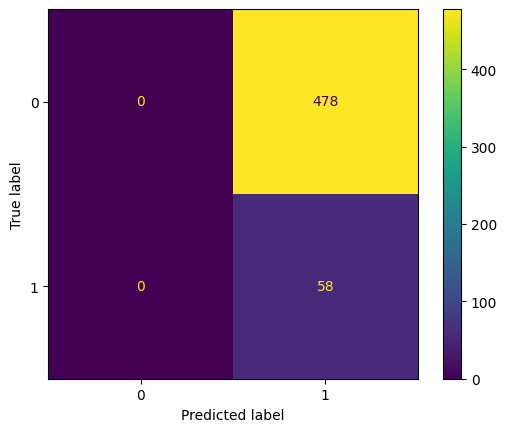

In [ ]:
# Calculate the confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

cm = confusion_matrix(y_true_all, y_pred_all)

disp = ConfusionMatrixDisplay(confusion_matrix=cm)

disp.plot()
plt.show()

##ConvLSTM

In [ ]:
import sys, os
sys.path.append('/content/drive/Shareddrives/thesis/models/downloads')

In [ ]:
batch_size = 4
train_dataset = ClipDataset(train=True, clips=True, source='YOLO', lstm_format=True)
test_dataset = ClipDataset(train=False, clips=True, source='YOLO', lstm_format=True)
train_dataloader = DataLoader(dataset=train_dataset, batch_size=batch_size, num_workers=4)
test_dataloader = DataLoader(dataset=test_dataset, batch_size=batch_size, num_workers=4)

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


In [ ]:
image, label = train_dataset[0]
print(image.shape)
print(label.shape)
print(len(train_dataloader))
train_iter = iter(train_dataloader)
images, labels = next(train_iter)
print(images.shape)
print(labels.shape)

torch.Size([90, 3, 240, 320])
torch.Size([1])
536
torch.Size([4, 90, 3, 240, 320])
torch.Size([4, 1])


In [ ]:
from convlstm import ConvLSTM

input_dim = 3
num_layers = 5
hidden_dim = 5*[64]
kernel_size = 5*[2]
model = ConvLSTM(input_dim, hidden_dim, kernel_size, num_layers, batch_first=True)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

n_epochs = 10
n_samples = len(train_dataset)
n_iterations = ceil(n_samples / batch_size)

#input_dim = (90, 3, 240, 320)
criterion = nn.BCELoss()
optimizer = torch.optim.Adam(model.parameters(), lr = 0.0001)

model = model.to(device)

# Load a previously saved checkpoint (if resuming)
checkpoint_path = '/content/drive/Shareddrives/thesis/models/checkpoints/first_convlstm_checkpoint.pth'
!mkdir -p /content/drive/Shareddrives/thesis/models/checkpoints
start_epoch = 0
start_batch = 0

try:
    checkpoint = torch.load(checkpoint_path)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    start_epoch = checkpoint['epoch']
    start_batch = checkpoint['batch']
    print(f"Resuming training from epoch {start_epoch}, batch {start_batch}")
except FileNotFoundError:
    print("Starting training from scratch.")

# clips_without_frames = set()
# clips_without_frames.add

# Training loop
for epoch in range(start_epoch, n_epochs):
  for i, (inputs, labels) in enumerate(train_dataloader):
    if epoch == start_epoch and i < start_batch:
      print(f"skipping batch {i}")
      continue

    inputs = inputs.to(device)
    labels = labels.to(device)
    preds = model(inputs)

    # calculate loss
    optimizer.zero_grad()
    loss = criterion(preds, labels)

    print(f"epoch {epoch + 1}/{n_epochs}, batch {i + 1}/{n_iterations}, loss={loss.item()}")

    #update weights
    loss.backward()
    optimizer.step()

    # Save a checkpoint every 32 batches
    if (i + 1) % 32 == 0:
      print(f"saving model at batch {i}, epoch {epoch}")
      torch.save({
          'epoch': epoch,
          'batch': i + 1,
          'model_state_dict': model.state_dict(),
          'optimizer_state_dict': optimizer.state_dict(),
      }, checkpoint_path)

  #save after epoch
  print(f"saving model after epoch {epoch}")
  torch.save({
            'epoch': epoch + 1,
            'batch': 0,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
        }, checkpoint_path)